****1st****

run this one


genome, data = genebank(genebank_file_path)                 
table, aminocodonlist = humantable(humantable_file_path)
proteins = formallmut(aminocodonlist, genome, table)
postablelist = formallmut2(proteins)

In [ ]:
#install libs
!pip install pandas
!pip install matplotlib
!pip install seaborn
!pip install minepy
!pip install scikit-learn

In [ ]:
#download the latest our world in data csv file
!wget -O owid-covid-data.csv https://covid.ourworldindata.org/data/owid-covid-data.csv

In [1]:
#import the libs
import numpy as np
import pooch
import matplotlib.pyplot as plt
from scipy.datasets import electrocardiogram
from scipy.signal import find_peaks
import os
import sys
import re
import time
import signal
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from multiprocessing import Pool, Process, Manager
import copy
import requests
import datetime
import json

In [ ]:
#for plain python scripts
genebank_file_path = '/work/MN908947.3/MN908947.3.gb'
#!wget ftp://ftp.ncbi.nlm.nih.gov/entrez/misc/data/gc.prt
humantable_file_path = '/work/new 30/gc.prt'
allmeta_file_path = '/work/2022.12.15/all_metadata.txt'
iso_file_path = '/work/new 30/country name to iso.csv'
fasta_file_Path = '/work/2022.12.15/fasta/'
merged_file_path = '/work/2022.12.15/fasta/allmerged.csv'
owid_file_path = 'owid-covid-data.csv'

In [2]:
#for jupyter notebook
time_begin_all = time.time()
genebank_file_path = '/work/2022.12.15/MN908947.3.gb'
#!wget ftp://ftp.ncbi.nlm.nih.gov/entrez/misc/data/gc.prt
humantable_file_path = '/work/2022.12.15/gc.prt'
allmeta_file_path = '/work/2023.05.27/all_metadata.txt'
iso_file_path = '/work/2022.12.15/country name to iso.csv'
fasta_file_Path = '/work/2023.05.27/fasta/'
merged_file_path = '/work/2023.05.27/fasta/allmerged.csv'
owid_file_path = '/work/2023.05.27/owid-covid-data.csv'

required_folders = ['represent',
                    'plot-data',
                    'plot-data2',
                    'country_json',
                    'owidtmpfile',
                    'tmp',
                    'mut-date-dataframe',
                    'readableinputcsv',
                    'owidshrink',
                    'voc_caller',
                    'len']

data_update_date = '2023-05-20'


six_country = ['USA','GBR','IND','BRA','ZAF','RUS']
colordict = {'USA':'r','IND':'dodgerblue','BRA':'fuchsia','ZAF':'darkorange','RUS':'gold','GBR':'orangered'}


abbreviationdict = {
    'DRC':'Congo (the Democratic Republic of the)',
    'South Korea':'Korea (the Republic of)',
    'Saint Martin':'Saint Martin (French part)',
    'Northern Mariana Islands':'Northern Mariana Islands (the)',
    'USA':'United States of America (the)',
    'Bahamas':'Bahamas (the)',
    'Sudan':'Sudan (the)',
    'Taiwan':'Taiwan (Province of China)',
    'Palestine':'"Palestine',
    'Faroe Islands':'Faroe Islands (the)',
    'Sudan':'Sudan (the)',
    'Netherlands':'Netherlands (the)',
    'Czech Republic':'Czechia',
    'Russia':'Russian Federation (the)'
}

fixingdict = {
    'Chongqing':'China',
    'Andorre':'Andorra',
    'SouthAfrica':'South Africa',
    'Yichun':'China',
    'Qingdao':'China',
    'Wuhan':'China',
    'Jian':'China', 
    'Shandong':'China',
    'Jingzhou':'China',
    "Lu'an":'China',
    'Shulan':'China',
    'Henan':'China',
    'Gansu':'China',
    'Hunan':'China',
    'Ganzhou':'China',
    'Zhejiang':'China',
    'Liaoning':'China',
    'Pingxiang':'China',
    'Fujian':'China',
    'Shanghai':'China',
    'Fuzhou':'China',
    'Tianmen':'China',
    'Foshan':'China',
    'Nan Chang':'China',
    'Jining':'China',
    'Shaoxing':'China',
    'Jiangxi':'China',
    'Heilongjiang':'China',
    'Yingtan':'China',
    'Beijing':'China',
    'Xinyu':'China',
    'Hangzhou':'China',
    'Anhui':'China',
    'Changzhou':'China',
    'Guangzhou':'China',
    'Shangrao':'China',
    'Lishui':'China',
    'Yunnan':'China',
    'Jiujiang':'China', 
    'Nanchang':'China',
    'MexicoMEX':'Mexico',
    'Guangdong':'China',
    'Sichuan':'China',
    'Shenzhen':'China',
    'Hebei':'China',
    'Jiangsu':'China',
    'Taiwan':'Taiwan (Province of China)',
    ' USA':'United States of America (the)',
    'United States':'United States of America (the)',
    'USA':'United States of America (the)',
    'Russia':'Russian Federation (the)',
    'Bahamas':'Bahamas (the)',
    'blegium':'Belgium',
    'Bolivia':'Bolivia (Plurinational State of)',
    'Bosnia And Herzegovina':'Bosnia and Herzegovina',
    'British Virgin Islands':'Virgin Islands (British)',
    'Czech Repubic':'Czechia',
    'Czech Republic':'Czechia',
    'Iran':'Iran (Islamic Republic of)',
    'Israel;':'Israel',
    'Netherlands':'Netherlands (the)',
    'Netherlans':'Netherlands (the)',
    'The Netherlands':'Netherlands (the)',
    'Laos':"Lao People's Democratic Republic (the)",
    'Philippines':'Philippines (the)',
    'Vietnam':'Viet Nam',
    'South Korea':'Korea (the Republic of)',
    'Democratic Republic Of Congo':'Congo (the Democratic Republic of the)',
    'Democratic Republic Of The Congo':'Congo (the Democratic Republic of the)',
    'Northern Ireland':'United Kingdom of Great Britain and Northern Ireland (the)',
    'England':'United Kingdom of Great Britain and Northern Ireland (the)',
    'Scotland':'United Kingdom of Great Britain and Northern Ireland (the)',
    'Wales':'United Kingdom of Great Britain and Northern Ireland (the)',
    'United Kingdom':'United Kingdom of Great Britain and Northern Ireland (the)'
}


In [228]:
len(metadict)

15652078

In [4]:
Alias = {'Alpha':['B.1.1.7'],
         'Beta':['B.1.351'],
         'Gamma':['P.1', 'B.1.1.28.1'],
         'Delta':['B.1.617.2', 'AY'],
         'Omicron':['B.1.1.529', 'BA.1'],
         'BA.2':['BA.2', 'B.1.1.529.2'],
         'BA.4':['BA.4', 'B.1.1.529.4'],
         'BA.2.12.1':['BA.2.12.1', 'B.1.1.529.2.12.1'],
         'BA.5':['BA.5', 'B.1.1.529.5'],
         'BA.2.75':['BA.2.75', 'B.1.1.529.2.75'],
         'BQ.1':['B.1.1.529.5.3.1.1.1.1.1'],
         'BQ.1.1':['B.1.1.529.5.3.1.1.1.1.1.1'],
         'XBB.1':['XBB.1'],
         'XBB.1.5':['XBB.1.5'],
         'XBB.1.16':['XBB.1.16'],
         'XBB.1.9.1':['XBB.1.9.1']
        }


vocdict = {"Alpha":"EPI_ISL_7976096",
           "Beta":"EPI_ISL_5315876",
           "Delta":"EPI_ISL_2723566",
           "Gamma":"EPI_ISL_1519355",
           "Omicron":"EPI_ISL_7860184",
           "BA.2":"EPI_ISL_8002589",
           "BA.2.12.1":"EPI_ISL_11999085",
           "BA.4":"EPI_ISL_12293081",
           "BA.5":"EPI_ISL_12839026",
           "BA.2.75":"EPI_ISL_15362552",
           "BQ.1":"EPI_ISL_15330928",
           "BQ.1.1":"EPI_ISL_15009072",
           "XBB.1":"EPI_ISL_14917652",
           "XBB.1.5":"EPI_ISL_15687648",
           "XBB.1.16":"EPI_ISL_17262430",
           "XBB.1.9.1":"EPI_ISL_16093023"}

vocorder = ["Alpha",
            "Beta",
            "Delta",
            "Gamma",
            "Omicron",
            "BA.2",
            "BA.2.12.1",
            "BA.4",
            "BA.5",
            "BA.2.75",
            "BQ.1",
            "BQ.1.1",
            "XBB.1",
            "XBB.1.5",
            "XBB.1.16",
            "XBB.1.9.1"]

vocplate = {'Alpha':'palegreen',
            'Beta':'aquamarine',
            'Delta':'dodgerblue',
            'Gamma':'darkorange',
            'Omicron':'darkblue',
            'BA.2':'sienna',
            'BA.2.12.1':'orangered',
            "BA.2.75":'forestgreen',
            'BA.4':'yellow',
            'BA.5':'hotpink',
            'BQ.1':'lime',
            'BQ.1.1':'peachpuff',
            'XBB.1':'skyblue',
            'XBB.1.5':'mediumpurple',
            'XBB.1.16':'darkkhaki',
            'XBB.1.9.1':'black'}

platevoc = {v: k for k, v in vocplate.items()}

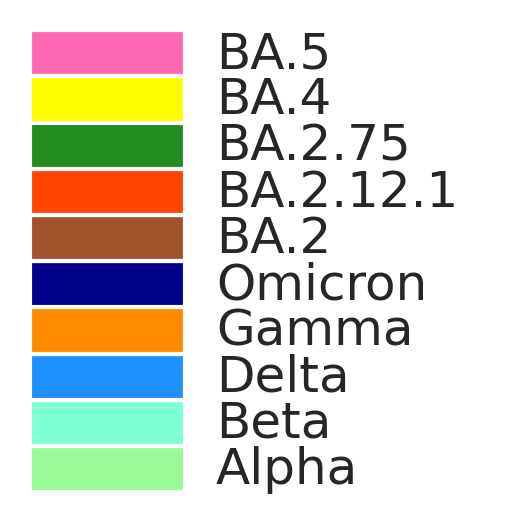

In [189]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def plot_colors(dictionary, size1, size2):
    fig, ax = plt.subplots(1, 1, figsize=(size1, size2))

    for i, (key, color) in enumerate(dictionary.items()):
        rect = patches.Rectangle((0, i), 1, 1, facecolor=color)
        ax.add_patch(rect)
        ax.text(1.2, i + 0.5, key, va='center', ha='left', fontsize=12)

    ax.set_xlim(0, 3)
    ax.set_ylim(0, len(dictionary))
    ax.axis('off')
    plt.show()

# 使用你的颜色字典测试
plot_colors(vocplate,2,2)


In [ ]:
vocplatebackup = {
            'Epsilon':'plum',
            'Zeta':'lightcoral',
            'Eta':'peru',
            'Theta':'mediumorchid',
            'Iota':'springgreen',
            'Kappa':'gold',
            'Lambda':'slateblue',
            'Mu':'olive',
            'Nu':'mediumturquoise',
            'Xi':'khaki',
            'Omicron':'darkkhaki',
            'Pi':'mediumpurple',
            'Rho':'lightseagreen',
            'Sigma':'goldenrod',
            'Tau':'darkseagreen',
            'Upsilon':'lightsalmon',
            'Phi':'palevioletred',
            'Chi':'steelblue',
            'Psi':'peachpuff',
            'Omega':'darkgray',
            'Variant 1':'cornflowerblue',
            'Variant 2':'teal',
            'Variant 3':'firebrick',
            'Variant 4':'powderblue',
            'Variant 5':'rosybrown'
}
plot_colors(vocplatebackup,2,5)

In [18]:
def index_a(a,b,c):
    #index_a is a function
	if b>=0:
		init_num = 0
		for i,j in enumerate(a):
			if j==c:
				init_num += 1
				if init_num == b:
					return i
	return -1

def mkdir(path): 
    folder = os.path.exists(path)
    if not folder:
        os.makedirs(path)
        print('create folder: ' + path)
    else:
        print(path + ' exists')

def unicfinder(order, corresponding, sampleinfo):
    knownmut = set()
    unique = {}
    for what in order:
        unique[what] = set()
        for muts in sampleinfo[corresponding[what]]:
            if muts not in knownmut:
                unique[what].add(muts)
                knownmut.add(muts)
    return unique

def conversion_readable(themut):
    global table, data
    themutsplit = themut.split('.')
    theprotein = themutsplit[0]
    theposition = int(themutsplit[1])
    thecondon = themutsplit[2]
    
    if theposition - 1 == len(data[theprotein]['aminoseq']):
        oldamino = '*'
    else:
        oldamino = data[theprotein]['aminoseq'][theposition - 1]
    newamino = table[thecondon]
    
    readablename = theprotein + '-' + oldamino + str(theposition) + newamino
    return readablename

def timer_server(time_begin, title):
    #time_begin = time.time()
    time_end = time.time()
    used = str(time_end - time_begin)
    used = str(time_end - time_begin)[:index_a(used, 1, '.') + 4] + 's'
    theurl = "https://sctapi.ftqq.com/YOURAPI.send?title="+ title + "&desp=Finally, "
    finalurl = theurl + used
    print('Done.')
    r = requests.post(url=finalurl)
    
def timer_server_B(time_begin, title):
    time_end = time.time()
    used = str(time_end - time_begin)
    used = str(time_end - time_begin)[:index_a(used, 1, '.') + 4] + 's'
    theurl = "https://sctapi.ftqq.com/YOURAPI.send?title="+ title + "&desp=Finally, "
    finalurl = theurl + used
    print('Done.' + title + ' ' + used)
    
def dateadder(firstdate, days):
    import time
    alist = []
    today = firstdate
    alist.append(firstdate)
    
    for i in range(days - 1):
        today = time.strftime('%Y-%m-%d', time.localtime(time.mktime(time.strptime(today, '%Y-%m-%d')) + 86400))
        alist.append(today)
    return alist

def datefiller(firstdate, lastdate):
    import time
    alist = []
    today = firstdate
    
    if time.mktime(time.strptime(firstdate, '%Y-%m-%d')) > time.mktime(time.strptime(lastdate, '%Y-%m-%d')):
        raise ValueError('The firstdate is later than the lastdate.')

    while time.mktime(time.strptime(today, '%Y-%m-%d')) <= time.mktime(time.strptime(lastdate, '%Y-%m-%d')):
        if today not in alist:
            alist.append(today)
        today = time.strftime('%Y-%m-%d', time.localtime(time.mktime(time.strptime(today, '%Y-%m-%d')) + 86400))

    return alist

#listsmoother is all about smoothing an accumulative column from owid data
#tmp1[['people_vaccinated']] = pd.DataFrame(listsmoother(tmp1['people_vaccinated'].values.tolist()))
#tmp1[['people_fully_vaccinated']] = pd.DataFrame(listsmoother(tmp1['people_fully_vaccinated'].values.tolist()))

def listsmoother(alist):
    newlist = []
    added = []
    leftflag = False
    gapflag = False
    final = np.nan
    for i in range(len(alist)):
        if type(alist[i]) == float and pd.isna(alist[i]) and leftflag:
            if not gapflag:
                gaplen = 1
                gapflag = True
            else:
                gaplen += 1
            if i == len(alist) - 1:
                #for x in range(gaplen):
                    #newlist.append(np.nan)
                #fake data
                for x in range(gaplen):
                    newlist.append(final*(1 + (x+1)/10000000))
        if not pd.isna(alist[i]):
            final = alist[i]
            leftflag = True
            if gapflag:
                righter = alist[i]
                share = (righter - lefter)// (gaplen + 1)
                for j in range(gaplen):
                    newlist.append(lefter + share*(j + 1))
                    added.append(lefter + share*(j + 1))
                newlist.append(righter)
                gapflag = False
                lefter = righter
            else:
                newlist.append(alist[i])
                lefter = alist[i]
        if not leftflag:
            newlist.append(alist[i])
    return newlist

oolist = [np.nan, np.nan, np.nan, 12.0, 9000.0, np.nan, np.nan, np.nan, np.nan, 10000.0, np.nan, 200000.0, np.nan, np.nan, np.nan]
print(oolist)
oo = listsmoother(oolist)
print(oo)

def dict_order(adict, Ascending= True):
    #Ascending by default
    import operator 
    final = []
    sorted_x = sorted(adict.items(), key=operator.itemgetter(1)) 
    for i in range(len(sorted_x)):
        final.append(sorted_x[i][0])
    if not Ascending:
        final = final[::-1]
    return final

def json_dump(thedata, filename):
    import json
    data_json_ = json.dumps(thedata)
    file = open(filename + '.json', 'w')
    file.write(data_json_)
    file.close()
    
def readaminomuttable(filepath):
    adict = {}
    thefile = open(filepath, 'r')
    for theline in thefile:
        if theline.startswith('基因'):
            indexlist = theline.strip().split(',')
            for i in range(2, len(indexlist) - 3):
                lineage = indexlist[i]
                adict[lineage] = []
        else:
            thelinelist = theline.strip().split(',')
            themutname = thelinelist[0] + '-' + thelinelist[1]
            for i in range(2, len(indexlist) - 3):
                if thelinelist[i] == '√':
                    adict[indexlist[i]].append(themutname)
    thefile.close()
    return adict

def middle_date(firstdate, lastdate):
    import time
    middle = int((time.mktime(time.strptime(firstdate, '%Y-%m-%d')) + time.mktime(time.strptime(lastdate, '%Y-%m-%d'))) / 2)
    return time.strftime('%Y-%m-%d', time.localtime(middle))

def genebank(gbkfile):
    #read the genebank file of MN908947.3
    #return the genome and the genome structure data, which is a dict
    data={}
    genes = []
    genome = ''
    aminoseq = ''
    join = 0
    ends = {}
    
    genomeflag = False
    newgeneflag = False
    aminoflag = False
    linenum = start = end = 0
    
    gbk = open(gbkfile, 'r')
    
    for line in gbk:
        linenum += 1
        if len(line) == 1:
            break
        if line.startswith('//'):
            genomeflag = False
            for thegene in genes:
                data[thegene]['gene'] = genome[data[thegene]['start'] - 1:data[thegene]['end']]
        
            
        if line[-2] == '"' and aminoflag:
            newgeneflag = False
            aminoflag = False
            aminoseq += line[:index_a(line, 1, '"')].strip()
            data[name]['aminoseq'] = aminoseq
            if start != 0:
                data[name]['start'] = start
                data[name]['end'] = end
            data[name]['join'] = join
            if len(ends) != 0:
                for key in ends:
                    data[name][key] = ends[key]
            ends = {}
            
        if genomeflag:
            genome += re.sub(r'[0-9]+', '', line.strip().replace(' ', ''))
        if newgeneflag:
            emm = line.strip()
            if emm.startswith('/gene='):
                name = line[index_a(line, 1, '"') + 1:index_a(line, 2, '"')]
                data[name] = {}
                genes.append(name)
            if aminoflag:
                aminoseq += line.strip()
                
                
        if line.startswith('ORIGIN'):
            genomeflag = True
            data[name]['aminoseq'] = aminoseq
            if start != 0:
                data[name]['start'] = start
                data[name]['end'] = end
            data[name]['join'] = join
            if len(ends) != 0:
                for key in ends:
                    data[name][key] = ends[key]
            ends = {}
        if line.strip().startswith('CDS '):
            newgeneflag = True
            REresult = re.search('\sjoin', line)
            if REresult:
                join = line.count(',')
                start = int(line[index_a(line, 1, '(') + 1:index_a(line, 1, '.')])
                end = int(line[index_a(line, line.count('.'), '.') + 1:index_a(line, 1, ')')])
                for i in range(join):
                    ends['start' + str(i)] = line[index_a(line, (i+1)*2, '.') + 1:index_a(line, i + 1, ',')]
                    ends['end' + str(i)] = line[index_a(line, i + 1, ',') + 1:index_a(line, (i+1)*2 + 1, '.')]
            else:
                join = 0
                start = int(line[index_a(line, 1, 'S')+1:index_a(line, 1, '.')].strip())
                end = int(line[index_a(line, 2, '.') + 1:])
        
        if line.strip().startswith('/translation='):
            aminoflag = True
            aminoseq = line[index_a(line, 1, '"') + 1:].strip()
            if line[-2] == '"':
                aminoseq = line[index_a(line, 1, '"') + 1:index_a(line, 2, '"')].strip()
                newgeneflag = False
                aminoflag = False
                
                
    gbk.close()
    return genome, data
    
def humantable(gcfile):
    #output human codon tables 
    table = {}
    aminocodonlist = {}
    nameflag = False

    #name = input("Which table do you want? (Standard)")
    name = 'Standard'

    Geneticcode = open(gcfile, 'r')
    for line in Geneticcode:
        if line.strip().startswith('},'):
            if nameflag:
                break
        if nameflag and line.strip().startswith('ncbieaa'):
            ncbieaa = line[index_a(line, 1, '"') + 1:index_a(line, 2, '"')]
        if nameflag and line.strip().startswith('sncbieaa'):
            sncbieaa = line[index_a(line, 1, '"') + 1:index_a(line, 2, '"')]
        if nameflag and line.strip().startswith('-- Base1'):
            Base1 = line[index_a(line, 1, '1') + 1:].strip().lower()
        if nameflag and line.strip().startswith('-- Base2'):
            Base2 = line[index_a(line, 1, '2') + 1:].strip().lower()
        if nameflag and line.strip().startswith('-- Base3'):
            Base3 = line[index_a(line, 1, '3') + 1:].strip().lower()
        if line.strip().startswith('name "' + name):
            nameflag = True

    Geneticcode.close()
    for i in range(len(ncbieaa)):
        table[Base1[i] + Base2[i] + Base3[i]] = ncbieaa[i]
        if ncbieaa[i] not in aminocodonlist:
            aminocodonlist[ncbieaa[i]] = []
        aminocodonlist[ncbieaa[i]].append(Base1[i] + Base2[i] + Base3[i])

    return table, aminocodonlist


def compare(a, b):
    #compare two codons and return a information dict about how they are diffrent
    diff = 0
    diffpos = []
    change = []
    for i in range(len(a)):
        if a[i] != b[i]:
            diff += 1
            diffpos.append(i)
            change.append(a[i] + '-' + b[i])
    return {'diff': diff, 'diffpos': diffpos, 'change': change}

def translation(proteins, args):
    aminocodonlist = args['aminocodonlist']
    genome = args['genome']
    table = args['table']
    key = args['key']
    start = args['start']
    end = args['end']
    flag = args['flag']
    for i in range(int((end + 1 - start)/3)):
        a = start - 1  + i * 3
        b = start - 1 + i * 3 + 3
        codononsite = genome[a:b]
        if key not in proteins:
            proteins[key] = {}
        for amino in aminocodonlist:
            if amino != table[codononsite]:
                if flag:
                    mutationname = table[codononsite] + str(i + 1) + amino
                else:
                    bstart = args['bstart']
                    bend = args['bend']
                    mutationname = table[codononsite] + str(i + 1 + int((bend + 1 - bstart)/3)) + amino
                proteins[key][mutationname] = {}
                for codon in aminocodonlist[amino]:
                    proteins[key][mutationname][codon] = compare(codononsite, codon)


def formallmut(aminocodonlist, genome, table):
    proteins = {}
    for key in data:
        args = {}
        args['aminocodonlist'] = aminocodonlist
        args['genome'] = genome
        args['table'] = table
        args['key'] = key
        join = data[key]['join']
        if join == 0:
            args['flag'] = True
    #        print(key)
            args['end'] = data[key]['end']
            args['start'] = data[key]['start']
            translation(proteins, args)
        else:
#abc        print(key)
            if join == 1:
                args['end'] = int(data[key]['end' + str(0)])
                args['start'] = int(data[key]['start'])
                args['flag'] = True
                translation(proteins, args)
                args['bstart'] = args['start']
                args['bend'] = args['end']
                args['start'] = int(data[key]['start' + str(0)])
                args['end'] = int(data[key]['end'])
                args['flag'] = False
                translation(proteins, args)
            else:
                for i in range(join):
                    if i == 0:
                        theend = 'end' + str(i)
                        thestart = 'start'
                        args['end'] = int(data[key][theend])
                        args['start'] = int(data[key][thestart])
                        translation(proteins, args)
                    if i == int(join - 1):
                        theend = 'end'
                        thestart = 'start' + str(i)
                        args['end'] = int(data[key][theend])
                        args['start'] = int(data[key][thestart])
                        translation(proteins, args)
                    if i != 0 and i != join - 1:
                        theend = 'end' + str(i)
                        thestart = 'start' + str(i)
                        if theend and thestart in data[key]:
                            args['end'] = int(data[key][theend])
                            args['start'] = int(data[key][thestart])
                            translation(proteins, args)
    return proteins


def formallmut2(proteins):
    postablelist = {}
    for protein in proteins:
        if protein not in postablelist:
            postablelist[protein] = {}
        for mut in proteins[protein]:
            pos = int(mut[1:-1])
            if pos not in postablelist[protein]:
                postablelist[protein][pos] = {}
            for abc in proteins[protein][mut]:
                postablelist[protein][pos][abc] = proteins[protein][mut][abc]
                postablelist[protein][pos][abc]['mutname'] = mut
    return postablelist

def tripletcompare(varinfo, genome, outfile):
    global data, postablelist
#    print('Yes.')
    for thegene in data:
#        print(thegene)
        if data[thegene]['join'] == 1:
            start1 = int(data[thegene]['start'])
            end1 = int(data[thegene]['end' + str(0)])
            start2 = int(data[thegene]['start' + str(0)])
            end2 = int(data[thegene]['end'])
            for i in range(int((end1 + 1 - start1)/3)):
                pos = i + 1
                abc = genome[start1 - 1 + i * 3: start1 - 1 + i * 3 + 3]
                if abc in postablelist[thegene][pos]:
                    item = thegene + ',' + str(pos) + ',' + abc + ',' + varinfo + '\n'
#                    print(item)
                    outfile.write(item)
                   
                    
            for i in range(int((end2 + 1 - start2)/3)):
                pos = i + 1 + int((end1 + 1 - start1)/3)
                abc = genome[start2 - 1 + i * 3: start2 - 1 + i * 3 + 3]
                if abc in postablelist[thegene][pos]:
                    item = thegene + ',' + str(pos) + ',' + abc + ',' + varinfo + '\n'
#                    print(item)
                    outfile.write(item)
                    
                    
        elif data[thegene]['join'] == 0:
            
            start = int(data[thegene]['start'])
            end = int(data[thegene]['end'])
            for i in range(int((end + 1 - start)/3)):
                pos = i + 1
                abc = genome[start - 1 + i * 3: start - 1 + i * 3 + 3]
                if abc in postablelist[thegene][pos]:
                    item = thegene + ',' + str(pos) + ',' + abc + ',' + varinfo + '\n'
                    outfile.write(item)
#                    print(item)
                


def handlefile(filename):
    global data, postablelist#data have all the information from MN908947.gb
    outfile = open(filename + '.csv', 'w')
    genome = ''
    for line in open(filename):
        if line.startswith('>'):
#            print(line)
            if genome != '':
                tripletcompare(varinfo, genome, outfile)

            genome = ''
            varinfo = line[1:].strip()
        else:
            genome += line.strip()
    tripletcompare(varinfo, genome, outfile)#for the last sequence
    outfile.close()
    print(filename)


def metareader(metadatafile):
    err = 0
    metadict = {}
    meta = open(metadatafile)
    for line in meta:
        if line.startswith('Virus_Strain_Name'):
            indexlist = line.strip().split('\t')
        else:
            linelist = line.strip().split('\t')
            accessionid = linelist[1]
            metadict[accessionid] = {}
            for what in indexlist:
                try:
                    metadict[accessionid][what] = linelist[indexlist.index(what)]
                except IndexError:
                    err += 1
    meta.close()
    return metadict, err

def readisotable(filename):
    dict1 = {}
    dict2 = {}
    openfile = open(filename, 'r')
    for line in openfile:
        if line.startswith('\ufeffEnglish'):
            flagg = True
            #print(line)
        else:
            linelist = line.split(',')
            shortname = linelist[0].strip()
            isocode = linelist[3].strip()
            dict1[shortname] = isocode
            dict2[isocode] = shortname
    openfile.close()
    return dict1, dict2

def countryhelper(countrynametoiso, isotocountryname, abbreviationdict, countryname):
    if countryname == 'United States':
        return 'USA'
    elif countryname == 'United Kingdom':
        return 'GBR'
    else:
        if countryname not in countrynametoiso:
            if countryname not in abbreviationdict:
                return False
            else:
                return countrynametoiso[abbreviationdict[countryname]]
        else:
            return countrynametoiso[countryname]

def set_default(obj):
    if isinstance(obj, set):
        return list(obj)
    raise TypeError

def write_json(data, filename):
    import json
    time_begin = time.time()
    datajson = json.dumps(data, default=set_default)
    file = open(filename, 'w')
    file.write(datajson)
    file.close()
    timer_server(time_begin, f"{filename} Done")

def datetostamp(time):
    return datetime.datetime.strptime(time, "%Y-%M-%d").timestamp()

def earlydate(date1, date2):
    year1, month1, day1 = int(date1[0:4]), int(date1[5:7]), int(date1[8:10])
    year2, month2, day2 = int(date2[0:4]), int(date2[5:7]), int(date2[8:10])
    
    if year1 < year2:
        return True
    elif year1 == year2:
        if month1 < month2:
            return True
        elif month1 == month2:
            if day1 < day2:
                return True
            else:
                return False
        else:
            return False
    else:
        return False

def formtimeseq(adict):
    #time seq is a list which has the strict chronological order
    timeseq = []
    tmp = []
    for what in adict:
        if len(what) == 10:
            if datetostamp(what) >= datetostamp('2019-10-22'):
                tmp.append(what)
    
    earliest = ''
    
    while len(tmp) != 0:
        for date in tmp:
            if earliest == '':
                earliest = date
            if earlydate(date, earliest):
                earliest = date
        timeseq.append(earliest)
        tmp.remove(earliest)
        earliest = ''
    return timeseq
    





def new_read_result(filename, fixingdict, countrynametoiso):
    global metadict
    new_id_mut_ = {}
    new_id_date_ = {}
    new_id_country_ = {}
    new_country_date_id_ = {}
    #new_unique_set_ = {}
    timeinfo = {}
    err = []
    err2 = set()
    err3 = set()
    for line in open(filename):
        try:
            linelist = line.strip().split(',')
            protein = linelist[0]
            pos = int(linelist[1])
            abc = linelist[2]
            mutid = protein + '.' + str(pos) + '.' + abc
            accessionid = linelist[3]
            
            try:
                country = metadict[accessionid]['Location_Country']
                collecttime = metadict[accessionid]['Sample_Collection_Date']
                updatetime = metadict[accessionid]['Create_Time']
                samplename = accessionid

            #country/region fixing
                if country in fixingdict:
                    country = fixingdict[country]
                if country not in countrynametoiso:
                    err3.add(country)
                if samplename not in new_id_mut_:
                    new_id_mut_[samplename] = set()
                    new_id_date_[samplename] = collecttime
                    new_id_country_[samplename] = country                
                new_id_mut_[samplename].add(mutid)
        
                if country not in new_country_date_id_:
                    new_country_date_id_[country] = {}
                if collecttime not in new_country_date_id_[country]:
                    new_country_date_id_[country][collecttime] = set()
                new_country_date_id_[country][collecttime].add(samplename)
            
                if collecttime not in timeinfo:
                    timeinfo[collecttime] = set()
                timeinfo[collecttime].add(samplename)
            except KeyError:
                err2.add(accessionid)
        except IndexError:
            err.append(line)
        
            
    return new_id_mut_, new_id_date_, new_id_country_, timeinfo, new_country_date_id_, err, err2, err3

#country_date_mut_['USA']['2020-04-01'] = {'S.614.ggt': 720 ... }

def nation_mutation(country_date_id_, id_mut_):
    country_date_mut_ = {}
    for thecountry in country_date_id_:
        if thecountry not in country_date_mut_:
            country_date_mut_[thecountry] = {}
        for thedate in country_date_id_[thecountry]:
            if thedate not in country_date_mut_[thecountry]:
                country_date_mut_[thecountry][thedate] = {}
            for theid in country_date_id_[thecountry][thedate]:
                for themut in id_mut_[theid]:
                    if themut not in country_date_mut_[thecountry][thedate]:
                        country_date_mut_[thecountry][thedate][themut] = 1
                    else:
                        country_date_mut_[thecountry][thedate][themut] += 1
    return country_date_mut_

#form a dict with sorted real world date that with data. It has gaps 
#country_timeseq_dict_['China'] = ['2019-10-22', '2020-01-01', '2020-01-11', '2020-01-13', '2020-01-16' ....

def form_timeseq_dict(country_date_mut_):
    country_timeseq_dict = {}
    for thecountry in country_date_mut_:
        if thecountry not in country_timeseq_dict:
            country_timeseq_dict[thecountry] = formtimeseq(country_date_mut_[thecountry])
    return country_timeseq_dict

#country_mut_sum_['USA']['S.614.ggt'] = 2584573

def nation_mut_sum(country_date_mut_):
    country_mut_sum_ = {}
    for thecountry in country_date_mut_:
        if thecountry not in country_mut_sum_:
            country_mut_sum_[thecountry] = {}
        for thedate in country_date_mut_[thecountry]:
            for themut in country_date_mut_[thecountry][thedate]:
                if themut not in country_mut_sum_[thecountry]:
                    country_mut_sum_[thecountry][themut] = country_date_mut_[thecountry][thedate][themut]
                else:
                    country_mut_sum_[thecountry][themut] += country_date_mut_[thecountry][thedate][themut]
    return country_mut_sum_

#check the countries' data, 'thres' is a mut's accumulative number

def national_glance(thecountry, country_mut_sum_, thres):
    #print(thecountry)
    temp = []
    aa = 0
    for what in country_mut_sum_[thecountry]:
        if country_mut_sum_[thecountry][what] >= thres:
            temp.append(what)
            aa += 1
    #print(aa)
    return temp

def nation_mutation_proportion(country_date_mut_, country_date_id_, country_timeseq_dict_):
    country_date_mut_proportion_ = {}
    for thecountry in country_date_mut_:
        if thecountry not in country_date_mut_proportion_:
            country_date_mut_proportion_[thecountry] = {}
        for thedate in country_timeseq_dict_[thecountry]:
            if thedate not in country_date_mut_proportion_[thecountry]:
                country_date_mut_proportion_[thecountry][thedate] = {}
            for themut in country_date_mut_[thecountry][thedate]:
                country_date_mut_proportion_[thecountry][thedate][themut] = country_date_mut_[thecountry][thedate][themut] / len(country_date_id_[thecountry][thedate])
    return country_date_mut_proportion_

def indexs(lst):
    #cut a number list into continuous parts
    indexlist = []
    from itertools import groupby
    fun = lambda x: x[1]-x[0]
    for k, g in groupby(enumerate(lst), fun):
        l1 = [j for i, j in g]
        indexlist.append(l1)
    return indexlist

def Smoother2(regiondict, jacent):
    #smoother, fill the gap between discontinuous dates
    import copy
    tmpdict = {}
    newdict = {}
    missingindex = []

    acopy = copy.deepcopy(regiondict)
#just clean up the regiondict.
    for thedate in regiondict:
        if len(regiondict[thedate]) == 0:
            del acopy[thedate]
        else:
            for themut in regiondict[thedate]:
                if regiondict[thedate][themut] <= 0:
                    del acopy[thedate][themut]
    bcopy = copy.deepcopy(acopy)
    for thedate in acopy:
        if len(acopy[thedate]) == 0:
            del bcopy[thedate]    
    regiondict = bcopy
    
    
    datelist = formtimeseq(list(regiondict))
    assumedatelist = datefiller(datelist[0], datelist[-1])
    
    for what in assumedatelist:
        if what not in datelist:
            missingindex.append(assumedatelist.index(what))

    for thedate in assumedatelist:
        tmpdict[thedate] = []
        if thedate in regiondict:
            tmpdict[thedate] = dict_order(regiondict[thedate], False)           
            
    missinggroup = indexs(missingindex)
    editabledict = copy.deepcopy(tmpdict)
    for thedate in assumedatelist:
        newdict[thedate] = ''
        if thedate in datelist:
            thefirst = editabledict[thedate][0]
            newdict[thedate] = thefirst
            editabledict[thedate].remove(thefirst)
    for thegroup in missinggroup:
        before_index = thegroup[0] - 1
        after_index = thegroup[-1] + 1
        length = len(thegroup)
        if length <= jacent:
            finishflag = False
            while finishflag == False:
                if len(thegroup) < 1:
                    finishflag = True

                if len(editabledict[assumedatelist[before_index]]) > 0 and len(thegroup) > 0:
                    thefirst = editabledict[assumedatelist[before_index]][0]
                    thisdayidx = thegroup[0]
                    newdict[assumedatelist[thisdayidx]] = thefirst
                    editabledict[assumedatelist[before_index]].remove(thefirst)
                    del thegroup[0]

                if len(editabledict[assumedatelist[after_index]]) > 0 and len(thegroup) > 0:
                    thefirst = editabledict[assumedatelist[after_index]][0]
                    thisdayidx = thegroup[-1]
                    newdict[assumedatelist[thisdayidx]] = thefirst
                    editabledict[assumedatelist[after_index]].remove(thefirst)
                    del thegroup[-1]

                else:
                    finishflag = True
        else:
            finishflag = False
            beforeflag = afterflag = True
            beforecount = aftercount = 0
            while finishflag == False:
                if len(thegroup) < 1:
                    finishflag = True
                if beforecount == jacent:
                    beforeflag = False
                if aftercount == jacent:
                    afterflag = False

                if len(editabledict[assumedatelist[before_index]]) > 0 and len(thegroup) > 0 and beforeflag == True:
                    thefirst = editabledict[assumedatelist[before_index]][0]
                    thisdayidx = thegroup[0]
                    newdict[assumedatelist[thisdayidx]] = thefirst
                    editabledict[assumedatelist[before_index]].remove(thefirst)
                    del thegroup[0]
                    beforecount += 1
                if len(editabledict[assumedatelist[after_index]]) > 0 and len(thegroup) > 0 and afterflag == True:
                    thefirst = editabledict[assumedatelist[after_index]][0]
                    thisdayidx = thegroup[-1]
                    newdict[assumedatelist[thisdayidx]] = thefirst
                    editabledict[assumedatelist[after_index]].remove(thefirst)
                    del thegroup[-1]
                    aftercount += 1
                else:
                    finishflag = True
            
    return newdict

#crucial function, single thread
#we have datefiller in this one
def json_nation_mut_date(thecontry, date_mut_proportion_, country_timeseq_dict_, data_update_date):
    import json
    mut_date_ = {}
    time_begins = time.time()
    for thedate in date_mut_proportion_:
        for themut in date_mut_proportion_[thedate]:
            if themut not in mut_date_:
                mut_date_[themut] = {}
            mut_date_[themut][thedate] = date_mut_proportion_[thedate][themut]
            
    for themut in mut_date_:
        tmptimelist = formtimeseq(mut_date_[themut])
        tmptimefulllist = datefiller('2019-10-22', data_update_date)
        if len(tmptimefulllist) > len(tmptimelist):
            for thedate in tmptimefulllist:
                if thedate not in tmptimelist:
                    mut_date_[themut][thedate] = 0

    mut_date_json = json.dumps(mut_date_)
    file = open('country_json/' + thecontry + '_mut_date_.json', 'w')
    file.write(mut_date_json)
    file.close()
    timer_server(time_begins, thecontry + ' json_nation_mut_date Done')

#
def owidtmpfile(filename, isocode):
    infile = open(filename, 'r')
    outfile = open('owidtmpfile/' + isocode + 'owid.csv', 'w')
    
    for line in infile:
        if line.startswith('iso_code') or line.startswith(isocode):
            outfile.write(line)
    infile.close()
    outfile.close()
    tmp1 = pd.read_csv('owidtmpfile/' + isocode + 'owid.csv')
    tmp1[['people_vaccinated']] = pd.DataFrame(listsmoother(tmp1['people_vaccinated'].values.tolist()))
    tmp1[['people_fully_vaccinated']] = pd.DataFrame(listsmoother(tmp1['people_fully_vaccinated'].values.tolist()))
    tmp1[['total_boosters']] = pd.DataFrame(listsmoother(tmp1['total_boosters'].values.tolist()))
    tmp1.to_csv('owidtmpfile/' + isocode + 'tmp2owid.csv', index=False)
    print('Done.')

def extraiso(isocode):
    #input iso code, and I will read the file of this iso code. output a dict
    #key is a date, value is a dict of the line
    owiddatedict = {}
    infile = open('owidtmpfile/' + isocode + 'tmp2owid.csv', 'r')
    for line in infile:
        linelist = line.strip().split(',')
        if line.startswith('iso_code'):
            titlelist = linelist
        elif line.startswith(isocode):
            thedate = linelist[titlelist.index('date')]
            owiddatedict[thedate] = {}
            for what in titlelist:
                owiddatedict[thedate][what] = linelist[titlelist.index(what)]
    infile.close()
    return owiddatedict

#owidtmpfile(owid_file_path, 'IND')
#test = extraiso('IND')

#fix booster
def mergeinput3(owiddict, finalregiondict, isocode):
    dateseq = formtimeseq(finalregiondict)
    outfile = open('oo' + isocode + 'model2input.csv', 'w')
    outfile.write('date,mutation_dedimed,population_density,total_cases_per_million,new_cases_smoothed_per_million,people_vaccinated,people_fully_vaccinated,total_boosters,population\n')
    owidlist = ['population','population_density','total_cases_per_million','new_cases_smoothed_per_million','people_vaccinated','people_fully_vaccinated','total_boosters']
    for thedate in dateseq:
        if thedate in owiddict and len(finalregiondict[thedate]) != 0:
            names = {}
            for thekey in owidlist:
                if owiddict[thedate][thekey] == '':
                    names[thekey] = 0
                else:
                    names[thekey] = owiddict[thedate][thekey]
            themutname = finalregiondict[thedate]
            #for themutname in finalregiondict[thedate]:
            #    num = finalregiondict[thedate][themutname]
            outfile.write(thedate + ',' + str(dedim(themutname)) + ',' + str(names['population_density']) + ',' + str(names['total_cases_per_million']) + ',' + str(names['new_cases_smoothed_per_million']) + ',' + str(names['people_vaccinated']) + ',' + str(names['people_fully_vaccinated']) + ','+ str(names['total_boosters']) + ',' + str(names['population']) + '\n')
            #print(thedate + ',' + str(dedim(themutname)) + ',' + str(names['population_density']) + ',' + str(names['total_cases_per_million']) + ',' + str(names['new_cases_smoothed_per_million']) + ',' + str(names['people_vaccinated']) + ',' + str(names['people_fully_vaccinated']) + ',' + str(names['population']) + '\n')

    outfile.close()
    
    
def slope_output(mut, mut_df):
    mut_df['slope'] = mut_df['rate'].rolling(5,min_periods=5).apply(np_slope,raw=False)
    mut_df = mut_df.rename(columns={'slope':mut})
    mut_df = mut_df[[mut]]
    return mut_df

def slope_output_1(mut, mut_df):
    mut_df['slope'] = mut_df['rate'].rolling(5,min_periods=5).apply(np_slope,raw=False)
    mut_df = mut_df.rename(columns={'slope':mut})
    mut_df = mut_df[['date', mut]]
    return mut_df

def select_mut_slope(selectedmutlist, _mut_date_, day):
    for mut in selectedmutlist:
        mut_df = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
        mut_df = mut_df.reset_index().rename(columns = {'index':'date'})
        mut_df.date = pd.to_datetime(mut_df.date)
        mut_df['rate'] = mut_df['rate'].rolling(day).mean()
        
        if selectedmutlist.index(mut) == 0:
            final_slope_df = slope_output_1(mut, mut_df)
        else:
            final_slope_df = pd.concat([final_slope_df, slope_output(mut, mut_df)], axis = 1, sort = False)
    return final_slope_df

def np_slope(data):
    return np.polyfit(data.index.values,data.values,1)[0]
def slope_glance_1(mut, _mut_date_, day):
    #print(mut)
    test_dfb = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
    test_dfb.date = pd.to_datetime(test_dfb.date)
    test_dfb['rate'] = test_dfb['rate'].rolling(day).mean()
    test_dfb['slope_5'] = test_dfb['rate'].rolling(5,min_periods=5).apply(np_slope,raw=False) 
    
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    sns.set(rc={'figure.figsize':(30,5)})
    # Plot the responses for different events and regions
    sns.lineplot(x="date", y="slope_5",data=test_dfb)
def slope_csv_reader(file):
    adict = {}
    thefile = open(file, 'r')
    for line in thefile:
        if line.startswith('date'):
            indexlist = line.strip().split(',')
        else:
            linelist = line.strip().split(',')
            thedate = linelist[0]
            adict[thedate] = {}
            for i in range(1, len(linelist)):
                if len(linelist[i]) > 0:
                    thefloat = float(linelist[i])
                    if thefloat > 0:
                        themut = indexlist[i]
                        adict[thedate][themut] = thefloat
    thefile.close()
    return adict

#test = slope_csv_reader('slope_df3.csv')

def dedim(mutname):
    #input the mutid, output the site/29903
    global data
    genomelength = 29903
    themutinfo = mutname.split('.')
    theprotein = themutinfo[0]
    aminosite = int(themutinfo[1])
    
    if theprotein == 'orf1ab' and aminosite > 4401:
        thesite = (aminosite - 1) * 3 + data[theprotein]['start'] -1
    else:
        thesite = (aminosite - 1) * 3 + data[theprotein]['start']
    dedimed = thesite/genomelength
    return dedimed

def final_output_thread(countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, thefile):
    thecountry = thefile.split('_')[0]
    theiso = countryhelper(countrynametoiso, isotocountryname, abbreviationdict, thecountry)
    with open('country_json/' + thefile, 'r', encoding = 'UTF-8') as thejson:
        thecountry_mut_date_ = json.load(thejson)
    mutlist = national_glance(thecountry, country_mut_sum_, thresholddict[thecountry])
    slope_df = select_mut_slope(mutlist, thecountry_mut_date_, 15)
    slope_df = slope_df.rename(columns= slope_df['date'])
    slope_df.index = slope_df['date']
    slope_df = slope_df.drop(columns=['date'])
    slope_df.to_csv('tmp/' + thecountry + '.slope_df.csv')
    the_slope_df = Smoother2(slope_csv_reader('tmp/' + thecountry + '.slope_df.csv'), 5)
    mergeinput3(extraiso(theiso), the_slope_df, theiso)
    
#final_output_thread(countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, 'Latvia_mut_date_.json')
def select_mut_df(selectedmutlist, _mut_date_, day):
    for mut in selectedmutlist:
        if selectedmutlist.index(mut) == 0:
            final_df = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = [mut]).reindex(formtimeseq(_mut_date_[mut]))
            final_df = final_df.reset_index().rename(columns = {'index':'date'})
            final_df.date = pd.to_datetime(final_df.date)
            final_df[mut] = final_df[mut].rolling(day).mean()
        else:
            mut_df = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = [mut]).reindex(formtimeseq(_mut_date_[mut]))
            mut_df = mut_df.reset_index().rename(columns = {'index':'date'})
            mut_df.date = pd.to_datetime(mut_df.date)
            mut_df[mut] = mut_df[mut].rolling(day).mean()
        
            final_df = pd.concat([final_df,  mut_df[[mut]]], axis = 1, sort = False)
    return final_df


def mut_dataframe_output_thread(countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, thefile):
    thecountry = thefile.split('_')[0]
    theiso = countryhelper(countrynametoiso, isotocountryname, abbreviationdict, thecountry)
    with open('country_json/' + thefile, 'r', encoding = 'UTF-8') as thejson:
        thecountry_mut_date_ = json.load(thejson)
    if thecountry == 'USA':
        thecountry = 'United States of America (the)'
    elif thecountry == 'Russia':
        thecountry = 'Russian Federation (the)'
    mutlist = national_glance(thecountry, country_mut_sum_, thresholddict[thecountry])
    mut_df = select_mut_df(mutlist, thecountry_mut_date_, 15)
    mut_df = mut_df.rename(columns= mut_df['date'])
    mut_df.index = mut_df['date']
    mut_df = mut_df.drop(columns=['date'])
    mut_df = mut_df.fillna(0)
    mut_df.to_csv('mut-date-dataframe/' + thecountry + '.mut_df.csv')
    smoother_mut_df = Smoother2(slope_csv_reader('mut-date-dataframe/' + thecountry + '.mut_df.csv'), 5)

#mut_dataframe_output_thread(countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, 'Qatar_mut_date_.json')  

def dataframe_na_patch(csvfile):
    a = pd.read_csv(csvfile)
    a = a.fillna(0)
    a.to_csv(csvfile, index = 0)
    
def nonunicfinder(order, corresponding, sampleinfo):
    nonunic = {}
    for what in order:
        nonunic[what] = set()
        for muts in sampleinfo[corresponding[what]]:
            nonunic[what].add(muts)
    return nonunic


def mut_order(unic, vocorder):
    mut_order_ = []
    for thevoc in vocorder:
        for themut in unic[thevoc]:
            mut_order_.append(themut)
    return mut_order_


#mainly used    
def national_glance_temporal_v2(country_date_mut_proportion_, days, thres):
    time_begin = time.time()
    nation_mostprevalent_mutlist_ = {}
    for thecountry in country_date_mut_proportion_:
        if thecountry not in nation_mostprevalent_mutlist_:
            nation_mostprevalent_mutlist_[thecountry] = []
            datelist = formtimeseq(country_date_mut_proportion_[thecountry])
            tempdict = {}
            for thedate in datelist:
                for themut in country_date_mut_proportion_[thecountry][thedate]:
                    if country_date_mut_proportion_[thecountry][thedate][themut] >= thres:
                        if themut not in tempdict:
                            tempdict[themut] = 0
                        tempdict[themut] = tempdict[themut] + 1
            for themut in tempdict:
                if tempdict[themut] >= days:
                    nation_mostprevalent_mutlist_[thecountry].append(themut)
    timer_server(time_begin, 'nation_mostprevalent_mutlist_v2 Done')
    return nation_mostprevalent_mutlist_

def main_mut_csv(mutlist_for_pot, nation_mostprevalent_mutlist, countrylist):
    outfile = open('main_mut.csv', 'w')
    title = 'Mutation'
    for thecountry in countrylist:
        title = title + ',' + thecountry
    title = title + ', counts\n'
    outfile.write(title)
    for themut in mutlist_for_pot:
        counts = 0
        theline = conversion_readable(themut)
        for thecountry in countrylist:
            if themut in nation_mostprevalent_mutlist[thecountry]:
                itsok = 'Yes'
                counts += 1
            else:
                itsok = 'No'
            theline = theline + ',' + itsok
        theline = theline + ', '+ str(counts) + '\n'
        outfile.write(theline)
    outfile.close()
    
def save_plot_dataframe(raw_mut_date_dataframe_file, mut_order, iso):
    pd.DataFrame(pd.read_csv(raw_mut_date_dataframe_file, index_col = 'date'), columns = mut_order).fillna(0).to_csv('plot-data/' + iso + '.csv')
    
def save_plot_dataframe2(raw_mut_date_dataframe_file, mut_order, iso):
    pd.DataFrame(pd.read_csv(raw_mut_date_dataframe_file, index_col = 'date'), columns = mut_order).fillna(0).to_csv('plot-data2/' + iso + '.csv')

def mergeinput_readable(owiddict, finalregiondict, isocode):
    dateseq = formtimeseq(finalregiondict)
    outfile = open('readableinputcsv/' + isocode + 'modelinput.csv', 'w')
    outfile.write('date,mutation,mutation_readable,mutation_dedimed,population_density,total_cases_per_million,new_cases_smoothed_per_million,people_vaccinated,people_fully_vaccinated,population\n')
    owidlist = ['population','population_density','total_cases_per_million','new_cases_smoothed_per_million','people_vaccinated','people_fully_vaccinated']
    for thedate in dateseq:
        if thedate in owiddict and len(finalregiondict[thedate]) != 0:
            names = {}
            for thekey in owidlist:
                if owiddict[thedate][thekey] == '':
                    names[thekey] = 0
                else:
                    names[thekey] = owiddict[thedate][thekey]
            themutname = finalregiondict[thedate]
            thereadablename = conversion_readable(themutname)
            #for themutname in finalregiondict[thedate]:
            #    num = finalregiondict[thedate][themutname]
            outfile.write(thedate + ',' + themutname + ',' + thereadablename + ',' + str(dedim(themutname)) + ',' + str(names['population_density']) + ',' + str(names['total_cases_per_million']) + ',' + str(names['new_cases_smoothed_per_million']) + ',' + str(names['people_vaccinated']) + ',' + str(names['people_fully_vaccinated']) + ',' + str(names['population']) + '\n')
            #print(thedate + ',' + str(dedim(themutname)) + ',' + str(names['population_density']) + ',' + str(names['total_cases_per_million']) + ',' + str(names['new_cases_smoothed_per_million']) + ',' + str(names['people_vaccinated']) + ',' + str(names['people_fully_vaccinated']) + ',' + str(names['population']) + '\n')

    outfile.close()
    
def final_output_thread_readable(countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, thefile):
    thecountry = thefile.split('_')[0]
    theiso = countryhelper(countrynametoiso, isotocountryname, abbreviationdict, thecountry)
    with open('country_json/' + thefile, 'r', encoding = 'UTF-8') as thejson:
        thecountry_mut_date_ = json.load(thejson)
    mutlist = national_glance(thecountry, country_mut_sum_, thresholddict[thecountry])
    slope_df = select_mut_slope(mutlist, thecountry_mut_date_, 15)
    slope_df = slope_df.rename(columns= slope_df['date'])
    slope_df.index = slope_df['date']
    slope_df = slope_df.drop(columns=['date'])
    slope_df.to_csv('tmp/' + thecountry + '.slope_df.csv')
    the_slope_df = Smoother2(slope_csv_reader('tmp/' + thecountry + '.slope_df.csv'), 5)
    mergeinput_readable(extraiso(theiso), the_slope_df, theiso)
    
def shrink_owid(filepath, theowidfilepath):
    infile = open(theowidfilepath, 'r')
    theth = 0
    outdict = {}
    thefirstline = ''
    for line in infile:
        if theth == 0:
            thefirstline = line
        else:
            if line != '':
                theiso = line.split(',')[0]
                if theiso not in outdict:
                    outdict[theiso] = []
                outdict[theiso].append(line)
        theth += 1

    infile.close()
    for theiso in outdict:
        outfile = open(filepath + theiso + '.csv', 'w')
        outfile.write(thefirstline)
        for what in outdict[theiso]:
            outfile.write(what)
        outfile.close()
        
#new_country_date_id_
def merge_casenum_core(file, outfile, country_date_id_, enddate):
    former1st, former2st, former3st = str(0), str(0), str(0)
    theinfile = open(file, 'r')
    theoutfile = open(outfile, 'w')
    firstline = 'iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,total_tests,new_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,stringency_index,population,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million'
    indexlist = firstline.strip().split(',')
    for theline in theinfile:
        if theline.startswith('iso_code'):
            indexlist = theline.strip().split(',')
            theoutfile.write('theiso,thedate,sequenced,total_cases,new_cases,new_cases_smoothed,population_density,total_cases_per_million,new_cases_smoothed_per_million,people_vaccinated,people_fully_vaccinated,total_boosters,population\n')
        else:
            linelist = theline.strip().split(',')
            theiso, thedate, total_cases, new_cases, new_cases_smoothed, population_density, total_cases_per_million, new_cases_smoothed_per_million, people_vaccinated, people_fully_vaccinated, total_boosters, population = linelist[indexlist.index('iso_code')], str(linelist[indexlist.index('date')]), str(linelist[indexlist.index('total_cases')]),  str(linelist[indexlist.index('new_cases')]),str(linelist[indexlist.index('new_cases_smoothed')]),str(linelist[indexlist.index('population_density')]), str(linelist[indexlist.index('total_cases_per_million')]), str(linelist[indexlist.index('new_cases_smoothed_per_million')]), str(linelist[indexlist.index('people_vaccinated')]),str(linelist[indexlist.index('people_fully_vaccinated')]),str(linelist[indexlist.index('total_boosters')]),str(linelist[indexlist.index('population')])
            if thedate in country_date_id_:
                sequenced = str(len(country_date_id_[thedate]))
            else:
                sequenced = str(0)

            if people_vaccinated != '':
                former1st = people_vaccinated
            else:
                if former1st == str(0):
                    people_vaccinated = former1st
                else:
                    people_vaccinated = ''
                    
                    
            if people_fully_vaccinated != '':
                former2st = people_fully_vaccinated
            else:
                if former2st == str(0):
                    people_fully_vaccinated = former2st
                else:
                    people_fully_vaccinated = ''
  

            if total_boosters != '':
                former3st = total_boosters
            else:
                if former3st == str(0):
                    total_boosters = former3st
                else:
                    total_boosters = ''




            if earlydate(thedate,enddate):
                theoutfile.write(theiso + ',' + thedate + ',' + sequenced + ',' + total_cases + ',' + new_cases + ',' + new_cases_smoothed + ',' + population_density + ',' + total_cases_per_million + ',' + new_cases_smoothed_per_million + ',' + people_vaccinated + ',' + people_fully_vaccinated + ',' + total_boosters + ',' + population + '\n')
    theinfile.close()
    theoutfile.close()
    tmp1 = pd.read_csv(outfile)
    tmp1[['people_vaccinated']] = pd.DataFrame(listsmoother(tmp1['people_vaccinated'].values.tolist()))
    tmp1[['people_fully_vaccinated']] = pd.DataFrame(listsmoother(tmp1['people_fully_vaccinated'].values.tolist()))
    tmp1[['total_boosters']] = pd.DataFrame(listsmoother(tmp1['total_boosters'].values.tolist()))
    tmp1.to_csv(outfile, index = False)
    
    
#def merge_casenum(filePath = 'owidshrink/', isotocountryname = isotocountryname, new_country_date_id_ = new_country_date_id_, abbreviationdict = abbreviationdict, enddate = data_update_date):
def merge_casenum(filePath, isotocountryname, new_country_date_id_, abbreviationdict, enddate):

    owidlist = os.listdir(filePath)
    for what in owidlist:
        theiso = what.split('.')[0]
        thefilepath = filePath + what
        if theiso in isotocountryname:
            theshrinkfile = filePath + what
            thecountryname = isotocountryname[theiso]
            if thecountryname in new_country_date_id_:
                theiso = theiso
                thecountryname = thecountryname
                merge_casenum_core(thefilepath, thefilepath + 'modi.csv', new_country_date_id_[thecountryname], enddate)
            elif theiso in new_country_date_id_:
                thecountryname = theiso
                merge_casenum_core(thefilepath, thefilepath + 'modi.csv', new_country_date_id_[thecountryname], enddate)
            else:
                fullname = isotocountryname[theiso]
                for what in abbreviationdict:
                    if abbreviationdict[what] == fullname:
                        thecountryname = what
                        if thecountryname in new_country_date_id_:
                            theiso = theiso
                            thecountryname = thecountryname
                            merge_casenum_core(thefilepath, thefilepath + 'modi.csv', new_country_date_id_[thecountryname], enddate)
                
                    
            
#merge_casenum('owidshrink/', isotocountryname, new_country_date_id_, abbreviationdict, data_update_date)

def formlineagedict(metadict):
    lineagedict = {}
    err = set()
    for what in metadict:
        try:
            lineage = metadict[what]['Lineage']
        except:
            err.add(what)
            continue
        if lineage not in lineagedict:
            lineagedict[lineage] = set()
        lineagedict[lineage].add(what)
    return lineagedict, err

def global_lineage(metadict):
    
    time_begin = time.time()
    global_date_lineage_ = {}
    global_date_id_ = {}
    
    for theid in metadict:
        if len(metadict[theid]['Sample_Collection_Date']) == 10:
            thedate = metadict[theid]['Sample_Collection_Date']
            thelineage = metadict[theid]['Lineage']
            if thedate not in global_date_lineage_:
                global_date_lineage_[thedate] = {}
            if thelineage not in global_date_lineage_[thedate]:
                global_date_lineage_[thedate][thelineage] = 0
            global_date_lineage_[thedate][thelineage] += 1
            if thedate not in global_date_id_:
                global_date_id_[thedate] = set()
            global_date_id_[thedate].add(theid)
    timer_server(time_begin, 'global_lineage Done')
    return global_date_lineage_,  global_date_id_

def global_lineage_proportion(global_date_lineage_, global_date_id_):
    time_begin = time.time()
    global_lineage_proportion_ = {}
    for thedate in global_date_lineage_:
        global_lineage_proportion_[thedate] = {}
        for thelineage in global_date_lineage_[thedate]:
            global_lineage_proportion_[thedate][thelineage] = global_date_lineage_[thedate][thelineage] / len(global_date_id_[thedate])
    timer_server(time_begin, 'global_lineage_proportion Done')
    return global_lineage_proportion_

def global_lineage_date(global_lineage_proportion_, data_update_date):
    #import json
    time_begin = time.time()
    lineage_date_ = {}
    for thedate in global_lineage_proportion_:
        for thelineage in global_lineage_proportion_[thedate]:
            if thelineage not in lineage_date_:
                lineage_date_[thelineage] = {}
            lineage_date_[thelineage][thedate] = global_lineage_proportion_[thedate][thelineage]
    
    for thelineage in lineage_date_:
        tmptimelist = formtimeseq(lineage_date_[thelineage])
        tmptimefulllist = datefiller('2019-10-22', data_update_date)
        if len(tmptimefulllist) > len(tmptimelist):
            for thedate in tmptimefulllist:
                if thedate not in tmptimelist:
                    lineage_date_[thelineage][thedate] = 0
    timer_server(time_begin, 'global_lineage_date Done')
    return lineage_date_


#analysis covid within countries through metadata
def dis_global_lineage(metadict):
    
    time_begin = time.time()
    dis_global_date_lineage_ = {}
    dis_global_date_id_ = {}
    errset = set()
    for theid in metadict:
        if len(metadict[theid]['Sample_Collection_Date']) == 10:
            thecountry = metadict[theid]['Location_Country']
            theiso = countryhelper(countrynametoiso, isotocountryname, abbreviationdict, thecountry)
            if theiso:
                thedate = metadict[theid]['Sample_Collection_Date']
                thelineage = metadict[theid]['Lineage']
                
                if theiso not in dis_global_date_lineage_:
                    dis_global_date_lineage_[theiso] = {}
                if thedate not in dis_global_date_lineage_[theiso]:
                    dis_global_date_lineage_[theiso][thedate] = {}
                if thelineage not in dis_global_date_lineage_[theiso][thedate]:
                    dis_global_date_lineage_[theiso][thedate][thelineage] = 0
                dis_global_date_lineage_[theiso][thedate][thelineage] += 1
                if theiso not in dis_global_date_id_:
                    dis_global_date_id_[theiso] = {}
                if thedate not in dis_global_date_id_[theiso]:
                    dis_global_date_id_[theiso][thedate] = set()
                dis_global_date_id_[theiso][thedate].add(theid)
            else:
                errset.add(thecountry)
    timer_server(time_begin, 'dis_global_lineage Done')
    return dis_global_date_lineage_,  dis_global_date_id_, errset

def dis_global_lineage_proportion(dis_global_date_lineage_, dis_global_date_id_):
    time_begin = time.time()
    dis_global_lineage_proportion_ = {}
    for theiso in dis_global_date_lineage_:
        dis_global_lineage_proportion_[theiso] = {}
        for thedate in dis_global_date_lineage_[theiso]:
            dis_global_lineage_proportion_[theiso][thedate] = {}
            for thelineage in dis_global_date_lineage_[theiso][thedate]:
                dis_global_lineage_proportion_[theiso][thedate][thelineage] = dis_global_date_lineage_[theiso][thedate][thelineage] / len(dis_global_date_id_[theiso][thedate])
    timer_server(time_begin, 'global_lineage_proportion Done')
    return dis_global_lineage_proportion_

def dis_global_lineage_date(dis_global_lineage_proportion_, data_update_date):
    #import json
    time_begin = time.time()
    dis_lineage_date_ = {}
    for theiso in dis_global_lineage_proportion_:
        dis_lineage_date_[theiso] = {}
        for thedate in dis_global_lineage_proportion_[theiso]:
            for thelineage in dis_global_lineage_proportion_[theiso][thedate]:
                if thelineage not in dis_lineage_date_[theiso]:
                    dis_lineage_date_[theiso][thelineage] = {}
                dis_lineage_date_[theiso][thelineage][thedate] = dis_global_lineage_proportion_[theiso][thedate][thelineage]
    
    for theiso in dis_lineage_date_:
        for thelineage in dis_lineage_date_[theiso]:
            tmptimelist = formtimeseq(dis_lineage_date_[theiso][thelineage])
            tmptimefulllist = datefiller('2019-10-22', data_update_date)
            if len(tmptimefulllist) > len(tmptimelist):
                for thedate in tmptimefulllist:
                    if thedate not in tmptimelist:
                        dis_lineage_date_[theiso][thelineage][thedate] = 0
    timer_server(time_begin, 'dis_global_lineage_date Done')
    return dis_lineage_date_

def voc_dataframe(vocname, lineagelist, lineage_date_, day):
    count = 0
    test_dfa = pd.DataFrame()  # Initialize test_dfa
    for thealias in lineagelist:
        for allalias in lineage_date_:
            if allalias.startswith(thealias):
                if count == 0:
                    test_dfa = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
                    test_dfa.date = pd.to_datetime(test_dfa.date)
                    count += 1
                else:
                    test_dfb = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
                    test_dfb.date = pd.to_datetime(test_dfb.date)
                    count += 1
                    test_dfa['rate'] = test_dfa['rate'] + test_dfb['rate']
    test_dfa['rate'] = test_dfa['rate'].rolling(day).mean()
    test_dfa = test_dfa.rename(columns={'rate':vocname})
#    sns.lineplot(x="date", y="rate",data=test_dfa, label = vocname)
    return test_dfa.fillna(0)

def voc_dataframe(vocname, lineagelist, lineage_date_, day):
    count = 0
    test_dfa = pd.DataFrame()  # Initialize test_dfa
    for thealias in lineagelist:
        for allalias in lineage_date_:
            if allalias.startswith(thealias):
                if count == 0:
                    test_dfa = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
                    test_dfa.date = pd.to_datetime(test_dfa.date)
                    count += 1
                else:
                    test_dfb = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
                    test_dfb.date = pd.to_datetime(test_dfb.date)
                    count += 1
                    test_dfa['rate'] = test_dfa['rate'] + test_dfb['rate']
    if test_dfa.empty:
        test_dfa = pd.DataFrame.from_dict(lineage_date_['BA.1'], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_['BA.1']))
        test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
        test_dfa.date = pd.to_datetime(test_dfa.date)
        test_dfa['rate'] = 0
    else:
        test_dfa['rate'] = test_dfa['rate'].rolling(day).mean()
    test_dfa = test_dfa.rename(columns={'rate':vocname})
    return test_dfa.fillna(0)

def vocs_dataframe(Alias, lineage_date_, day):
    time_begin = time.time()
    count = 0
    for thevoc in Alias:
        if count == 0:
            df = voc_dataframe(thevoc, Alias[thevoc], lineage_date_, day)
            #print(df)
        else:
            #df[thevoc] = voc_dataframe(thevoc, Alias[thevoc], lineage_date_, day)[thevoc].to_list()
            ndf = voc_dataframe(thevoc, Alias[thevoc], lineage_date_, day)
            #df = pd.concat([df, ndf[thevoc]])
            df [thevoc] = ndf[thevoc]
        count += 1
    timer_server(time_begin, 'vocs_dataframe Done')
    return df

#testusa = vocs_dataframe(Alias, dis_lineage_date_['USA'], 15)

def suitable_thres(thecountry, country_mut_sum_, expect, a = 1, b = 10000):
    if b - a <= 5:
        return ((a + b) // 2)
    if len(national_glance(thecountry, country_mut_sum_, b)) < expect:
        return suitable_thres(thecountry, country_mut_sum_, expect, a, (a + b) // 2)
    else:
        return suitable_thres(thecountry, country_mut_sum_, expect, b, b * 2)




    
genome, data = genebank(genebank_file_path)
table, aminocodonlist = humantable(humantable_file_path)
proteins = formallmut(aminocodonlist, genome, table)
postablelist = formallmut2(proteins)
for thefolder in required_folders:
    mkdir(thefolder)
countrynametoiso, isotocountryname = readisotable(iso_file_path)

[nan, nan, nan, 12.0, 9000.0, nan, nan, nan, nan, 10000.0, nan, 200000.0, nan, nan, nan]
[nan, nan, nan, 12.0, 9000.0, 9200.0, 9400.0, 9600.0, 9800.0, 10000.0, 105000.0, 200000.0, 200000.02000000002, 200000.03999999998, 200000.06]
represent exists
plot-data exists
plot-data2 exists
country_json exists
owidtmpfile exists
tmp exists
mut-date-dataframe exists
readableinputcsv exists
owidshrink exists
voc_caller exists
len exists


In [162]:
from datetime import datetime, timedelta

def find_lineages_gpt(lineage_date_, threshold, days):
    exceeding_lineages = []
    for lineage, date_data in lineage_date_.items():
        # Sort dates
        sorted_dates = sorted(date_data.keys(), key=lambda x: datetime.strptime(x, "%Y-%m-%d"))

        count = 0
        for i in range(len(sorted_dates) - 1):
            # Check if dates are consecutive and the proportion exceeds the threshold
            if ((datetime.strptime(sorted_dates[i+1], "%Y-%m-%d") - datetime.strptime(sorted_dates[i], "%Y-%m-%d")).days == 1
                and date_data[sorted_dates[i]] > threshold):
                count += 1
            else:
                count = 0

            # If count equals to days, add the lineage to the list
            if count == days:
                exceeding_lineages.append(lineage)
                break

    return exceeding_lineages


exceeding_lineages = find_lineages_gpt(lineage_date_, 0.3, 3)

In [175]:
def find_lineages_by_countries_gpt(dis_lineage_date_, countries, threshold, days):
    exceeding_lineages = {country: [] for country in countries}
    for country in countries:
        if country in dis_lineage_date_:
            for lineage, date_data in dis_lineage_date_[country].items():
                # Sort dates
                sorted_dates = sorted(date_data.keys(), key=lambda x: datetime.strptime(x, "%Y-%m-%d"))

                count = 0
                for i in range(len(sorted_dates) - 1):
                    # Check if dates are consecutive and the proportion exceeds the threshold
                    if ((datetime.strptime(sorted_dates[i+1], "%Y-%m-%d") - datetime.strptime(sorted_dates[i], "%Y-%m-%d")).days == 1
                        and date_data[sorted_dates[i]] > threshold):
                        count += 1
                    else:
                        count = 0

                    # If count equals to days, add the lineage to the list
                    if count == days:
                        exceeding_lineages[country].append(lineage)
                        break
    
    for what in exceeding_lineages:
        print('lineages in ' + what + ' that exceeding ' + str(threshold) + ' in ' + str(days) + ' days')
        print(exceeding_lineages[what])
    return exceeding_lineages



In [163]:
len(exceeding_lineages)

10

In [164]:
print(exceeding_lineages)

['B.1', '', 'B.1.1.7', 'B', 'BA.1.1', 'BA.1', 'BA.2', 'B.1.617.2', 'XBB.1.5', 'BA.2.12.1']


In [177]:
exceeding_lineages_by_countries3 = find_lineages_by_countries_gpt(dis_lineage_date_, six_country, 0.3, 3)
exceeding_lineages_by_countries4 = find_lineages_by_countries_gpt(dis_lineage_date_, six_country, 0.4, 3)
exceeding_lineages_by_countries5 = find_lineages_by_countries_gpt(dis_lineage_date_, six_country, 0.5, 3)

lineages in USA that exceeding 0.3 in 3 days
['B.1', 'B.1.2', '', 'A', 'B.1.1.7', 'B.1.617.2', 'BA.1.1', 'A.1', 'BA.1', 'BA.2.12.1', 'XBB.1.5', 'BA.2']
lineages in GBR that exceeding 0.3 in 3 days
['AY.4', 'B.1.617.2', 'B.1', 'B.1.1', 'B.1.1.7', '', 'B.1.177', 'BA.1', 'BA.1.1', 'BA.2', 'B.40', 'XBB.1.5']
lineages in IND that exceeding 0.3 in 3 days
['B.1.617.2', '', 'B.1', 'B.1.617.1', 'B.1.1.306', 'B.1.1', 'B.1.36', 'B.6', 'B.1.36.29', 'BA.2', 'B.1.1.201', 'BA.2.38', 'XBB.1.16']
lineages in BRA that exceeding 0.3 in 3 days
['BA.1', 'AY.99.2', 'BA.1.1', 'P.1', '', 'B.1.1.28', 'P.2', 'B.1.1.33', 'B.1.1', 'BA.2', 'B.1', 'BA.5.1', 'BA.5.2.1', 'BE.9', 'BQ.1.1', 'DL.1', 'XBB.1.5', 'FE.1']
lineages in ZAF that exceeding 0.3 in 3 days
['B.1.617.2', 'B.1.351', 'AY.45', 'B.1', '', 'BA.1', 'BA.2', 'XBB.1.5', 'B.1.8', 'BA.4', 'XBB.1.5.25']
lineages in RUS that exceeding 0.3 in 3 days
['AY.122', 'B.1.617.2', 'BA.1.1', '', 'B.1.1', 'B.1', 'BA.5.2', 'B.1.1.7', 'Unassigned', 'BA.2', 'XBB.1.9.1']
line

In [168]:
unique_lineages_set = set(lineage for lineages in exceeding_lineages_by_countries.values() for lineage in lineages)

In [179]:
print(set(lineage for lineages in exceeding_lineages_by_countries3.values() for lineage in lineages))
print(len(set(lineage for lineages in exceeding_lineages_by_countries3.values() for lineage in lineages)))
print(set(lineage for lineages in exceeding_lineages_by_countries4.values() for lineage in lineages))
print(len(set(lineage for lineages in exceeding_lineages_by_countries4.values() for lineage in lineages)))
print(set(lineage for lineages in exceeding_lineages_by_countries5.values() for lineage in lineages))
print(len(set(lineage for lineages in exceeding_lineages_by_countries5.values() for lineage in lineages)))

{'', 'B.1.617.1', 'B.1.1.306', 'B.1.8', 'AY.4', 'XBB.1.16', 'DL.1', 'BA.2.12.1', 'B.6', 'XBB.1.5.25', 'Unassigned', 'BA.2', 'B.1', 'P.1', 'B.1.1.7', 'BA.1', 'AY.45', 'B.1.2', 'BA.2.38', 'BA.5.2.1', 'B.1.1.201', 'AY.122', 'BA.5.1', 'BE.9', 'B.1.1.28', 'B.1.36.29', 'XBB.1.5', 'B.1.617.2', 'B.1.351', 'B.40', 'BA.5.2', 'P.2', 'A.1', 'BA.1.1', 'B.1.177', 'FE.1', 'XBB.1.9.1', 'A', 'B.1.1', 'B.1.36', 'BA.4', 'B.1.1.33', 'AY.99.2', 'BQ.1.1'}
44
{'', 'B.1.1.306', 'AY.4', 'XBB.1.16', 'BA.2.12.1', 'B.6', 'Unassigned', 'BA.2', 'B.1', 'P.1', 'B.1.1.7', 'BA.1', 'AY.45', 'B.1.2', 'BA.2.38', 'BA.5.2.1', 'AY.122', 'BE.9', 'B.1.1.28', 'XBB.1.5', 'B.1.617.2', 'B.1.351', 'B.40', 'BA.5.2', 'P.2', 'BA.1.1', 'FE.1', 'XBB.1.9.1', 'A', 'B.1.36', 'B.1.1', 'B.1.1.33', 'AY.99.2', 'BQ.1.1'}
34
{'', 'B.1.1.306', 'AY.4', 'XBB.1.16', 'BA.2.12.1', 'Unassigned', 'BA.2', 'B.1', 'P.1', 'B.1.1.7', 'BA.1', 'AY.45', 'AY.122', 'BE.9', 'B.1.1.28', 'XBB.1.5', 'B.1.617.2', 'B.1.351', 'BA.5.2', 'P.2', 'BA.1.1', 'FE.1', 'XBB.1.9.

In [ ]:

#if you are running this jupyter notebook for the first time, you should run this
time_begin = time.time()

fasta_file_filelist = os.listdir(fasta_file_Path)
final_fasta_file_list = []

for name in fasta_file_filelist:
    if name.endswith('mafft.fasta'):
        final_fasta_file_list.append(name)

t = len(final_fasta_file_list)

p = Pool(t)

for name in final_fasta_file_list:
    p.apply_async(handlefile, args = (fasta_file_Path + name, ))
p.close()
p.join()
timer_server_B(time_begin, 'multi_csv_done')

print(os.system('cat ' + fasta_file_Path + '*.csv > ' + merged_file_path))



Done.
Done.
Done.
Done.
Done.
Done.
Done.
Alpha
{'S-T716I', 'S-P681H', 'S-S982A', 'S-N501Y', 'S-A570D', 'S-D614G', 'S-D1118H'}
Beta
{'S-D215G', 'S-K417N', 'S-E484K', 'S-L18F', 'S-D80A', 'S-A701V', 'S-N501Y', 'S-D614G'}
Delta
{'S-L452R', 'S-P681R', 'S-G142D', 'S-T478K', 'S-T95I', 'S-D950N', 'S-D614G', 'S-T19R'}
Gamma
{'S-E484K', 'S-L18F', 'S-D614G', 'S-P26S', 'S-N501Y', 'S-K417T', 'S-V1176F', 'S-D138Y', 'S-H655Y', 'S-T1027I', 'S-S1252F', 'S-T20N', 'S-R190S'}
Omicron
{'S-E484A', 'S-D796Y', 'S-N969K', 'S-T95I', 'S-L981F', 'S-H655Y', 'S-S373P', 'S-P681H', 'S-S477N', 'S-N501Y', 'S-N679K', 'S-N764K', 'S-G496S', 'S-Q493R', 'S-D614G', 'S-G339D', 'S-K417N', 'S-A67V', 'S-Q498R', 'S-T547K', 'S-G446S', 'S-Y505H', 'S-S371L', 'S-S375F', 'S-Q954H', 'S-T478K', 'S-N440K', 'S-N856K'}
BA.2
{'S-E484A', 'S-T19I', 'S-D796Y', 'S-G142D', 'S-N969K', 'S-H655Y', 'S-S373P', 'S-D405N', 'S-P681H', 'S-S477N', 'S-N501Y', 'S-N679K', 'S-N764K', 'S-Q493R', 'S-T376A', 'S-D614G', 'S-G339D', 'S-K417N', 'S-Q498R', 'S-R408S'

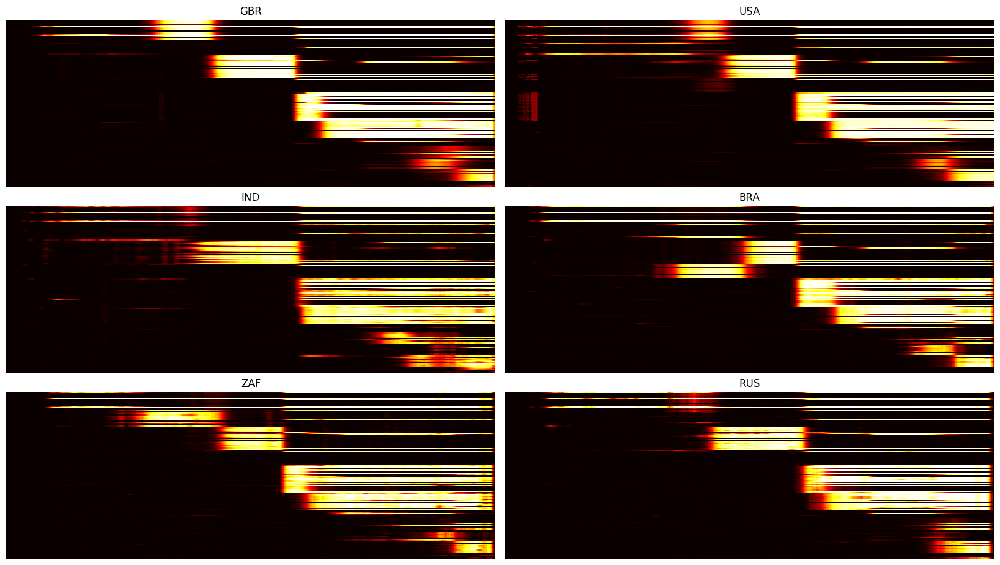

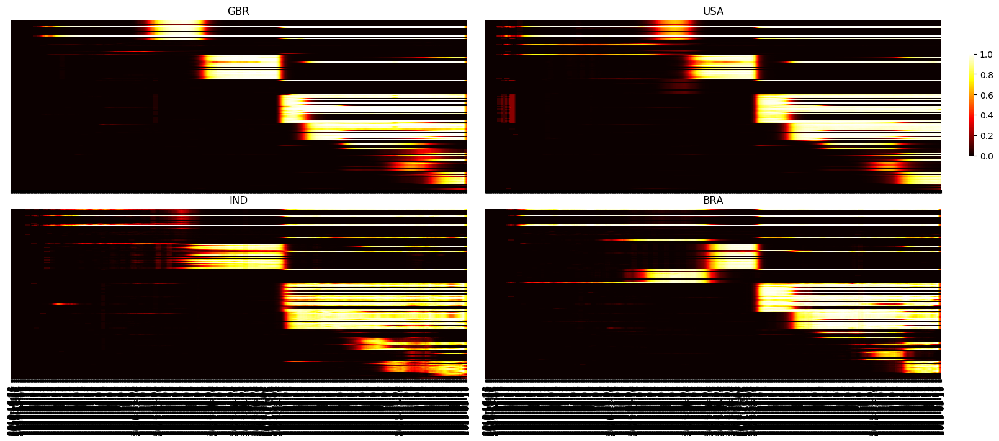

IndexError: list index out of range

In [7]:
time_begin = time.time()
metadict, errk = metareader(allmeta_file_path)
timer_server(time_begin, 'Metadata reading finished')

#3rd
#run this one
#aim to adapt the 3floor version

#perform test:
#sampleinfo[samplename]['muts'] = set()
#mutinfo[mutid] = set()
#336.530s
#form postableresout dict

time_begin = time.time()
new_id_mut_, new_id_date_, new_id_country_, timeinfo, new_country_date_id_, err, err2, err3 = new_read_result(merged_file_path,fixingdict, countrynametoiso)
unic = unicfinder(vocorder, vocdict, new_id_mut_)
timer_server(time_begin, 'new_read_result Done')
#timeseq = formtimeseq(timeinfo)
#print(earlydate('2019-04-25', '2020-03-26'))
#print(datetostamp('2019-10-22'))

write_json(new_id_mut_, 'new_id_mut_.json')
write_json(new_id_date_, 'new_id_date_.json')
write_json(new_id_country_, 'new_id_country_.json')
write_json(timeinfo, 'timeinfo.json')
write_json(new_country_date_id_, 'new_country_date_id_.json')

forwriting = {}
for thevoc in vocdict:
    forwriting[thevoc] = set()
    muttlistt = new_id_mut_[vocdict[thevoc]]
    for what in muttlistt:
        readmut = conversion_readable(what)
        if readmut.startswith('S'):
            forwriting[thevoc].add(readmut)
for what in forwriting:
    print(what)
    print(forwriting[what])
print('-------------------------------')
for what in unic:
    print(what)
    print(unic[what])
    
time_begin = time.time()
country_date_mut_ = nation_mutation(new_country_date_id_, new_id_mut_)
write_json(country_date_mut_, 'country_date_mut_.json')
timer_server(time_begin, 'country_date_mut_ all done')
time_begin = time.time()
country_timeseq_dict_ = form_timeseq_dict(country_date_mut_)
write_json(country_timeseq_dict_, 'country_timeseq_dict_.json')
timer_server(time_begin, 'country_timeseq_dict_ all done')
time_begin = time.time()
country_mut_sum_ = nation_mut_sum(country_date_mut_)
write_json(country_mut_sum_, 'country_mut_sum_.json')
timer_server(time_begin, 'country_mut_sum_ all done')

#country_date_mut_proportion_['China'] = {'2019-10-22': {'S.708.gct': 1.0, 'ORF8.87.gaa': 1.0 ......
#the crucial part is country_date_mut_proportion_[thecountry][thedate][themut] = country_date_mut_[thecountry][thedate][themut] / len(country_date_id_[thecountry][thedate])
time_begin = time.time()
country_date_mut_proportion_ = nation_mutation_proportion(country_date_mut_, new_country_date_id_, country_timeseq_dict_)
write_json(country_date_mut_proportion_, 'country_date_mut_proportion_.json')
timer_server(time_begin, 'country_date_mut_proportion_ all done')

#France = national_glance('France', country_mut_sum_, 100)
#for thecountry in country_mut_sum_:
#    national_glance(thecountry, country_mut_sum_, 1000)
#len(France)
countrynum = {}
for thecountry in country_date_mut_proportion_:
    countrynum[thecountry] = len(country_date_mut_proportion_[thecountry])
countryorder = sorted(countrynum.items(), key = lambda x: -x[1])
countryorderlist = []
for i in range(len(countryorder)):
    countryorderlist.append(countryorder[i][0])
print(countryorder[0:60])
print(suitable_thres('United States of America (the)', country_mut_sum_, 1000, a = 1, b = 10000))
thresholddict = {}
for what in countryorder[0:60]:
    thecountry = what[0]
    thresholddict[thecountry] = suitable_thres(thecountry, country_mut_sum_, 1000, a = 1, b = 10000)
print(thresholddict)

#Multi processing for the function json_nation_mut_date, if you have the previous result in country_json, then you don't need to run it again
#the first 60 countries

time_begin = time.time()

t = 60

p = Pool(t)

for i in range(60):
    thecountry = countryorderlist[i]
    p.apply_async(json_nation_mut_date, args = (thecountry, country_date_mut_proportion_[thecountry], country_timeseq_dict_,data_update_date, ))

p.close()
p.join()
timer_server(time_begin, 'Multi-json_nation_mut_date Done')

#WE NEED IT! THE owidtmpfile
for thecountry in countryorderlist:
    theiso = countryhelper(countrynametoiso, isotocountryname, abbreviationdict, thecountry)
    if theiso:
        try:
            owidtmpfile(owid_file_path, theiso)
        except:
            print(theiso,thecountry)



time_begin = time.time()

p = Pool(60)

    
filePath = './country_json/'
jsonlist = os.listdir(filePath)
for thefile in jsonlist:
    if thefile.endswith('.json'):
        p.apply_async(final_output_thread, args = (countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, thefile, ))
        
p.close()
p.join()
timer_server(time_begin, 'final_output_thread Done')

# country_mut_sum_, thresholddict, 'United States of America (the)_mut_date_.json')
#final_output_thread(countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, 'Russian Federation (the)_mut_date_.json')


time_begin = time.time()

p = Pool(60)

    
filePath = './country_json/'
jsonlist = os.listdir(filePath)
for thefile in jsonlist:
    if thefile.endswith('.json'):
        p.apply_async(mut_dataframe_output_thread, args = (countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, thefile, ))
        
p.close()
p.join()
timer_server(time_begin, 'final_ output_thread Done')

templist = os.listdir('mut-date-dataframe')
for what in templist:
    if what.endswith('.csv'):
        dataframe_na_patch('mut-date-dataframe/' + what)

nonuic = nonunicfinder(vocorder, vocdict, new_id_mut_)
mut_order_1 = mut_order(nonuic, vocorder)
mut_order_2 = mut_order(unic, vocorder)

nation_mostprevalent_mutlist_v2 = national_glance_temporal_v2(country_date_mut_proportion_, 5, 0.2)
nation_mostprevalent_mutlist_v2_2 = national_glance_temporal_v2(country_date_mut_proportion_, 2, 0.1)

mutlist_for_pot =  list(set(nation_mostprevalent_mutlist_v2['United States of America (the)'] +
nation_mostprevalent_mutlist_v2['Brazil'] +
nation_mostprevalent_mutlist_v2['India'] +
nation_mostprevalent_mutlist_v2['Russian Federation (the)'] +
nation_mostprevalent_mutlist_v2['South Africa'] +
nation_mostprevalent_mutlist_v2['United Kingdom of Great Britain and Northern Ireland (the)']))

mutlist_for_pot2 =  list(set(nation_mostprevalent_mutlist_v2_2['United States of America (the)'] +
nation_mostprevalent_mutlist_v2_2['Brazil'] +
nation_mostprevalent_mutlist_v2_2['India'] +
nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'] +
nation_mostprevalent_mutlist_v2_2['South Africa'] +
nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)']))

currt_list = ['United States of America (the)','United Kingdom of Great Britain and Northern Ireland (the)',
             'India', 'Brazil', 'South Africa', 'Russian Federation (the)']
main_mut_csv(mutlist_for_pot, nation_mostprevalent_mutlist_v2, currt_list)

save_plot_dataframe('mut-date-dataframe/United Kingdom of Great Britain and Northern Ireland (the).mut_df.csv', mut_order_2, 'GBR')
save_plot_dataframe('mut-date-dataframe/United States of America (the).mut_df.csv', mut_order_2, 'USA')
save_plot_dataframe('mut-date-dataframe/India.mut_df.csv', mut_order_2, 'IND')
save_plot_dataframe('mut-date-dataframe/Brazil.mut_df.csv', mut_order_2, 'BRA')
save_plot_dataframe('mut-date-dataframe/South Africa.mut_df.csv', mut_order_2, 'ZAF')
save_plot_dataframe('mut-date-dataframe/Russian Federation (the).mut_df.csv', mut_order_2, 'RUS')
save_plot_dataframe2('mut-date-dataframe/United Kingdom of Great Britain and Northern Ireland (the).mut_df.csv',mutlist_for_pot, 'GBR')
save_plot_dataframe2('mut-date-dataframe/United States of America (the).mut_df.csv', mutlist_for_pot, 'USA')
save_plot_dataframe2('mut-date-dataframe/India.mut_df.csv',mutlist_for_pot, 'IND')
save_plot_dataframe2('mut-date-dataframe/Brazil.mut_df.csv', mutlist_for_pot, 'BRA')
save_plot_dataframe2('mut-date-dataframe/South Africa.mut_df.csv', mutlist_for_pot, 'ZAF')
save_plot_dataframe2('mut-date-dataframe/Russian Federation (the).mut_df.csv',mutlist_for_pot, 'RUS')


f, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3, 2,figsize=(16,9), sharey=True,sharex =True,layout="constrained")
mycmap = 'hot'
g1 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United Kingdom of Great Britain and Northern Ireland (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,cmap = mycmap,vmin = 0, vmax = 1, xticklabels = False, yticklabels = False,cbar = False, ax =ax1)
g2 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United States of America (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = False,cmap = mycmap, yticklabels = False,cbar = False,  ax = ax2)
g3 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/India.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = False, cbar = False,cmap = mycmap, yticklabels = False, ax = ax3)
g4 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Brazil.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = False, yticklabels = False,cmap = mycmap,cbar = False,ax = ax4)
g5 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/South Africa.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = False,cbar = False,cmap = mycmap, yticklabels = False, ax = ax5)
g6 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Russian Federation (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = False,cmap = mycmap,yticklabels = False, cbar = False, ax = ax6)

ax1.set_title('GBR')
ax2.set_title('USA')
ax3.set_title('IND')
ax4.set_title('BRA')
ax5.set_title('ZAF')
ax6.set_title('RUS')

    
ax1.set_xlabel('')
ax2.set_xlabel('')
ax3.set_xlabel('')
ax4.set_xlabel('')
ax5.set_xlabel('')
ax6.set_xlabel('')
#ax7.set_xlabel('')
#ax8.set_xlabel('')
plt.savefig('heatmap.png', dpi = 300)
plt.show()
plt.close('all')

f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2,figsize=(16,7), sharey=True,sharex =True,layout="constrained")
mycmap = 'hot'
g1 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United Kingdom of Great Britain and Northern Ireland (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,cmap = mycmap,vmin = 0, vmax = 1, xticklabels = False, yticklabels = False,cbar = False, ax =ax1)
g2 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United States of America (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = False,cmap = mycmap, yticklabels = False,cbar = True,  ax = ax2,cbar_kws={'shrink': 0.6})
g3 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/India.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = True, cbar = False,cmap = mycmap, yticklabels = False, ax = ax3)
g4 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Brazil.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = True, yticklabels = False,cmap = mycmap,cbar = False,ax = ax4)



ax1.set_title('GBR')
ax2.set_title('USA')
ax3.set_title('IND')
ax4.set_title('BRA')

    
ax1.set_xlabel('')
ax2.set_xlabel('')
ax3.set_xlabel('')
ax4.set_xlabel('')

plt.savefig('heatmap.xticklabels.pdf', dpi = 300)
plt.show()
shrink_owid('owidshrink/', owid_file_path)
merge_casenum('owidshrink/', isotocountryname, new_country_date_id_, abbreviationdict, data_update_date)
time_begin = time.time()
lineagedict, err = formlineagedict(metadict)
timer_server(time_begin, 'lineagedict Done')  
write_json(lineagedict, 'lineagedict.json')
global_date_lineage_, global_date_id_ = global_lineage(metadict)
write_json(global_date_lineage_, 'global_date_lineage_.json')
write_json(global_date_id_, 'global_date_id_.json')
global_lineage_proportion_ = global_lineage_proportion(global_date_lineage_, global_date_id_)
lineage_date_ = global_lineage_date(global_lineage_proportion_, data_update_date)
dis_global_date_lineage_, dis_global_date_id_, errset = dis_global_lineage(metadict)
write_json(global_lineage_proportion_, 'global_lineage_proportion_.json')
write_json(lineage_date_, 'lineage_date_.json')
write_json(dis_global_date_lineage_, 'dis_global_date_lineage_.json')
write_json(dis_global_date_id_, 'dis_global_date_id_.json')
dis_global_lineage_proportion_ = dis_global_lineage_proportion(dis_global_date_lineage_, dis_global_date_id_)
dis_lineage_date_ = dis_global_lineage_date(dis_global_lineage_proportion_, data_update_date)
write_json(dis_global_lineage_proportion_, 'dis_global_lineage_proportion_.json')
write_json(dis_lineage_date_, 'dis_lineage_date_.json')
usavocdf = vocs_dataframe(Alias, dis_lineage_date_['USA'], 15)
gbrvocdf = vocs_dataframe(Alias, dis_lineage_date_['GBR'], 15)
indvocdf = vocs_dataframe(Alias, dis_lineage_date_['IND'], 15)
bravocdf = vocs_dataframe(Alias, dis_lineage_date_['BRA'], 15)
zafvocdf = vocs_dataframe(Alias, dis_lineage_date_['ZAF'], 15)
rusvocdf = vocs_dataframe(Alias, dis_lineage_date_['RUS'], 15)


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(25,10), sharey=False,sharex = True,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()
sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

df = usavocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax1)
ax1.grid(False)
ax1.set_title('USA')


df = gbrvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax2)
ax2.grid(False)
ax2.set_title('GBR')


df = indvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax3)
ax3.grid(False)
ax3.set_title('IND')


df = bravocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax4)
ax4.grid(False)
ax4.set_title('BRA')

df = zafvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax5)
ax5.grid(False)
ax5.set_title('ZAF')


df = rusvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax6)
ax6.grid(False)
ax6.set_title('RUS')

plt.savefig('voc of the countries.png', dpi = 300)
plt.show()
plt.close('all')


#vocplate = {'Alpha':'palegreen','Beta':'aquamarine','Delta':'dodgerblue','Gamma':'darkorange','Omicron':'darkblue','BA.2':'sienna','BA.2.12.1':'orangered',"BA.2.75":'forestgreen','BA.4':'yellow','BA.5':'hotpink'}
f, axes = plt.subplots(nrows=3, ncols=2,figsize=(25,13), sharey=False,sharex = True,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()
sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

df = usavocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax1)
ax1.grid(False)
ax1.set_title('USA')


df = gbrvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax2)
ax2.grid(False)
ax2.set_title('GBR')


df = indvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax3)
ax3.grid(False)
ax3.set_title('IND')


df = bravocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax4)
ax4.grid(False)
ax4.set_title('BRA')

df = zafvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax5)
ax5.grid(False)
ax5.set_title('ZAF')


df = rusvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax6)
ax6.grid(False)
ax6.set_title('RUS')

plt.savefig('voc of the countries for save.png', dpi = 600)
plt.show()
plt.close('all')

timer_server(time_begin_all, "pred.ipynb Done")

In [8]:
time_begin = time.time()
lineagedict, err = formlineagedict(metadict)
timer_server(time_begin, 'lineagedict Done')  
write_json(lineagedict, 'lineagedict.json')
global_date_lineage_, global_date_id_ = global_lineage(metadict)
write_json(global_date_lineage_, 'global_date_lineage_.json')
write_json(global_date_id_, 'global_date_id_.json')
global_lineage_proportion_ = global_lineage_proportion(global_date_lineage_, global_date_id_)
lineage_date_ = global_lineage_date(global_lineage_proportion_, data_update_date)
dis_global_date_lineage_, dis_global_date_id_, errset = dis_global_lineage(metadict)
write_json(global_lineage_proportion_, 'global_lineage_proportion_.json')
write_json(lineage_date_, 'lineage_date_.json')
write_json(dis_global_date_lineage_, 'dis_global_date_lineage_.json')
write_json(dis_global_date_id_, 'dis_global_date_id_.json')
dis_global_lineage_proportion_ = dis_global_lineage_proportion(dis_global_date_lineage_, dis_global_date_id_)
dis_lineage_date_ = dis_global_lineage_date(dis_global_lineage_proportion_, data_update_date)
write_json(dis_global_lineage_proportion_, 'dis_global_lineage_proportion_.json')
write_json(dis_lineage_date_, 'dis_lineage_date_.json')


Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.
Done.


UnboundLocalError: local variable 'test_dfa' referenced before assignment

Done.
Done.
Done.
Done.
Done.
Done.


/tmp/ipykernel_14719/1615322808.py:65: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  plt.savefig('voc of the countries.png', dpi = 300)
/opt/conda/lib/python3.9/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


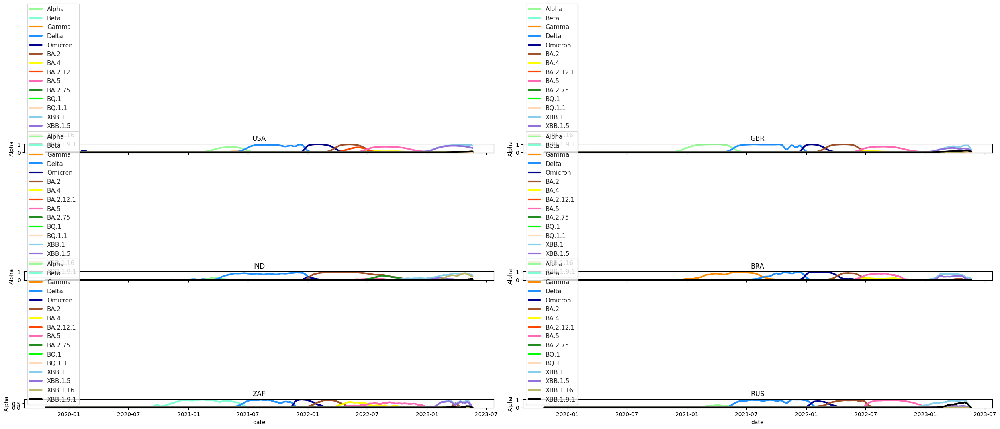

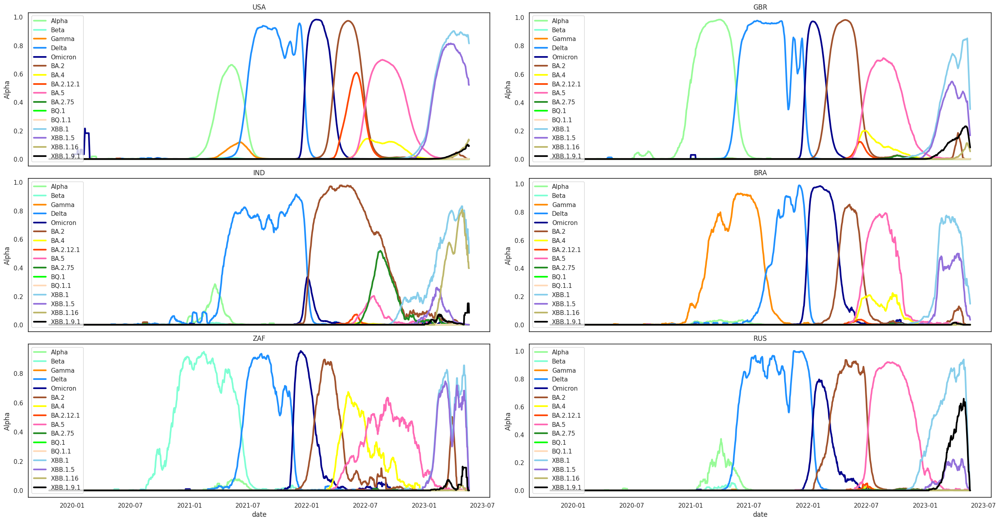

Done.


In [19]:
usavocdf = vocs_dataframe(Alias, dis_lineage_date_['USA'], 15)
gbrvocdf = vocs_dataframe(Alias, dis_lineage_date_['GBR'], 15)
indvocdf = vocs_dataframe(Alias, dis_lineage_date_['IND'], 15)
bravocdf = vocs_dataframe(Alias, dis_lineage_date_['BRA'], 15)
zafvocdf = vocs_dataframe(Alias, dis_lineage_date_['ZAF'], 15)
rusvocdf = vocs_dataframe(Alias, dis_lineage_date_['RUS'], 15)


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(25,10), sharey=False,sharex = True,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()
sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

df = usavocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax1)
ax1.grid(False)
ax1.set_title('USA')


df = gbrvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax2)
ax2.grid(False)
ax2.set_title('GBR')


df = indvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax3)
ax3.grid(False)
ax3.set_title('IND')


df = bravocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax4)
ax4.grid(False)
ax4.set_title('BRA')

df = zafvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax5)
ax5.grid(False)
ax5.set_title('ZAF')


df = rusvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax6)
ax6.grid(False)
ax6.set_title('RUS')

plt.savefig('voc of the countries.png', dpi = 300)
plt.show()
plt.close('all')


#vocplate = {'Alpha':'palegreen','Beta':'aquamarine','Delta':'dodgerblue','Gamma':'darkorange','Omicron':'darkblue','BA.2':'sienna','BA.2.12.1':'orangered',"BA.2.75":'forestgreen','BA.4':'yellow','BA.5':'hotpink'}
f, axes = plt.subplots(nrows=3, ncols=2,figsize=(25,13), sharey=False,sharex = True,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()
sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

df = usavocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax1)
ax1.grid(False)
ax1.set_title('USA')


df = gbrvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax2)
ax2.grid(False)
ax2.set_title('GBR')


df = indvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax3)
ax3.grid(False)
ax3.set_title('IND')


df = bravocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax4)
ax4.grid(False)
ax4.set_title('BRA')

df = zafvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax5)
ax5.grid(False)
ax5.set_title('ZAF')


df = rusvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax6)
ax6.grid(False)
ax6.set_title('RUS')

plt.savefig('voc of the countries for save.png', dpi = 600)
plt.show()
plt.close('all')

timer_server(time_begin_all, "pred.ipynb Done")

In [158]:
usavocdf

,date,Alpha,Beta,Gamma,Delta,Omicron,BA.2,BA.4,BA.2.12.1,BA.5,BA.2.75,BQ.1,XBB
0,2019-10-22,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000
1,2019-10-23,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000
2,2019-10-24,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000
3,2019-10-25,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000
4,2019-10-26,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1260,2023-05-16,0.0,0.0,0.0,0.000135,0.0,0.001066,0.0,0.0,0.001038,0.0,0.008188,0.910950
1261,2023-05-17,0.0,0.0,0.0,0.000135,0.0,0.000810,0.0,0.0,0.000910,0.0,0.007548,0.902095
1262,2023-05-18,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000910,0.0,0.007143,0.899049
1263,2023-05-19,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000766,0.0,0.005989,0.886351


In [3]:
time_begin = time.time()

p = Pool(60)

    
filePath = './country_json/'
jsonlist = os.listdir(filePath)
for thefile in jsonlist:
    if thefile.endswith('.json'):
        p.apply_async(final_output_thread_readable, args = (countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, thefile, ))
        
p.close()
p.join()
timer_server(time_begin, 'final_output_thread_readable Done')

Done.


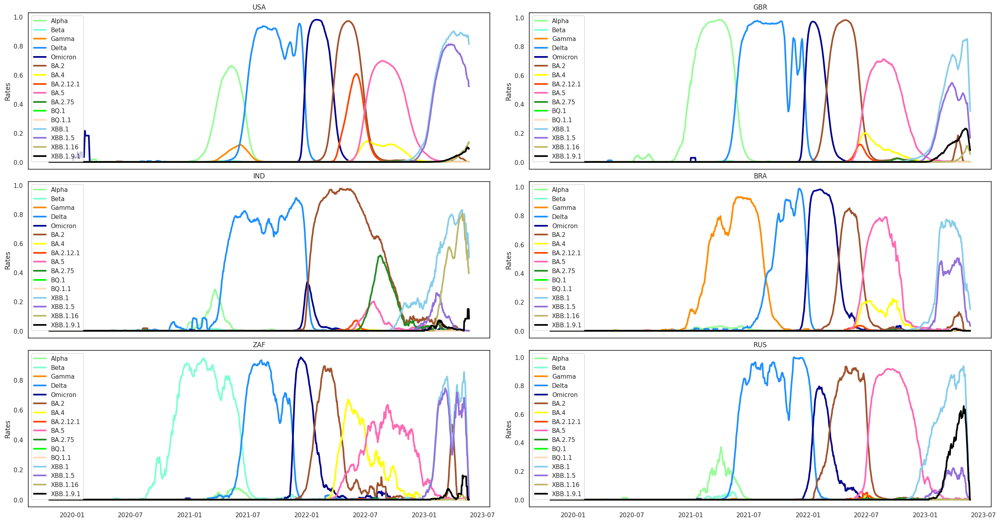

In [20]:


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(25,13), sharey=False,sharex = True,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()
sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

df = usavocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax1)
ax1.grid(False)
ax1.set_title('USA')
ax1.set_ylabel('Rates')


df = gbrvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax2)
ax2.grid(False)
ax2.set_title('GBR')
ax2.set_ylabel('Rates')

df = indvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax3)
ax3.grid(False)
ax3.set_title('IND')
ax3.set_ylabel('Rates')

df = bravocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax4)
ax4.grid(False)
ax4.set_title('BRA')
ax4.set_ylabel('Rates')


df = zafvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax5)
ax5.grid(False)
ax5.set_title('ZAF')
ax5.set_ylabel('Rates')
ax5.set_xlabel('')

df = rusvocdf
collist = list(df.columns)
for voc in collist:
    if voc != 'date':
        line = sns.lineplot(x="date", y=voc,data=df, label = voc,color=vocplate[voc],linewidth = 3, ax = ax6)
ax6.grid(False)
ax6.set_ylabel('Rates')
ax6.set_title('RUS')
ax6.set_xlabel('')


plt.savefig('voc of the countries for save.png', dpi = 600)
plt.savefig('voc of the countries for save.pdf', dpi = 600)
plt.savefig('voc of the countries for save.svg', dpi = 600)
plt.show()
plt.close('all')

In [21]:
unic

{'Alpha': {'N.203.aaa',
  'N.204.cga',
  'N.235.ttt',
  'N.3.cta',
  'ORF8.27.taa',
  'ORF8.52.ata',
  'ORF8.61.ttc',
  'ORF8.68.taa',
  'ORF8.73.tgc',
  'S.1118.cac',
  'S.501.tat',
  'S.570.gat',
  'S.614.ggt',
  'S.681.cat',
  'S.716.ata',
  'S.982.gca',
  'orf1ab.1001.att',
  'orf1ab.1708.gat',
  'orf1ab.2230.aca',
  'orf1ab.2259.att',
  'orf1ab.4619.cta',
  'orf1ab.4715.ctt'},
 'Beta': {'E.71.ctt',
  'N.205.att',
  'ORF3a.131.ttg',
  'ORF3a.171.tta',
  'ORF3a.254.tga',
  'ORF3a.57.cat',
  'S.18.ttt',
  'S.215.ggt',
  'S.417.aat',
  'S.484.aaa',
  'S.701.gta',
  'S.80.gct',
  'orf1ab.1655.aat',
  'orf1ab.265.atc',
  'orf1ab.3353.agg',
  'orf1ab.4715.cat'},
 'Delta': {'M.82.acc',
  'N.203.atg',
  'N.215.tgt',
  'N.377.tat',
  'N.63.ggc',
  'ORF3a.26.tta',
  'ORF7a.120.ata',
  'ORF7a.82.gct',
  'ORF8.93.tct',
  'S.142.gat',
  'S.19.aga',
  'S.452.cgg',
  'S.478.aaa',
  'S.681.cgt',
  'S.95.att',
  'S.950.aat',
  'orf1ab.1306.tct',
  'orf1ab.1750.gcg',
  'orf1ab.2046.cta',
  'orf1ab.2

In [22]:
vocorder

['Alpha',
 'Beta',
 'Delta',
 'Gamma',
 'Omicron',
 'BA.2',
 'BA.2.12.1',
 'BA.4',
 'BA.5',
 'BA.2.75',
 'BQ.1',
 'BQ.1.1',
 'XBB.1',
 'XBB.1.5',
 'XBB.1.16',
 'XBB.1.9.1']

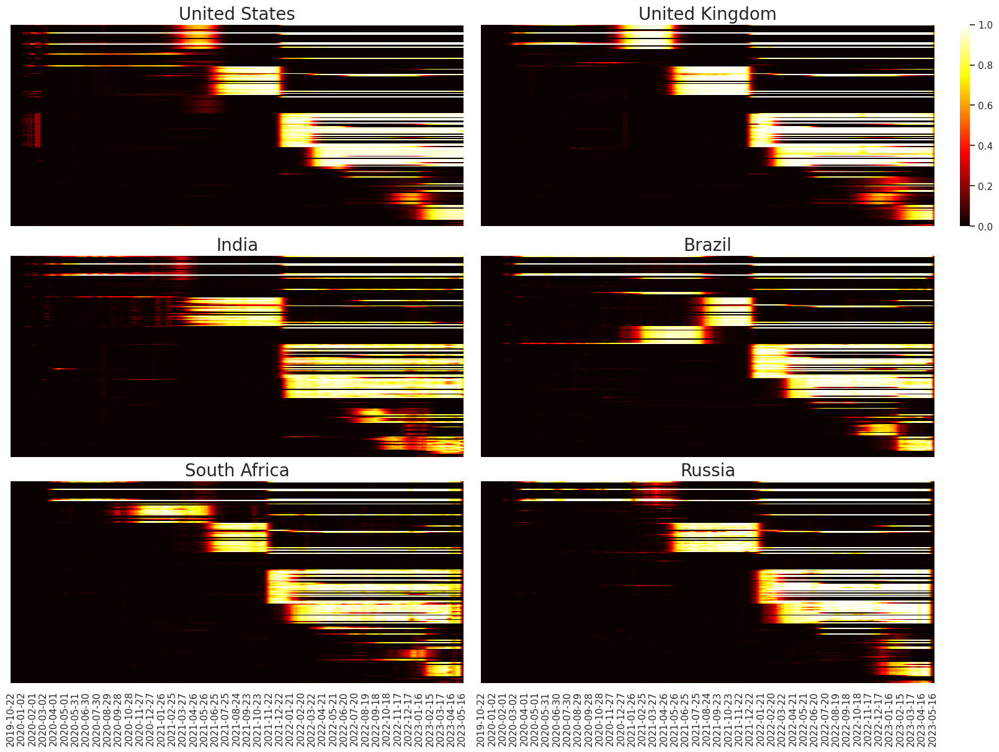

In [25]:
f, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3, 2,figsize=(16,12), sharey=True,sharex =True,layout="constrained")
mycmap = 'hot'
fontsize = 20
g1 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United States of America (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = False,cmap = mycmap, yticklabels = False,cbar = False,  ax = ax1)
g2 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United Kingdom of Great Britain and Northern Ireland (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,cmap = mycmap,vmin = 0, vmax = 1, xticklabels = False, yticklabels = False,cbar = True, ax =ax2)
g3 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/India.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = False, cbar = False,cmap = mycmap, yticklabels = False, ax = ax3)
g4 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Brazil.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = False, yticklabels = False,cmap = mycmap,cbar = False,ax = ax4)
g5 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/South Africa.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, cbar = False,cmap = mycmap, yticklabels = False, ax = ax5)
g6 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Russian Federation (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, cmap = mycmap,yticklabels = False, cbar = False, ax = ax6)
#g7 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/South Africa.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = True,cbar = False,cmap = mycmap, yticklabels = False, ax = ax7)
#g8 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Russian Federation (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = True,cmap = mycmap,yticklabels = False, cbar = False, ax = ax8)



ax1.set_title('United States',fontsize=fontsize)
ax2.set_title('United Kingdom',fontsize=fontsize)
ax3.set_title('India',fontsize=fontsize)
ax4.set_title('Brazil',fontsize=fontsize)
ax5.set_title('South Africa',fontsize=fontsize)
ax6.set_title('Russia',fontsize=fontsize)

    
ax1.set_xlabel('')
ax2.set_xlabel('')
ax3.set_xlabel('')
ax4.set_xlabel('')
ax5.set_xlabel('')
ax6.set_xlabel('')
#ax7.set_xlabel('')
#ax8.set_xlabel('')
plt.savefig('heatmap-ppt.png', dpi = 300)
plt.show()

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections.abc import Iterable
from sklearn import linear_model

class AxTransformer:
    def __init__(self, datetime_vals=False):
        self.datetime_vals = datetime_vals
        self.lr = linear_model.LinearRegression()
        
        return
    
    def process_tick_vals(self, tick_vals):
        if not isinstance(tick_vals, Iterable) or isinstance(tick_vals, str):
            tick_vals = [tick_vals]
            
        if self.datetime_vals == True:
            tick_vals = pd.to_datetime(tick_vals).astype(int).values
            
        tick_vals = np.array(tick_vals)
            
        return tick_vals
    
    def fit(self, ax, axis='x'):
        axis = getattr(ax, f'get_{axis}axis')()
        
        tick_locs = axis.get_ticklocs()
        tick_vals = self.process_tick_vals([label._text for label in axis.get_ticklabels()])
        
        self.lr.fit(tick_vals.reshape(-1, 1), tick_locs)
        
        return
    
    def transform(self, tick_vals):        
        tick_vals = self.process_tick_vals(tick_vals)
        tick_locs = self.lr.predict(np.array(tick_vals).reshape(-1, 1))
        
        return tick_locs
    
def set_date_ticks(ax, start_date, end_date, axis='y', date_format='%Y-%m-%d', **date_range_kwargs):
    dt_rng = pd.date_range(start_date, end_date, **date_range_kwargs)

    ax_transformer = AxTransformer(datetime_vals=True)
    ax_transformer.fit(ax, axis=axis)
    
    getattr(ax, f'set_{axis}ticks')(ax_transformer.transform(dt_rng))
    getattr(ax, f'set_{axis}ticklabels')(dt_rng.strftime(date_format))

    ax.tick_params(axis=axis, which='both', bottom=True, top=False, labelbottom=True)
    
    return ax

#https://stackoverflow.com/questions/40925458/date-axis-in-heatmap-seaborn

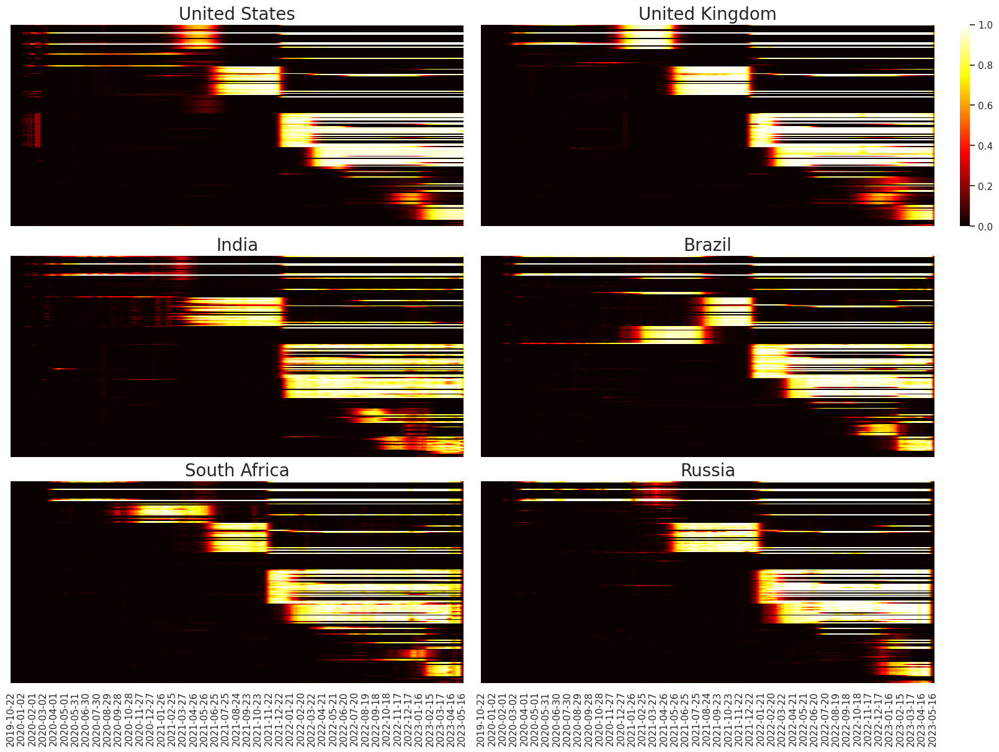

In [26]:


f, ((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3, 2,figsize=(16,12), sharey=True,sharex =True,layout="constrained")
mycmap = 'hot'
fontsize = 20
g1 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United States of America (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = False,cmap = mycmap, yticklabels = False,cbar = False,  ax = ax1)
g2 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United Kingdom of Great Britain and Northern Ireland (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,cmap = mycmap,vmin = 0, vmax = 1, xticklabels = False, yticklabels = False,cbar = True, ax =ax2)
g3 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/India.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1,xticklabels = False, cbar = False,cmap = mycmap, yticklabels = False, ax = ax3)
g4 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Brazil.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, xticklabels = False, yticklabels = False,cmap = mycmap,cbar = False,ax = ax4)
g5 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/South Africa.mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, cbar = False,cmap = mycmap, yticklabels = False, ax = ax5)
g6 = sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/Russian Federation (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T,vmin = 0, vmax = 1, cmap = mycmap,yticklabels = False, cbar = False, ax = ax6)

#set_date_ticks(ax6, '2019-06-01', '2020-06-01', freq='2MS', date_format='%b `%y',axis='x')
#https://stackoverflow.com/questions/40925458/date-axis-in-heatmap-seaborn
ax1.set_title('United States',fontsize=fontsize)
ax2.set_title('United Kingdom',fontsize=fontsize)
ax3.set_title('India',fontsize=fontsize)
ax4.set_title('Brazil',fontsize=fontsize)
ax5.set_title('South Africa',fontsize=fontsize)
ax6.set_title('Russia',fontsize=fontsize)

    
ax1.set_xlabel('')
ax2.set_xlabel('')
ax3.set_xlabel('')
ax4.set_xlabel('')
ax5.set_xlabel('')
ax6.set_xlabel('')
#ax7.set_xlabel('')
#ax8.set_xlabel('')
plt.savefig('heatmap-ppt.png', dpi = 300)
plt.show()

In [10]:
poland = pd.read_csv('mut-date-dataframe/Poland.mut_df.csv', index_col = 'date')

<AxesSubplot: xlabel='date'>

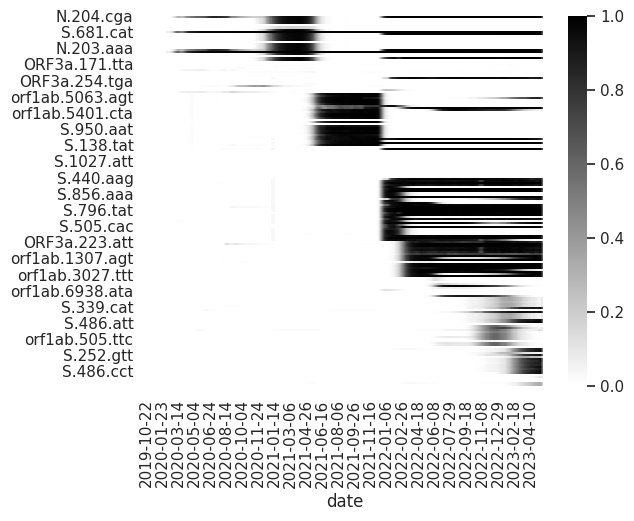

In [27]:
sns.heatmap(pd.DataFrame(pd.read_csv('mut-date-dataframe/United Kingdom of Great Britain and Northern Ireland (the).mut_df.csv', index_col = 'date'), columns = mut_order_2).fillna(0).T, cmap = 'binary', vmin = 0, vmax = 1)

In [ ]:
#final_output_thread_readable(countrynametoiso, isotocountryname, abbreviationdict, country_mut_sum_, thresholddict, 'South Africa_mut_date_.json')

In [28]:
for mut in USA:
    slope_glance_1(mut, USA_mut_date_, 15)

NameError: name 'USA' is not defined

In [13]:
time_begin = time.time()
slope_df_2 = select_mut_slope(USA, USA_mut_date_, 15)
timer_server(time_begin, 'Slope Done')

NameError: name 'USA' is not defined

In [ ]:
#global_timeseq = formtimeseq(datefiller('2020-01-26', '2022-05-30'))

In [14]:
metadict['EPI_ISL_7855708']

{'Virus_Strain_Name': 'hCoV-19/United States/CA-CDPH-2000013126/2020',
 'Accession_ID': 'EPI_ISL_7855708',
 'Data_Source': 'GISAID',
 'Related_ID': '',
 'Lineage': 'B.1.429',
 'Nuc.Completeness': 'Complete',
 'Sequence_Length': '29867',
 'Host': 'Human',
 'Sample_Collection_Date': '2020-12-15',
 'Collection_Date_Year': '2020',
 'Collection_Date_Month': '12',
 'Collection_Date_Day': '15',
 'Location': 'North America / United States / California',
 'Location_Country': 'United States',
 'Continent': 'North America',
 'Originating_Lab': 'CDPH VBL',
 'Submission_Date': '2021-12-20',
 'Submitting_Lab': 'California Department of Public Health',
 'Create_Time': '2021-12-23 10:59:36',
 'Last_Update_Time': '2021-12-23 10:59:36',
 'SnpCounts': '27',
 'AminoacidCounts': '16',
 'deletionCounts': '0',
 'indelCounts': '0'}

In [29]:
dis_global_date_lineage_['USA']['2020-01-05']

{'B.1.375': 1, 'BA.1': 1}

In [30]:
print(len(errset))

64


In [31]:
def lineage_glance(thelineage, lineage_date_):
    #print(mut)
    test_dfb = pd.DataFrame.from_dict(lineage_date_[thelineage], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[thelineage]))
    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
    test_dfb.date = pd.to_datetime(test_dfb.date)
    
    test_dfb['rate'] = test_dfb['rate'].rolling(15).mean()
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    sns.set(rc={'figure.figsize':(30,5)})
    # Plot the responses for different events and regions
    sns.lineplot(x="date", y="rate",data=test_dfb, label = thelineage)
    return test_dfb

In [32]:
def lineage_glance2B(vocname, lineagelist, lineage_date_, day):
    #print(mut)
    sns.set(rc={'figure.figsize':(20,3.33)})
    count = 0
    for thealias in lineagelist:
        for allalias in lineage_date_:
            if allalias == thealias:
                if count == 0:
                    test_dfa = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
                    test_dfa.date = pd.to_datetime(test_dfa.date)
                    count += 1
                else:
                    test_dfb = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
                    test_dfb.date = pd.to_datetime(test_dfb.date)
                    count += 1
                    test_dfa['rate'] = test_dfa['rate'] + test_dfb['rate']
    test_dfa['rate'] = test_dfa['rate'].rolling(day).mean()
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    # Plot the responses for different events and regions
    sns.lineplot(x="date", y="rate",data=test_dfa, label = vocname)
    return test_dfa['rate']

In [33]:
def lineage_glance2(vocname, lineagelist, lineage_date_, day):
    #print(mut)
    sns.set(rc={'figure.figsize':(20,3.33)})
    count = 0
    for thealias in lineagelist:
        for allalias in lineage_date_:
            if allalias.startswith(thealias):
                if count == 0:
                    test_dfa = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
                    test_dfa.date = pd.to_datetime(test_dfa.date)
                    count += 1
                else:
                    test_dfb = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
                    test_dfb.date = pd.to_datetime(test_dfb.date)
                    count += 1
                    test_dfa['rate'] = test_dfa['rate'] + test_dfb['rate']
    test_dfa['rate'] = test_dfa['rate'].rolling(day).mean()
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    # Plot the responses for different events and regions
    sns.lineplot(x="date", y="rate",data=test_dfa, label = vocname)
    return test_dfa['rate']

In [36]:
#debug
def voc_caller_core(vocname, lineagelist, lineage_date_, day):
    count = 0
    test_dfa = pd.DataFrame()  # Initialize test_dfa
    for thealias in lineagelist:
        for allalias in lineage_date_:
            if allalias.startswith(thealias):
                if count == 0:
                    test_dfa = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
                    test_dfa.date = pd.to_datetime(test_dfa.date)
                    count += 1
                else:
                    test_dfb = pd.DataFrame.from_dict(lineage_date_[allalias], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_[allalias]))
                    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
                    test_dfb.date = pd.to_datetime(test_dfb.date)
                    count += 1
                    test_dfa['rate'] = test_dfa['rate'] + test_dfb['rate']
    if test_dfa.empty:
        test_dfa = pd.DataFrame.from_dict(lineage_date_['BA.1'], orient = 'index', columns = ['rate']).reindex(formtimeseq(lineage_date_['BA.1']))
        test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
        test_dfa.date = pd.to_datetime(test_dfa.date)
        test_dfa['rate'] = 0
    else:
        test_dfa[vocname] = test_dfa['rate'].rolling(day).mean()
    newdf = pd.DataFrame(test_dfa, columns=['date', vocname])
    return newdf

def voc_caller(theiso, Alias, lineage_date_, day):
    time_begin = time.time()
    count = 0
    for vocname in Alias:
        if count == 0:
            thedata = voc_caller_core(vocname, Alias[vocname], lineage_date_, day)
            count += 1
        else:
            newdata = voc_caller_core(vocname, Alias[vocname], lineage_date_, day)
            thedata = pd.merge(thedata, newdata)
        #print(thedata)
    thedata.to_csv('voc_caller/' + theiso + '.csv')
    timer_server(time_begin, theiso + ' voc_caller Done')
    return thedata

In [83]:
Alias1 = {'Alpha':['B.1.1.7'],
         'Beta':['B.1.351'],
         'Gamma':['P.1','B.1.1.28.1'],
        'Delta':['B.1.617.2', 'AY'],
        'Omicron':['B.1.1.529', 'BA']}

In [84]:
theusa = voc_caller('USA', Alias1, dis_lineage_date_['USA'], 15)
therus = voc_caller('RUS', Alias1, dis_lineage_date_['RUS'], 15)
thebra = voc_caller('BRA', Alias1, dis_lineage_date_['BRA'], 15)
thezaf = voc_caller('ZAF', Alias1, dis_lineage_date_['ZAF'], 15)
theind = voc_caller('IND', Alias1, dis_lineage_date_['IND'], 15)
thegbr = voc_caller('GBR', Alias1, dis_lineage_date_['GBR'], 15)

Done.
Done.
Done.
Done.
Done.


KeyboardInterrupt: 

In [88]:
thegbr = voc_caller('GBR', Alias1, dis_lineage_date_['GBR'], 15)

Done.


In [37]:
theusafull = voc_caller('USA', Alias, dis_lineage_date_['USA'], 15)
therusfull = voc_caller('RUS', Alias, dis_lineage_date_['RUS'], 15)
thebrafull = voc_caller('BRA', Alias, dis_lineage_date_['BRA'], 15)
thezaffull = voc_caller('ZAF', Alias, dis_lineage_date_['ZAF'], 15)
theindfull = voc_caller('IND', Alias, dis_lineage_date_['IND'], 15)
thegbrfull = voc_caller('GBR', Alias, dis_lineage_date_['GBR'], 15)

Done.
Done.
Done.
Done.
Done.
Done.


In [ ]:
thegbrfull = voc_caller('GBR', Alias, dis_lineage_date_['GBR'], 15)

In [97]:
def pandemic_stage_core(thelist, forthres, rearthres):
    
    if np.all(np.isnan(thelist)):
        print("Warning: the input list contains only NaNs!")
        return None, None, None, None, None, None
    
    themax = np.nanmax(thelist)
    theforthres = themax * forthres
    therearthres = themax * rearthres
    
    forthflag = False
    maxflag = False
    rearflag = False
    
    indexforth = None  # 初始化 indexforth
    indexmax = None  # 初始化 indexmax
    indexrear = None  # 初始化 indexrear
    
    for i in range(len(thelist)):
        current = thelist[i]
        if not pd.isna(current):
            if not maxflag:
                if current >= theforthres and not forthflag:
                    forthflag = True
                    indexforth = i
                if current >= themax:
                    maxflag = True
                    indexmax = i
            else:
                if not rearflag and current <= therearthres:
                    indexrear = i
                    rearflag = True
    if indexforth is not None:
        theforth = thelist[indexforth]
    else:
        theforth = None

    if indexrear is not None:
        therear = thelist[indexrear]
    else:
        therear = None
    #return indexforth, indexmax, indexrear, themax, thelist[indexforth], thelist[indexrear]

    return indexforth, indexmax, indexrear, themax, theforth, therear
        

def pandemic_stage(thedataframe, Alias, forthres = 0.5, rearthres = 0.8):
    stage_result = {}
    thedataframe['strdate'] = thedataframe['date'].astype(str)
    dateindex = thedataframe['strdate'].values.tolist()
    for thestrain in Alias:
        stage_result[thestrain] = {}
        indexforth, indexmax, indexrear, themax, theforth, therear = pandemic_stage_core(thedataframe[thestrain].values.tolist(), forthres, rearthres)
        stage_result[thestrain]['themax'] = themax
        stage_result[thestrain]['indexforth'] = indexforth
        stage_result[thestrain]['indexmax'] = indexmax
        stage_result[thestrain]['indexrear'] = indexrear
        stage_result[thestrain]['theforth'] = theforth
        stage_result[thestrain]['therear'] = therear
        stage_result[thestrain]['dateindex'] = dateindex
    return stage_result

In [98]:
result_pandemic_stage_ = {}
result_pandemic_stage_['USA'] = pandemic_stage(theusafull, Alias, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['RUS'] = pandemic_stage(therusfull, Alias, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['BRA'] = pandemic_stage(thebrafull, Alias, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['ZAF'] = pandemic_stage(thezaffull, Alias, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['IND'] = pandemic_stage(theindfull, Alias, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['GBR'] = pandemic_stage(thegbrfull, Alias, forthres = 0.5, rearthres = 0.8)

In [89]:
result_pandemic_stage_ = {}
result_pandemic_stage_['USA'] = pandemic_stage(theusa, Alias1, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['RUS'] = pandemic_stage(therus, Alias1, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['BRA'] = pandemic_stage(thebra, Alias1, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['ZAF'] = pandemic_stage(thezaf, Alias1, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['IND'] = pandemic_stage(theind, Alias1, forthres = 0.5, rearthres = 0.8)
result_pandemic_stage_['GBR'] = pandemic_stage(thegbr, Alias1, forthres = 0.5, rearthres = 0.8)

In [101]:
def pandemic_stage_trans(country_date_mut_, dis_global_date_id_, result_pandemic_stage_, maxthres = 0.5, mutratethres = 0.1):
    err = set()
    exsist_convertdict = {}
    time_begin = time.time()
    result_pandemic_stage_strain = {}
    for theiso in result_pandemic_stage_:
        for thestrain in result_pandemic_stage_[theiso]:
            
            themax = result_pandemic_stage_[theiso][thestrain]['themax']
            
            if themax is not None and themax >= maxthres:
                if thestrain not in result_pandemic_stage_strain:
                    result_pandemic_stage_strain[thestrain] = {}
                result_pandemic_stage_strain[thestrain][theiso] = {}
                thedatelist = result_pandemic_stage_[theiso][thestrain]['dateindex'][result_pandemic_stage_[theiso][thestrain]['indexforth']:result_pandemic_stage_[theiso][thestrain]['indexrear']]
                thesum = 0
                for thedate in thedatelist:
                    if thedate in dis_global_date_id_[theiso]:
                        thesum += len(dis_global_date_id_[theiso][thedate])
                tmpmutdict = {}
                thecountry = isotocountryname[theiso]
                for thedate in thedatelist:
                    if thedate in country_date_mut_[thecountry]:
                        for themut in country_date_mut_[thecountry][thedate]:
                            if themut not in tmpmutdict:
                                tmpmutdict[themut] = country_date_mut_[thecountry][thedate][themut]
                            else:
                                tmpmutdict[themut] += country_date_mut_[thecountry][thedate][themut]
                #different codon but the same amino acid mutations
                tmpmutdict2 = {}
                convertdict = {}
                for themut in tmpmutdict:
                    try:
                        themutrd = conversion_readable(themut)
                        if themutrd not in tmpmutdict2:
                            tmpmutdict2[themutrd] = tmpmutdict[themut]
                            convertdict[themutrd] = []
                            convertdict[themutrd].append(themut)
                        else:
                            tmpmutdict2[themutrd] += tmpmutdict[themut]
                            convertdict[themutrd].append(themut)
                        if themutrd not in exsist_convertdict:
                            exsist_convertdict[themutrd] = set()
                            exsist_convertdict[themutrd].add(themut)
                        else:
                            exsist_convertdict[themutrd].add(themut)
                    except:
                        err.add(themut)
                        
                allmutdict = {}
                for themut in tmpmutdict2:
                    allmutdict[themut] = tmpmutdict2[themut] / thesum
                mainmutdict = {}
                for themut in allmutdict:
                    if allmutdict[themut] >= mutratethres:
                        mainmutdict[themut] = allmutdict[themut]
                result_pandemic_stage_strain[thestrain][theiso]['allmutdict'] = allmutdict
                result_pandemic_stage_strain[thestrain][theiso]['mainmutdict'] = mainmutdict
                result_pandemic_stage_strain[thestrain][theiso]['thedatelist'] = thedatelist
                result_pandemic_stage_strain[thestrain][theiso]['convertdict'] = convertdict
    timer_server(time_begin, 'pandemic_stage_trans Done')
    return result_pandemic_stage_strain, exsist_convertdict, err

result_pandemic_stage_strain, exsist_convertdict, err = pandemic_stage_trans(country_date_mut_, dis_global_date_id_, result_pandemic_stage_, maxthres = 0.5, mutratethres = 0.1)

Done.


In [26]:
len(exsist_convertdict)

125218

In [102]:
len(exsist_convertdict)

124880

In [85]:
exsist_convertdict = {'S-L452R':{'S.452.cgg'},'S-L452Q':{'S.452.cag'},
                     'S-E484A':{'S.484.gca'},'S-E484K':{'S.484.aaa'}, 'S-E484Q':{'S.484.caa'},
                     'S-F486V':{'S.486.gtt'},
                      'S-F486S':{'S.486.tct'},
                      'S-F486P':{'S.486.cct'},
                      'S-G339D':{'S.339.gat'},
                      'S-G339H':{'S.339.cat'},
                      'S-R346K':{'S.346.aaa','S.346.aag'},
                      'S-R346T':{'S.346.aca'},
                      'S-S371F':{'S.371.ttc'},
                      'S-S371L':{'S.371.ctc'},
                      'S-K417N':{'S.417.aat'},
                      'S-K417T':{'S.417.acg'},
                      'S-P681H':{'S.681.cat'},
                      'S-P681R':{'S.681.cgt'}
                     }

In [91]:
exsist_convertdict2 = {'S-L452R':{'S.452.cgg'},'S-L452Q':{'S.452.cag'},
                     'S-E484A':{'S.484.gca'},'S-E484K':{'S.484.aaa'}, 'S-E484Q':{'S.484.caa'},
                     'S-F486V':{'S.486.gtt'},
                      'S-F486S':{'S.486.tct'},
                      'S-F486P':{'S.486.cct'},
                      'S-G339D':{'S.339.gat'},
                      'S-G339H':{'S.339.cat'},
                      'S-R346K':{'S.346.aaa','S.346.aag'},
                      'S-R346T':{'S.346.aca'},
                      'S-S371F':{'S.371.ttc'},
                      'S-S371L':{'S.371.ctc'},
                      'S-K417N':{'S.417.aat'},
                      'S-K417T':{'S.417.acg'},
                      'S-P681H':{'S.681.cat'},
                      'S-P681R':{'S.681.cgt'}
                     }

for what in exsist_convertdict2:
    print(what)
    print(exsist_convertdict[what])

S-L452R
{'S.452.cgg', 'S.452.aga', 'S.452.cgt', 'S.452.cgc', 'S.452.cga', 'S.452.agg'}
S-L452Q
{'S.452.cag', 'S.452.caa'}
S-E484A
{'S.484.gca', 'S.484.gct', 'S.484.gcg', 'S.484.gcc'}
S-E484K
{'S.484.aaa', 'S.484.aag'}
S-E484Q
{'S.484.cag', 'S.484.caa'}
S-F486V
{'S.486.gtc', 'S.486.gtt', 'S.486.gtg'}
S-F486S
{'S.486.tca', 'S.486.tct', 'S.486.tcc', 'S.486.agc', 'S.486.agt'}
S-F486P
{'S.486.cct', 'S.486.ccg', 'S.486.ccc'}
S-G339D
{'S.339.gac', 'S.339.gat'}
S-G339H
{'S.339.cat'}
S-R346K
{'S.346.aag', 'S.346.aaa'}
S-R346T
{'S.346.acc', 'S.346.act', 'S.346.aca'}
S-S371F
{'S.371.ttt', 'S.371.ttc'}
S-S371L
{'S.371.ctg', 'S.371.ctt', 'S.371.ctc', 'S.371.cta', 'S.371.tta', 'S.371.ttg'}
S-K417N
{'S.417.aat', 'S.417.aac'}
S-K417T
{'S.417.aca', 'S.417.acg', 'S.417.act'}
S-P681H
{'S.681.cac', 'S.681.cat'}
S-P681R
{'S.681.cgc', 'S.681.cgt', 'S.681.cga', 'S.681.cgg'}


In [27]:
for what in exsist_convertdict:
    if what.startswith('S-N501'):
        print(what)
        print(exsist_convertdict[what])

S-N501Y
{'S.501.tac', 'S.501.tat'}
S-N501T
{'S.501.acg', 'S.501.acc', 'S.501.aca', 'S.501.act'}
S-N501C
{'S.501.tgt', 'S.501.tgc'}
S-N501M
{'S.501.atg'}
S-N501R
{'S.501.aga', 'S.501.cga', 'S.501.agg'}
S-N501D
{'S.501.gac', 'S.501.gat'}
S-N501G
{'S.501.ggt', 'S.501.ggc'}
S-N501S
{'S.501.tct', 'S.501.agt', 'S.501.agc', 'S.501.tcc'}
S-N501H
{'S.501.cat', 'S.501.cac'}
S-N501F
{'S.501.ttc', 'S.501.ttt'}
S-N501I
{'S.501.att', 'S.501.atc', 'S.501.ata'}
S-N501V
{'S.501.gtg', 'S.501.gta', 'S.501.gtt', 'S.501.gtc'}
S-N501K
{'S.501.aag', 'S.501.aaa'}
S-N501E
{'S.501.gaa'}
S-N501W
{'S.501.tgg'}
S-N501*
{'S.501.tag'}
S-N501L
{'S.501.tta', 'S.501.ctt'}
S-N501Q
{'S.501.caa'}
S-N501P
{'S.501.cct'}


In [103]:
for what in exsist_convertdict:
    if what.startswith('S-N501'):
        print(what)
        print(exsist_convertdict[what])

S-N501Y
{'S.501.tac', 'S.501.tat'}
S-N501T
{'S.501.act', 'S.501.acc', 'S.501.aca'}
S-N501C
{'S.501.tgc', 'S.501.tgt'}
S-N501M
{'S.501.atg'}
S-N501R
{'S.501.cga', 'S.501.aga', 'S.501.agg'}
S-N501D
{'S.501.gac', 'S.501.gat'}
S-N501G
{'S.501.ggt', 'S.501.ggc'}
S-N501S
{'S.501.agc', 'S.501.tcc', 'S.501.agt', 'S.501.tct'}
S-N501H
{'S.501.cac', 'S.501.cat'}
S-N501F
{'S.501.ttc', 'S.501.ttt'}
S-N501I
{'S.501.atc', 'S.501.ata', 'S.501.att'}
S-N501V
{'S.501.gtc', 'S.501.gtg', 'S.501.gta', 'S.501.gtt'}
S-N501K
{'S.501.aaa', 'S.501.aag'}
S-N501E
{'S.501.gaa'}
S-N501*
{'S.501.tag'}
S-N501L
{'S.501.ctt', 'S.501.tta'}
S-N501Q
{'S.501.caa'}
S-N501W
{'S.501.tgg'}
S-N501P
{'S.501.cct'}


In [104]:
exsist_convertdict['S-N501Y']

{'S.501.tac', 'S.501.tat'}

In [105]:
def rate_quick_reader(themut, aisodict):
    if themut in aisodict['mainmutdict']:
        return aisodict['mainmutdict'][themut]
    elif themut in aisodict['allmutdict']:
        return aisodict['allmutdict'][themut]
    else:
        return 0

def differentrate_finder_core(aisodict, bisodict, thres = 0.3):
    core_result = {}
    allset = set(list(aisodict['mainmutdict'])) | set(list(bisodict['mainmutdict']))
    for themut in allset:
        theabs = abs(rate_quick_reader(themut, aisodict) - rate_quick_reader(themut, bisodict))
        if theabs >= thres:
            core_result[themut] = theabs
    return core_result
    
def differentrate_finder(result_pandemic_stage_strain, thres = 0.3):
    result = {}
    for thestrain in result_pandemic_stage_strain:
        result[thestrain] = {}
        theisolist = list(result_pandemic_stage_strain[thestrain])
        if len(theisolist) > 1:
            for i in range(len(theisolist)):
                if i < len(theisolist) -2 :
                    for j in range(i + 1, len(theisolist)):
                        Aiso = theisolist[i]
                        Biso = theisolist[j]
                        vsname = Aiso + '-' + Biso
                        result[thestrain][vsname] = differentrate_finder_core(result_pandemic_stage_strain[thestrain][Aiso], result_pandemic_stage_strain[thestrain][Biso], thres)
                        
                elif i == len(theisolist) -2 :
                    Aiso = theisolist[i]
                    Biso = theisolist[i+1]
                    vsname = Aiso + '-' + Biso
                    result[thestrain][vsname] = differentrate_finder_core(result_pandemic_stage_strain[thestrain][Aiso], result_pandemic_stage_strain[thestrain][Biso], thres)
    return result
                    

In [106]:
#print the result
for thestrain in result_pandemic_stage_strain:
    print(thestrain)
    for theiso in result_pandemic_stage_strain[thestrain]:

        print(theiso, result_pandemic_stage_strain[thestrain][theiso]['thedatelist'][0], result_pandemic_stage_strain[thestrain][theiso]['thedatelist'][-1])
        print(result_pandemic_stage_strain[thestrain][theiso]['mainmutdict'])

Alpha
USA 2021-03-21 2021-06-07
{'N-G204R': 0.38309293595381005, 'S-D1118H': 0.32708069717744725, 'S-A570D': 0.3262992428910202, 'ORF8-Y73C': 0.32656674070445096, 'ORF8-Q27*': 0.32583638150598265, 'orf1ab-P4715L': 0.5506066790296742, 'S-P681H': 0.360755365735634, 'N-S235F': 0.3244237526035953, 'ORF8-R52I': 0.3244778532849633, 'orf1ab-A1708D': 0.3276758046724955, 'S-T716I': 0.3254937438573185, 'N-D3L': 0.31969895976412105, 'orf1ab-T1001I': 0.3283731023434612, 'N-R203K': 0.3801083816983406, 'S-D614G': 0.5569424699365519, 'orf1ab-I2230T': 0.3058131182129944, 'S-N501Y': 0.357262866193987, 'S-S982A': 0.3202489833580293, 'orf1ab-T265I': 0.13098376077880935, 'ORF3a-Q57H': 0.13517355799142203, 'ORF8-K68*': 0.1452663406599682, 'orf1ab-P4619L': 0.14171673484354383}
GBR 2020-12-27 2021-05-09
{'N-G204R': 0.9135465027742744, 'S-D1118H': 0.911730827050054, 'S-A570D': 0.9123594803653218, 'ORF8-Y73C': 0.9076074860505343, 'ORF8-Q27*': 0.9060807565705985, 'orf1ab-P4715L': 0.9889419491376517, 'S-P681H': 

In [107]:
#print the result
infile = open('result_pandemic_stage_strain.tsv', 'w')
for thestrain in result_pandemic_stage_strain:
    print(thestrain + '\n')
    infile.write(thestrain + '\n')
    for theiso in result_pandemic_stage_strain[thestrain]:
        strr = ''
        for themut in result_pandemic_stage_strain[thestrain][theiso]['mainmutdict']:
            if themut.startswith('S'):
                strr = strr + themut + ' '
        infile.write(theiso +' ' + result_pandemic_stage_strain[thestrain][theiso]['thedatelist'][0] + ' ' + result_pandemic_stage_strain[thestrain][theiso]['thedatelist'][-1] + '\n')
        infile.write(strr + '\n')
infile.close()

Alpha

Delta

Omicron

BA.2

BA.2.12.1

BA.5

XBB.1

XBB.1.5

XBB.1.9.1

Gamma

Beta

BA.4

BA.2.75

XBB.1.16



In [108]:
differentrate = differentrate_finder(result_pandemic_stage_strain, thres = 0.2)
for thestrain in differentrate:
    print(thestrain)
    for thevs in differentrate[thestrain]:
        print(thevs)
        print(differentrate[thestrain][thevs])

Alpha
USA-GBR
{'orf1ab-T1001I': 0.5835529586554338, 'N-G204R': 0.5304535668204644, 'S-D1118H': 0.5846501298726068, 'S-P681H': 0.553080083282925, 'ORF8-R52I': 0.5810562482288808, 'S-N501Y': 0.547092022268858, 'ORF8-Y73C': 0.5810407453460833, 'S-D614G': 0.44164013159486315, 'S-T716I': 0.5867485961386987, 'N-D3L': 0.5917624444365326, 'orf1ab-I2230T': 0.5962341049745512, 'S-A570D': 0.5860602374743016, 'ORF8-Q27*': 0.5802443750646158, 'orf1ab-P4715L': 0.43833527010797746, 'orf1ab-A1708D': 0.5816965962755605, 'S-S982A': 0.5921261157231997, 'N-S235F': 0.5827698374753965, 'N-R203K': 0.5363314881977559}
Delta
USA-RUS
{'S-G142D': 0.22135520561042477, 'orf1ab-T3255I': 0.20121114997111933, 'orf1ab-P2287S': 0.22002247649760154, 'orf1ab-K261N': 0.7586292843745661, 'ORF7a-P45L': 0.6906216421733402}
USA-BRA
{'orf1ab-A1306S': 0.24714050247091635, 'orf1ab-A6319V': 0.24804387495821212, 'orf1ab-T3646A': 0.24321427192072598, 'S-G142D': 0.25001524598114955, 'orf1ab-T3255I': 0.23507454003565098, 'N-G215C': 0

In [109]:
infile = open('result3.tsv', 'w')
for thestrain in differentrate:
    print(thestrain + '\n')
    infile.write(thestrain + '\n')
    for thevs in differentrate[thestrain]:
        print(thevs)
        infile.write(thevs + '\n')
        strr = ''
        for themut in differentrate[thestrain][thevs]:
            if themut.startswith('S'):
                strr = strr + themut + ':' + str(differentrate[thestrain][thevs][themut])[:4] + ' '
        infile.write(strr + '\n')
infile.close()

Alpha

USA-GBR
Delta

USA-RUS
USA-BRA
USA-ZAF
USA-IND
USA-GBR
RUS-BRA
RUS-ZAF
RUS-IND
RUS-GBR
BRA-ZAF
BRA-IND
BRA-GBR
ZAF-IND
ZAF-GBR
IND-GBR
Omicron

USA-RUS
USA-BRA
USA-ZAF
USA-GBR
RUS-BRA
RUS-ZAF
RUS-GBR
BRA-ZAF
BRA-GBR
ZAF-GBR
BA.2

USA-RUS
USA-BRA
USA-ZAF
USA-IND
USA-GBR
RUS-BRA
RUS-ZAF
RUS-IND
RUS-GBR
BRA-ZAF
BRA-IND
BRA-GBR
ZAF-IND
ZAF-GBR
IND-GBR
BA.2.12.1

BA.5

USA-RUS
USA-BRA
USA-ZAF
USA-GBR
RUS-BRA
RUS-ZAF
RUS-GBR
BRA-ZAF
BRA-GBR
ZAF-GBR
XBB.1

USA-RUS
USA-BRA
USA-ZAF
USA-IND
USA-GBR
RUS-BRA
RUS-ZAF
RUS-IND
RUS-GBR
BRA-ZAF
BRA-IND
BRA-GBR
ZAF-IND
ZAF-GBR
IND-GBR
XBB.1.5

USA-BRA
USA-ZAF
USA-GBR
BRA-ZAF
BRA-GBR
ZAF-GBR
XBB.1.9.1

Gamma

Beta

BA.4

BA.2.75

XBB.1.16



In [44]:
import json
with open('country_json/India_mut_date_.json', 'r', encoding = 'UTF-8') as thejson:
     IND_mut_date_ = json.load(thejson)
with open('country_json/Brazil_mut_date_.json', 'r', encoding = 'UTF-8') as thejson:
     BRA_mut_date_ = json.load(thejson)
with open('country_json/South Africa_mut_date_.json', 'r', encoding = 'UTF-8') as thejson:
     ZAF_mut_date_ = json.load(thejson)
with open('country_json/Russian Federation (the)_mut_date_.json', 'r', encoding = 'UTF-8') as thejson:
     RUS_mut_date_ = json.load(thejson)
with open('country_json/United States of America (the)_mut_date_.json', 'r', encoding = 'UTF-8') as thejson:
     USA_mut_date_ = json.load(thejson)
with open('country_json/United Kingdom of Great Britain and Northern Ireland (the)_mut_date_.json', 'r', encoding = 'UTF-8') as thejson:
     GBR_mut_date_ = json.load(thejson)

In [111]:
#mainly used
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
colordict = {'USA':'black','IND':'deepskyblue','BRA':'blueviolet','ZAF':'yellowgreen','RUS':'red','GBR':'darkorange'}

#exsist_convertdict['S-N501Y']
#country_mut_sum_['USA']['S.614.ggt'] = 2584573

#                if theiso == 'USA':
#                    thecountry = 'USA'
#                elif theiso == 'RUS':
#                    thecountry = 'Russia'

_mut_date_dict = {'USA':USA_mut_date_,
                  'IND':IND_mut_date_,
                  'BRA':BRA_mut_date_,
                  'ZAF':ZAF_mut_date_,
                  'RUS':RUS_mut_date_,
                 'GBR':GBR_mut_date_}

def single_mut_data_core(thedata, day):
    test_dfb = pd.DataFrame.from_dict(thedata, orient = 'index', columns = ['rate']).reindex(formtimeseq(thedata))
    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
    test_dfb.date = pd.to_datetime(test_dfb.date)
    test_dfb['rate'] = test_dfb['rate'].rolling(day).mean()
    return test_dfb

def single_mut_glance(mut, _mut_date_dict, colordict, day, singleswitch):
    global isotocountryname, exsist_convertdict
    sns.set(rc={'figure.figsize':(20,3.33)})
    sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)
    time_begin = time.time()
    for theiso in _mut_date_dict:
        #if theiso == 'USA':
        #    thecountry = 'USA'
        #elif theiso == 'RUS':
        #    thecountry = 'Russia'
        #else:
        thecountry = isotocountryname[theiso]
            
        if len(exsist_convertdict[mut]) == 1:
            themut = list(exsist_convertdict[mut])[0]
            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
        else:
            tmpdict = {}
            for themut in exsist_convertdict[mut]:
                if themut in country_mut_sum_[thecountry]:
                    tmpdict[themut] = country_mut_sum_[thecountry][themut]
            if len(tmpdict) == 1:
                themut = list(tmpdict)[0]
                test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
            else:
                thesorted = Counter(tmpdict).most_common()
                if singleswitch:
                    themut = list(thesorted[0])[0]
                    test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                else:
                    count = 0
                    for thet in thesorted:
                        themut = list(thet)[0]
                        if count == 0:
                            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                            count += 1
                        else:
                            test_dfb = pd.concat([test_dfb, single_mut_data_core(_mut_date_dict[theiso][themut], day)]).groupby('date')['rate'].sum().reset_index()
                
            
        #plt.plot(test_dfb.date, test_dfb.rate, color = colordict[theiso], label = theiso)
        sns.lineplot(x = 'date', y = 'rate', data = test_dfb, color = colordict[theiso], label = theiso)
    plt.title('The frequency of the mutation ' + mut + ' in different countries')
    plt.savefig('The frequency of the mutation ' + mut + ' in different countries.png', dpi = 300)
    plt.show()
    plt.close('all')
    timer_server(time_begin,'glance_output Done')

In [112]:
#mainly used
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
#colordict = {'USA':'limegreen','IND':'dodgerblue','BRA':'fuchsia','ZAF':'black','RUS':'gold','GBR':'orangered'}

#exsist_convertdict['S-N501Y']
#country_mut_sum_['USA']['S.614.ggt'] = 2584573

#                if theiso == 'USA':
#                    thecountry = 'USA'
#                elif theiso == 'RUS':
#                    thecountry = 'Russia'



def single_mut_glance_reverse(mut, _mut_date_dict, colordict, day, singleswitch):
    global isotocountryname, exsist_convertdict
    sns.set(rc={'figure.figsize':(20,3.33)})
    sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)
    time_begin = time.time()
    for theiso in _mut_date_dict:
        #if theiso == 'USA':
        #    thecountry = 'USA'
        #elif theiso == 'RUS':
        #    thecountry = 'Russia'
        #else:
        thecountry = isotocountryname[theiso]
            
        if len(exsist_convertdict[mut]) == 1:
            themut = list(exsist_convertdict[mut])[0]
            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
        else:
            tmpdict = {}
            for themut in exsist_convertdict[mut]:
                if themut in country_mut_sum_[thecountry]:
                    tmpdict[themut] = country_mut_sum_[thecountry][themut]
            if len(tmpdict) == 1:
                themut = list(tmpdict)[0]
                test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
            else:
                thesorted = Counter(tmpdict).most_common()
                if singleswitch:
                    themut = list(thesorted[0])[0]
                    test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                else:
                    count = 0
                    for thet in thesorted:
                        themut = list(thet)[0]
                        if count == 0:
                            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                            count += 1
                        else:
                            test_dfb = pd.concat([test_dfb, single_mut_data_core(_mut_date_dict[theiso][themut], day)]).groupby('date')['rate'].sum().reset_index()
                
            
        #plt.plot(test_dfb.date, test_dfb.rate, color = colordict[theiso], label = theiso)
        sns.lineplot(x = 'date', y = 'rate', data = test_dfb, color = colordict[theiso], label = theiso)
        
    for theiso in _mut_date_dict:
        thecountry = isotocountryname[theiso]
        reverse_muts = []
        for allmut in exsist_convertdict:
            if allmut.startswith(mut[:-1]) and allmut != mut:
                reverse_muts.append(allmut)
        for allmut in reverse_muts:
            for themut in exsist_convertdict[allmut]:
                if themut in country_mut_sum_[thecountry] and themut in _mut_date_dict[theiso]:
                    test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                    sns.lineplot(x = 'date', y = 'rate', data = test_dfb, color = colordict[theiso], linestyle="dashed")

    
    plt.title('The frequency of the mutation ' + mut + ' and other mutations on this site in different countries')
    plt.savefig('The frequency of the mutation ' + mut + ' and other mutations on this site in different countries.png', dpi = 300)
    plt.show()
    plt.close('all')
    timer_server(time_begin,'glance_output Done')

In [113]:
def single_mut_glance_reverse_dry(mut, _mut_date_dict, colordict, day, singleswitch):
    global isotocountryname, exsist_convertdict
    time_begin = time.time()
    df = pd.DataFrame()
    df2 = pd.DataFrame()
    for theiso in _mut_date_dict:
        thecountry = isotocountryname[theiso]
        if len(exsist_convertdict[mut]) == 1:
            themut = list(exsist_convertdict[mut])[0]
            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
        else:
            tmpdict = {}
            for themut in exsist_convertdict[mut]:
                if themut in country_mut_sum_[thecountry]:
                    tmpdict[themut] = country_mut_sum_[thecountry][themut]
            if len(tmpdict) == 1:
                themut = list(tmpdict)[0]
                test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
            else:
                thesorted = Counter(tmpdict).most_common()
                if singleswitch:
                    themut = list(thesorted[0])[0]
                    test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                else:
                    count = 0
                    for thet in thesorted:
                        themut = list(thet)[0]
                        if count == 0:
                            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                            count += 1
                        else:
                            test_dfb = pd.concat([test_dfb, single_mut_data_core(_mut_date_dict[theiso][themut], day)]).groupby('date')['rate'].sum().reset_index()

        #sns.lineplot(x = 'date', y = 'rate', data = test_dfb, color = colordict[theiso], label = theiso)
        df['date'] = test_dfb['date']
        df[theiso] = test_dfb['rate']
    df2['date'] = test_dfb['date']
    for theiso in _mut_date_dict:
        thecountry = isotocountryname[theiso]
        reverse_muts = []
        for allmut in exsist_convertdict:
            if allmut.startswith(mut[:-1]) and allmut != mut:
                reverse_muts.append(allmut)
        for allmut in reverse_muts:
            for themut in exsist_convertdict[allmut]:
                if themut in country_mut_sum_[thecountry] and themut in _mut_date_dict[theiso]:
                    test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                    df2[theiso] = test_dfb['rate']
                    #sns.lineplot(x = 'date', y = 'rate', data = test_dfb, color = colordict[theiso], linestyle="dashed")


    timer_server(time_begin,'glance_output Done')
    return df, df2

In [114]:
def single_mut_glance_dry(mut, _mut_date_dict, colordict, day, singleswitch):
    global isotocountryname, exsist_convertdict
    df = pd.DataFrame()
    time_begin = time.time()
    for theiso in _mut_date_dict:
        thecountry = isotocountryname[theiso]
        if len(exsist_convertdict[mut]) == 1:
            themut = list(exsist_convertdict[mut])[0]
            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
        else:
            tmpdict = {}
            for themut in exsist_convertdict[mut]:
                if themut in country_mut_sum_[thecountry]:
                    tmpdict[themut] = country_mut_sum_[thecountry][themut]
            if len(tmpdict) == 1:
                themut = list(tmpdict)[0]
                test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
            else:
                thesorted = Counter(tmpdict).most_common()
                if singleswitch:
                    themut = list(thesorted[0])[0]
                    test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                else:
                    count = 0
                    for thet in thesorted:
                        themut = list(thet)[0]
                        if count == 0:
                            test_dfb = single_mut_data_core(_mut_date_dict[theiso][themut], day)
                            count += 1
                        else:
                            test_dfb = pd.concat([test_dfb, single_mut_data_core(_mut_date_dict[theiso][themut], day)]).groupby('date')['rate'].sum().reset_index()
        df['date'] = test_dfb['date']
        df[theiso] = test_dfb['rate']
    return df
    timer_server(time_begin,'glance_output Done')

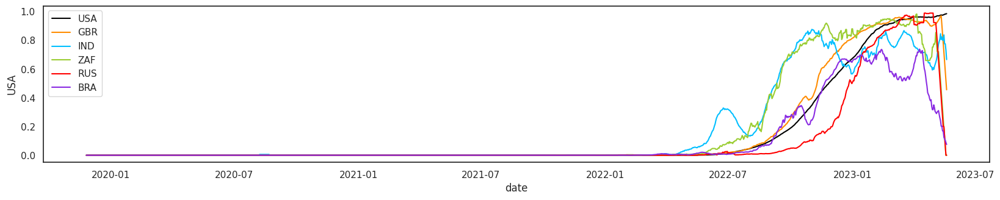

In [116]:
r346t = single_mut_glance_dry('S-R346T', _mut_date_dict, colordict, 15, True)
sns.set(rc={'figure.figsize':(20,3.33)})
sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)
for theiso in ['USA','GBR','IND','ZAF','RUS','BRA']:
    sns.lineplot(x = r346t['date'], y = r346t[theiso], color = colordict[theiso], label = theiso)
plt.show()

In [41]:
['S-A570D', 'S-S982A', 'S-P681H', 'S-T716I', 'S-N501Y', 'S-D1118H', 'S-D614G']

['S-A570D', 'S-S982A', 'S-P681H', 'S-T716I', 'S-N501Y', 'S-D1118H', 'S-D614G']

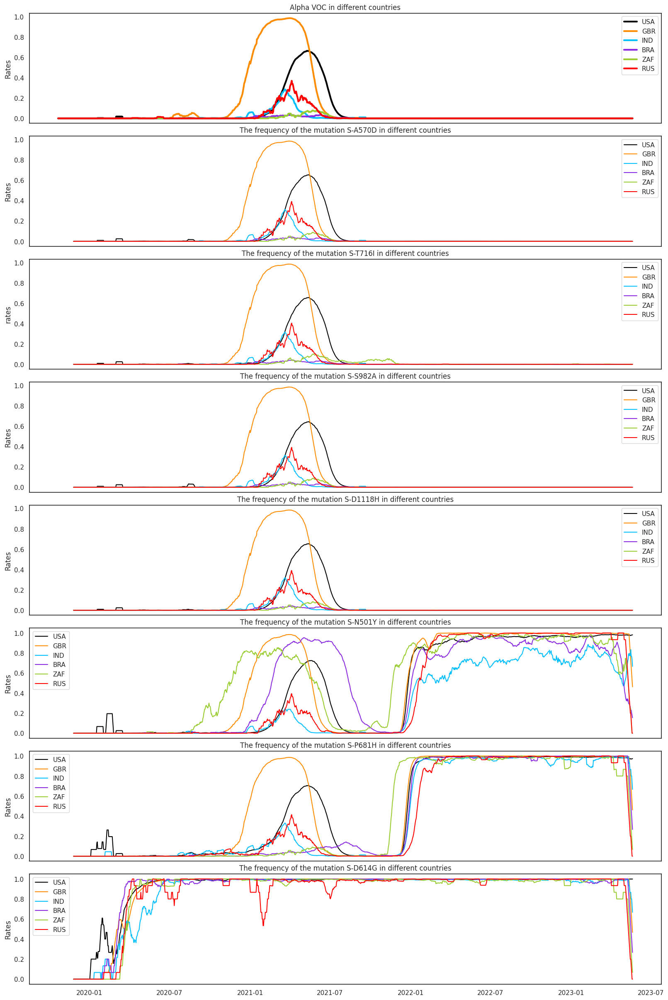

In [117]:
#mainly used

f, axes = plt.subplots(nrows=8, ncols=1,figsize=(16,24), sharey=False,sharex = True,layout="constrained")

ax0, ax1, ax2, ax3, ax4,ax5,ax6,ax7 = axes.flatten()

theax = ax0
df = usavocdf
theiso = 'USA'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = gbrvocdf
theiso = 'GBR'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = indvocdf
theiso = 'IND'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = bravocdf
theiso = 'BRA'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = zafvocdf
theiso = 'ZAF'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = rusvocdf
theiso = 'RUS'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
theax.set_ylabel("Rates")
theax.set_title('Alpha VOC in different countries')




mutname = 'S-A570D'
theax = ax1
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'S-T716I'
theax = ax2
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'S-S982A'
theax = ax3
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'S-D1118H'
theax = ax4
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'S-N501Y'
theax = ax5
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'S-P681H'
theax = ax6
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'S-D614G'
theax = ax7
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')
theax.set_xlabel("")

plt.savefig('lineage distinct mutations.png', dpi = 600)
plt.savefig('lineage distinct mutations.pdf', dpi = 600)
plt.savefig('lineage distinct mutations.svg', dpi = 600)
plt.show()
plt.close()

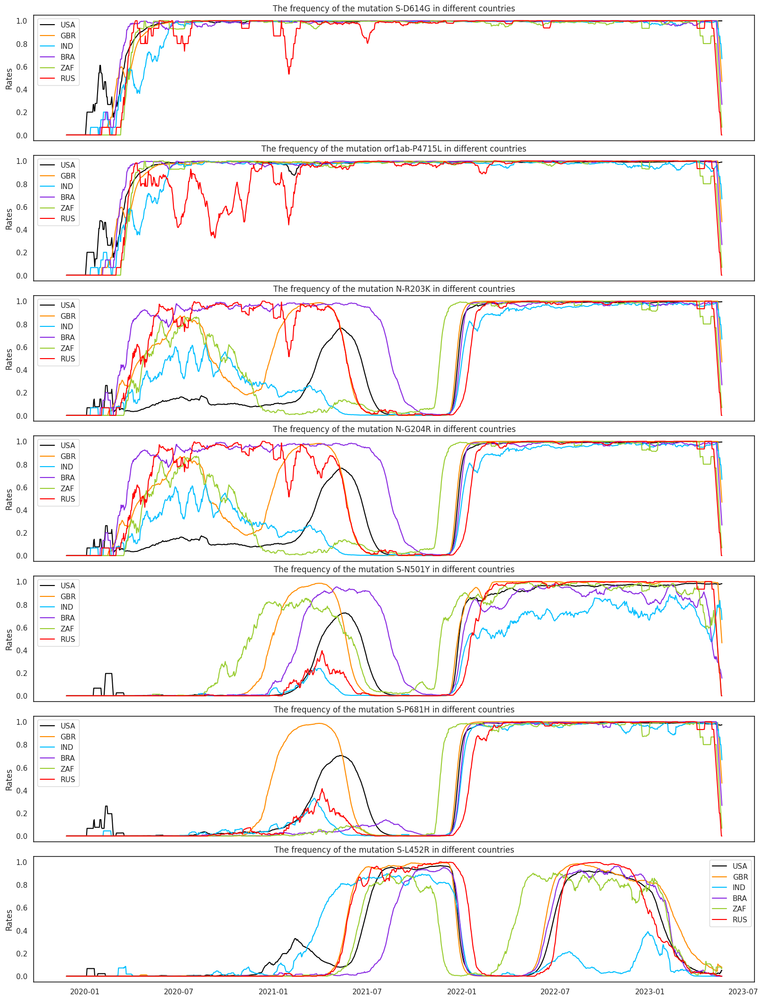

In [118]:
f, axes = plt.subplots(nrows=7, ncols=1,figsize=(16,21), sharey=False,sharex = True,layout="constrained")

ax1, ax2, ax3, ax4,ax5,ax6,ax7 = axes.flatten()

mutname = 'S-D614G'
theax = ax1
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'orf1ab-P4715L'
theax = ax2
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'N-R203K'
theax = ax3
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')

mutname = 'N-G204R'
theax = ax4
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')


mutname = 'S-N501Y'
theax = ax5
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')


mutname = 'S-P681H'
theax = ax6
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')


mutname = 'S-L452R'
theax = ax7
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries')
theax.set_xlabel("")

plt.savefig('long-span mutations.png', dpi = 600)
plt.savefig('long-span mutations.pdf', dpi = 600)
plt.savefig('long-span mutations.svg', dpi = 600)
plt.show()
plt.close()

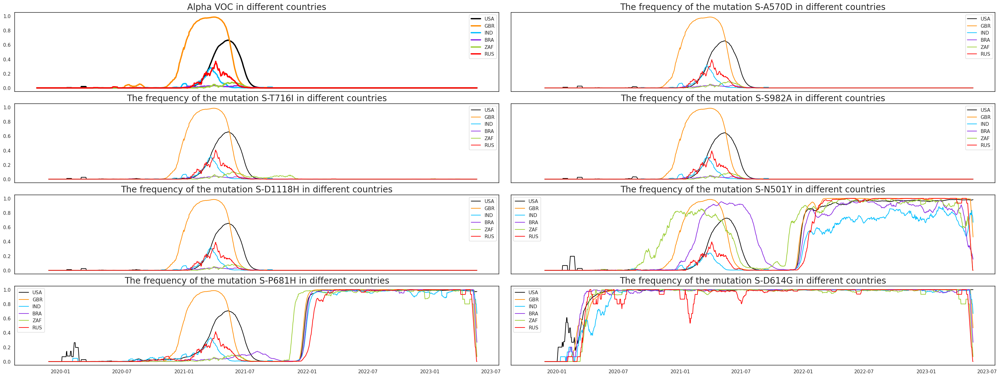

In [119]:
f, axes = plt.subplots(nrows=4, ncols=2,figsize=(32,12), sharey=True,sharex = True,layout="constrained")

ax0, ax1, ax2, ax3, ax4,ax5,ax6,ax7 = axes.flatten()
fontsize = 20
theax = ax0
df = usavocdf
theiso = 'USA'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = gbrvocdf
theiso = 'GBR'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = indvocdf
theiso = 'IND'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = bravocdf
theiso = 'BRA'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = zafvocdf
theiso = 'ZAF'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
df = rusvocdf
theiso = 'RUS'
sns.lineplot(x="date", y='Alpha',data=df, color = colordict[theiso], label = theiso,linewidth = 3, ax = ax0)
theax.set_ylabel("")
theax.set_title('Alpha VOC in different countries',fontsize = fontsize)




mutname = 'S-A570D'
theax = ax1
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for what in six_country:
    theiso = what
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'S-T716I'
theax = ax2
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for what in six_country:
    theiso = what
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'S-S982A'
theax = ax3
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for what in six_country:
    theiso = what
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'S-D1118H'
theax = ax4
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for what in six_country:
    theiso = what
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'S-N501Y'
theax = ax5
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for what in six_country:
    theiso = what
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'S-P681H'
theax = ax6
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for what in six_country:
    theiso = what
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)
theax.set_xlabel('')
mutname = 'S-D614G'
theax = ax7
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for what in six_country:
    theiso = what
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)
theax.set_xlabel('')
plt.savefig('lineage distinct mutations ppt.png', dpi = 600)
plt.show()

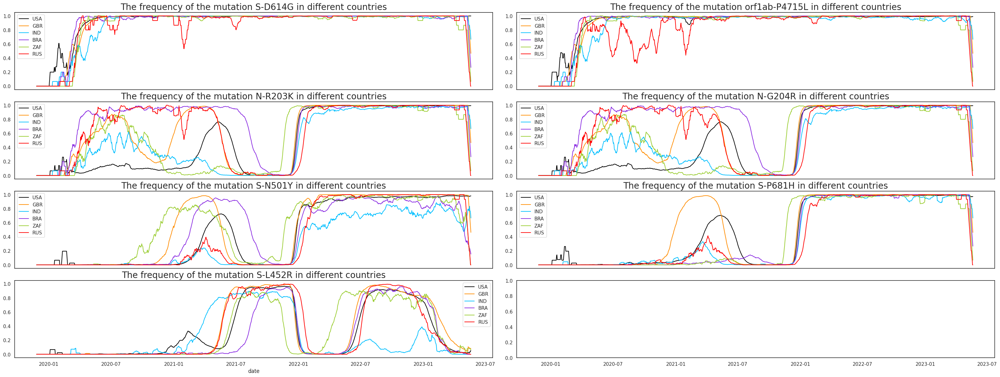

In [120]:
f, axes = plt.subplots(nrows=4, ncols=2,figsize=(32,12), sharey=False,sharex = True,layout="constrained")

ax1, ax2, ax3, ax4,ax5,ax6,ax7,ax8 = axes.flatten()

mutname = 'S-D614G'
theax = ax1
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'orf1ab-P4715L'
theax = ax2
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'N-R203K'
theax = ax3
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)

mutname = 'N-G204R'
theax = ax4
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)


mutname = 'S-N501Y'
theax = ax5
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)


mutname = 'S-P681H'
theax = ax6
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)


mutname = 'S-L452R'
theax = ax7
mutframe = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe['date'], y = mutframe[theiso], color = colordict[theiso], label = theiso)
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' in different countries',fontsize = fontsize)


plt.savefig('long-span mutations ppt.png', dpi = 600)
plt.show()
plt.close()

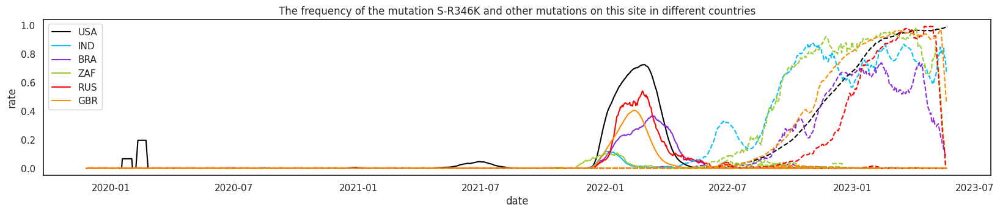

Done.


In [121]:
single_mut_glance_reverse('S-R346K', _mut_date_dict, colordict, 15, True)

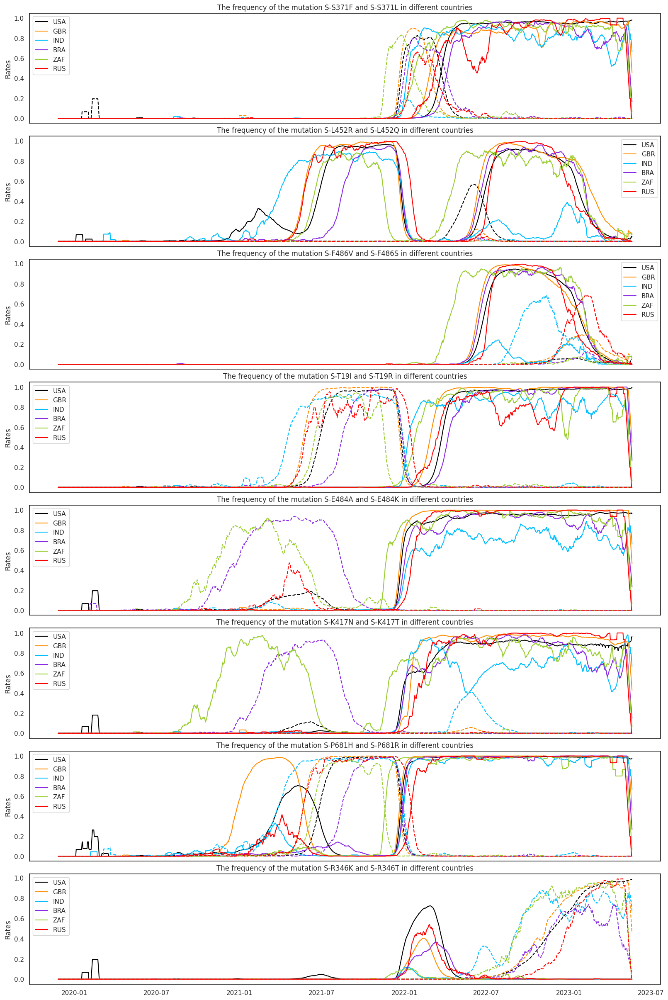

In [122]:
f, axes = plt.subplots(nrows=8, ncols=1,figsize=(16,24), sharey=False,sharex = True,layout="constrained")

ax1, ax2, ax3, ax4,ax5,ax6,ax7,ax8 = axes.flatten()

mutname = 'S-S371F'
mutname2 = mutname[:-1] + 'L'
theax = ax1
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')

mutname = 'S-L452R'
mutname2 = mutname[:-1] + 'Q'
theax = ax2
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')

mutname = 'S-F486V'
mutname2 = mutname[:-1] + 'S'
theax = ax3
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')

mutname = 'S-T19I'
mutname2 = mutname[:-1] + 'R'
theax = ax4
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')

mutname = 'S-E484A'
mutname2 = mutname[:-1] + 'K'
theax = ax5
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')

mutname = 'S-K417N'
mutname2 = mutname[:-1] + 'T'
theax = ax6
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')

mutname = 'S-P681H'
mutname2 = mutname[:-1] + 'R'
theax = ax7
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')

mutname = 'S-R346K'
mutname2 = mutname[:-1] + 'T'
theax = ax8
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linestyle="dashed")
theax.set_ylabel("Rates")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries')
theax.set_xlabel("")

plt.savefig('Competitive mutations.png', dpi = 600)
plt.savefig('Competitive mutations.pdf', dpi = 600)
plt.savefig('Competitive mutations.svg', dpi = 600)

plt.show()
plt.close()

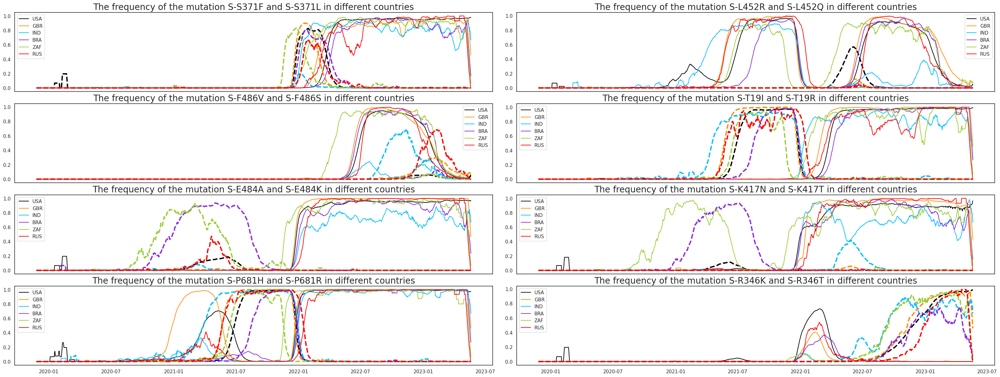

In [123]:
f, axes = plt.subplots(nrows=4, ncols=2,figsize=(32,12), sharey=False,sharex = True,layout="constrained")

ax1, ax2, ax3, ax4,ax5,ax6,ax7,ax8 = axes.flatten()

mutname = 'S-S371F'
mutname2 = mutname[:-1] + 'L'
theax = ax1
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-L452R'
mutname2 = mutname[:-1] + 'Q'
theax = ax2
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-F486V'
mutname2 = mutname[:-1] + 'S'
theax = ax3
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-T19I'
mutname2 = mutname[:-1] + 'R'
theax = ax4
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso],linewidth = 3, linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-E484A'
mutname2 = mutname[:-1] + 'K'
theax = ax5
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-K417N'
mutname2 = mutname[:-1] + 'T'
theax = ax6
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-P681H'
mutname2 = mutname[:-1] + 'R'
theax = ax7
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso],linewidth = 3, linestyle="dashed")
theax.set_ylabel("")
theax.set_xlabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-R346K'
mutname2 = mutname[:-1] + 'T'
theax = ax8
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)
theax.set_xlabel("")

plt.savefig('Competitive mutations ppt.png', dpi = 600)
plt.show()
plt.close()

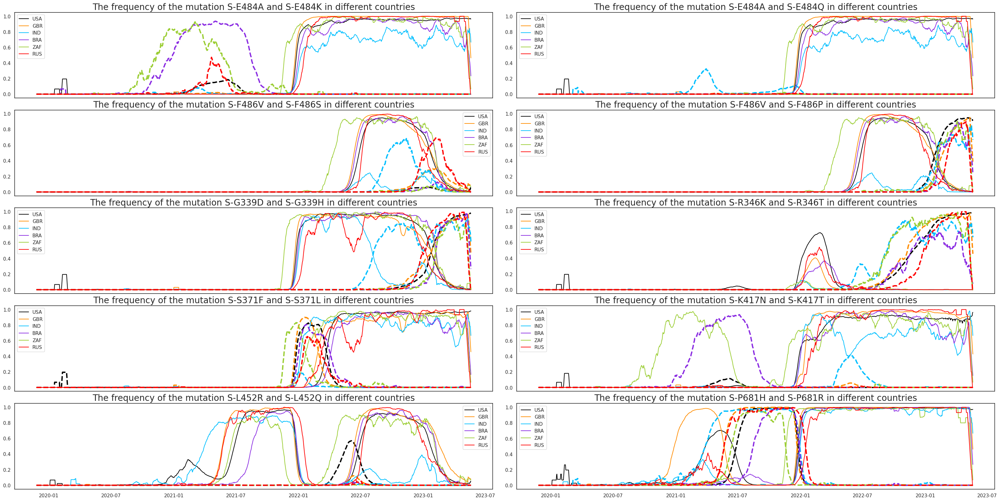

In [124]:
#加塞

f, axes = plt.subplots(nrows=5, ncols=2,figsize=(32,16), sharey=False,sharex = True,layout="constrained")

ax1, ax2, ax3, ax4,ax5,ax6,ax7,ax8, ax9, ax10 = axes.flatten()

mutname = 'S-E484A'
mutname2 = mutname[:-1] + 'K'
theax = ax1
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-E484A'
mutname2 = mutname[:-1] + 'Q'
theax = ax2
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-F486V'
mutname2 = mutname[:-1] + 'S'
theax = ax3
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-F486V'
mutname2 = mutname[:-1] + 'P'
theax = ax4
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso],linewidth = 3, linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-G339D'
mutname2 = mutname[:-1] + 'H'
theax = ax5
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-R346K'
mutname2 = mutname[:-1] + 'T'
theax = ax6
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-S371F'
mutname2 = mutname[:-1] + 'L'
theax = ax7
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso],linewidth = 3, linestyle="dashed")
theax.set_ylabel("")
theax.set_xlabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-K417N'
mutname2 = mutname[:-1] + 'T'
theax = ax8
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)
theax.set_xlabel("")

mutname = 'S-L452R'
mutname2 = mutname[:-1] + 'Q'
theax = ax9
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)
theax.set_xlabel("")

mutname = 'S-P681H'
mutname2 = mutname[:-1] + 'R'
theax = ax10
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)
theax.set_xlabel("")

plt.savefig('Competitive mutations ppt add.png', dpi = 600)
plt.show()
plt.close()

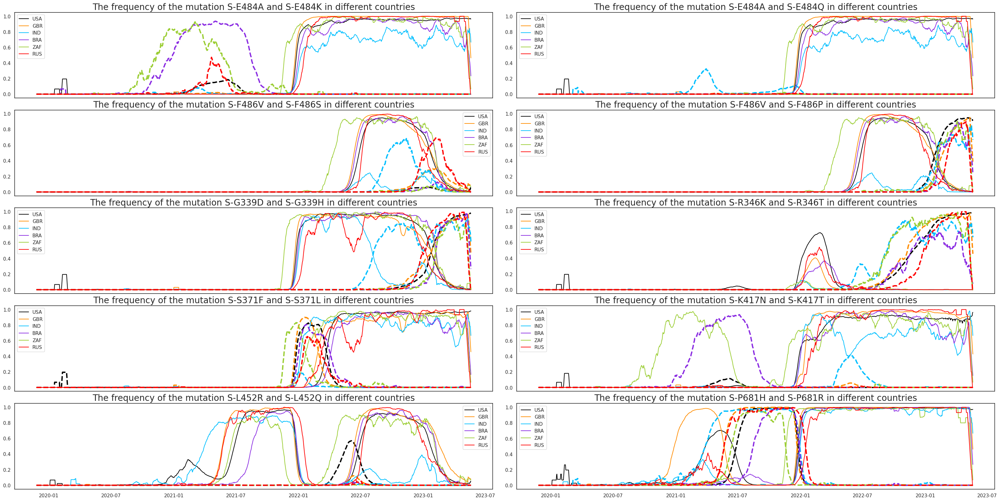

In [126]:
#加塞

f, axes = plt.subplots(nrows=5, ncols=2,figsize=(32,16), sharey=False,sharex = True,layout="constrained")

ax1, ax2, ax3, ax4,ax5,ax6,ax7,ax8, ax9, ax10 = axes.flatten()

mutname = 'S-E484A'
mutname2 = mutname[:-1] + 'K'
theax = ax1
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-E484A'
mutname2 = mutname[:-1] + 'Q'
theax = ax2
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-F486V'
mutname2 = mutname[:-1] + 'S'
theax = ax3
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-F486V'
mutname2 = mutname[:-1] + 'P'
theax = ax4
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso],linewidth = 3, linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-G339D'
mutname2 = mutname[:-1] + 'H'
theax = ax5
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-R346K'
mutname2 = mutname[:-1] + 'T'
theax = ax6
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-S371F'
mutname2 = mutname[:-1] + 'L'
theax = ax7
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso],linewidth = 3, linestyle="dashed")
theax.set_ylabel("")
theax.set_xlabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)

mutname = 'S-K417N'
mutname2 = mutname[:-1] + 'T'
theax = ax8
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)
theax.set_xlabel("")

mutname = 'S-L452R'
mutname2 = mutname[:-1] + 'Q'
theax = ax9
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)
theax.set_xlabel("")

mutname = 'S-P681H'
mutname2 = mutname[:-1] + 'R'
theax = ax10
mutframe1 = single_mut_glance_dry(mutname, _mut_date_dict, colordict, 15, True)
mutframe2 = single_mut_glance_dry(mutname2, _mut_date_dict, colordict, 15, True)
for theiso in six_country:
    #theiso = countrynametoiso[what]
    sns.lineplot(ax = theax, x = mutframe1['date'], y = mutframe1[theiso], color = colordict[theiso], label = theiso)
    sns.lineplot(ax = theax, x = mutframe2['date'], y = mutframe2[theiso], color = colordict[theiso], linewidth = 3,linestyle="dashed")
theax.set_ylabel("")
theax.set_title('The frequency of the mutation ' + mutname + ' and '+ mutname2 + ' in different countries',fontsize = fontsize)
theax.set_xlabel("")

plt.savefig('Competitive mutations ppt add2.png', dpi = 600)
plt.show()
plt.close()

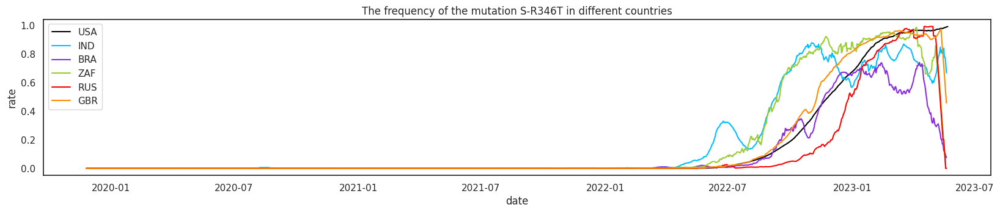

Done.


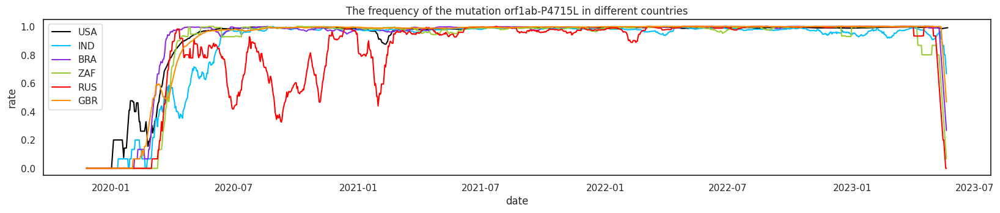

Done.


In [127]:
single_mut_glance('S-R346T', _mut_date_dict, colordict, 15, True)
single_mut_glance('orf1ab-P4715L', _mut_date_dict, colordict, 15, True)

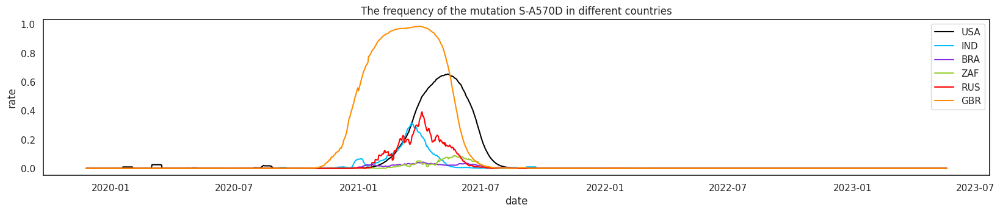

Done.


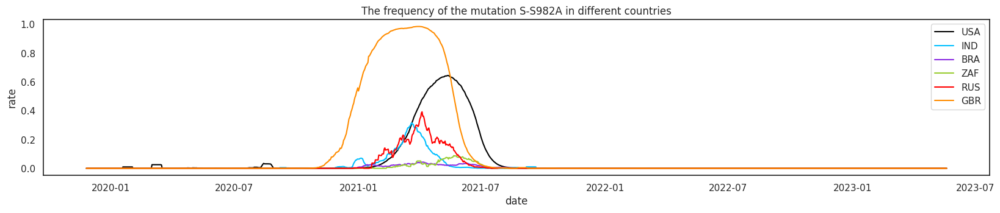

Done.


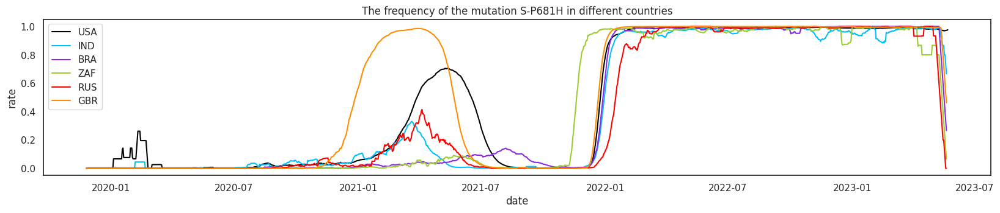

Done.


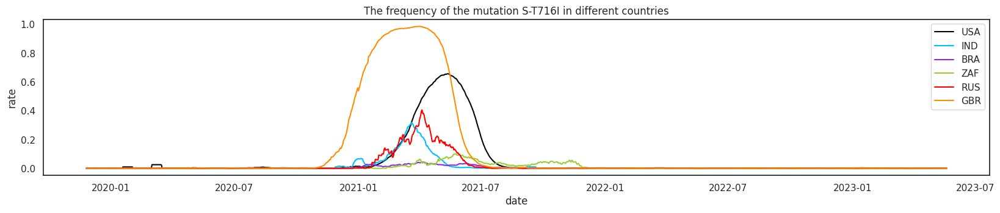

Done.


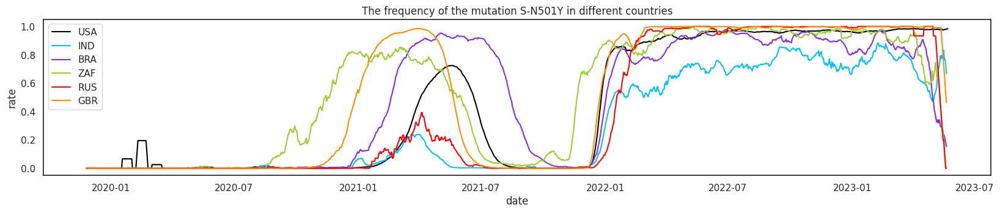

Done.


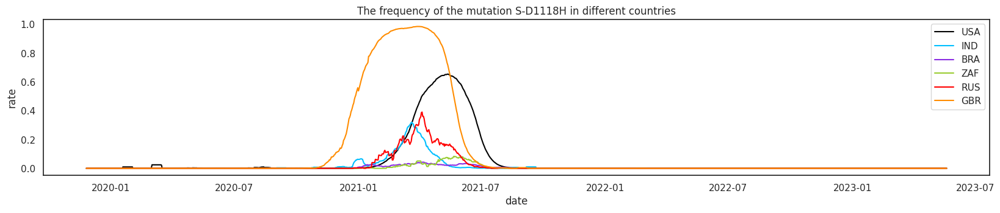

Done.


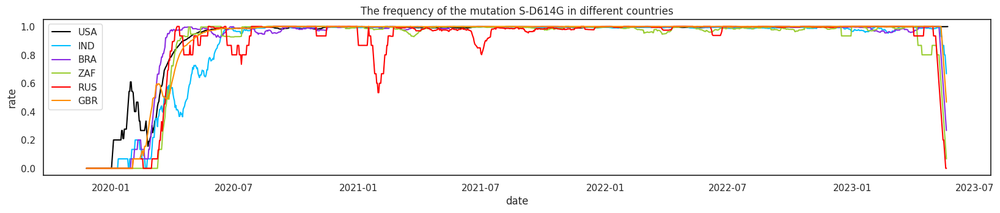

Done.


In [128]:
for what in ['S-A570D', 'S-S982A', 'S-P681H', 'S-T716I', 'S-N501Y', 'S-D1118H', 'S-D614G']:
    single_mut_glance(what, _mut_date_dict, colordict, 15, True)

In [61]:
dry1, dry2 = single_mut_glance_reverse_dry('S-P681H', _mut_date_dict, colordict, 15, True)

Done.


In [129]:
already = set()
for thevs in differentrate['BA.1']:
    aflag = False
    for themut in differentrate['BA.1'][thevs]:
        if themut.startswith('S'):
            aflag = True
        if aflag:
            print(thevs)
            for themut in differentrate['BA.1'][thevs]:
                if themut.startswith('S'):
                    if themut not in already:
                        print(themut)
                        print('True')
                        single_mut_glance(themut, _mut_date_dict, colordict, 15, True)
#                        print('False')
#                        single_mut_glance(themut, _mut_date_dict, colordict, 15, False)
                        already.add(themut)


KeyError: 'BA.1'

In [ ]:
 differentrate

In [ ]:
differentrate = differentrate_finder(result_pandemic_stage_strain, thres = 0.2)
already = set()
for thestrain in differentrate:
    print(thestrain)
    for thevs in differentrate[thestrain]:
        aflag = False
        for themut in differentrate[thestrain][thevs]:
            if themut.startswith('S'):
                aflag = True
        if aflag:
            print(thevs)
            print(differentrate[thestrain][thevs])
            for themut in differentrate[thestrain][thevs]:
                if themut.startswith('S'):
                    if themut not in already:
                        print(themut)
                        print('True')
                        single_mut_glance(themut, _mut_date_dict, colordict, 15, True)
                        single_mut_glance_reverse(themut, _mut_date_dict, colordict, 15, True)
                        #print('False')
                        #single_mut_glance(themut, _mut_date_dict, colordict, 15, True)
                        already.add(themut)


In [67]:
def all_iso(owidfile):
    iso = set()
    thefile = open(owidfile,'r')
    for theline in thefile:
        if theline.startswith('iso_code'):
            print(theline)
        else:
            aniso = theline.split(',')[0]
            iso.add(aniso)
    thefile.close()
    return iso

iso = all_iso(owid_file_path)

for what in iso:
    owidtmpfile(owid_file_path, what)

iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,total_tests,new_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundre

In [ ]:
result_pandemic_stage_strain

In [133]:
for thecountry in result_pandemic_stage_:
    for thestrain in result_pandemic_stage_[thecountry]:
        if result_pandemic_stage_[thecountry][thestrain]['themax'] is not None and result_pandemic_stage_[thecountry][thestrain]['themax'] < 0.5:
            print(thecountry, thestrain, result_pandemic_stage_[thecountry][thestrain]['themax'])

USA Beta 0.008650991290667256
USA Gamma 0.11841871097997166
USA BA.4 0.14330702985243088
USA BA.2.75 0.006544829990463442
USA XBB.1.16 0.13791705249542513
USA XBB.1.9.1 0.10107827100269182
RUS Alpha 0.36939297732989124
RUS Beta 0.05437111923483516
RUS Gamma 0.006666666666666667
RUS BA.4 0.033491099821909655
RUS BA.2.12.1 0.050437827507213165
RUS BA.2.75 0.009685519667340296
RUS XBB.1.5 0.22552826400652487
RUS XBB.1.16 0.0013333333333333333
BRA Alpha 0.03442893720325155
BRA Beta 0.002966069173513099
BRA BA.4 0.22464882087859891
BRA BA.2.12.1 0.03668595449343803
BRA BA.2.75 0.008333333333333333
BRA XBB.1.16 0.011000000000000001
BRA XBB.1.9.1 0.015143939393939395
ZAF Alpha 0.07815114962005891
ZAF Gamma 0.002821869488536155
ZAF BA.2.12.1 0.006604506604506605
ZAF BA.2.75 0.01111111111111111
ZAF XBB.1.16 0.03754208754208754
ZAF XBB.1.9.1 0.16296296296296298
IND Alpha 0.2844933297442039
IND Beta 0.014847796359392816
IND Gamma 0.00040356288374506356
IND Omicron 0.33448224241759184
IND BA.4 0.0

In [70]:
from multiprocessing import Pool, Process, Manager
import os
import copy
import requests
import time



time_begin = time.time()

p = Pool(6)

p.apply_async(voc_caller, args = ('USA', Alias, dis_lineage_date_['USA'], 15, ))
p.apply_async(voc_caller, args = ('RUS', Alias, dis_lineage_date_['RUS'], 15, ))
p.apply_async(voc_caller, args = ('BRA', Alias, dis_lineage_date_['BRA'], 15, ))
p.apply_async(voc_caller, args = ('ZAF', Alias, dis_lineage_date_['ZAF'], 15, ))
p.apply_async(voc_caller, args = ('IND', Alias, dis_lineage_date_['IND'], 15, ))
p.apply_async(voc_caller, args = ('GBR', Alias, dis_lineage_date_['GBR'], 15, ))
        
p.close()
p.join()
timer_server(time_begin, 'Multi voc caller Done')

Done.
Done.
Done.
Done.
Done.
Done.
Done.


In [71]:
conversion_readable('S.484.gca')
for what in unic['Omicron']:
    print(what, conversion_readable(what))

'S-E484A'

In [134]:
def glance(mut, _mut_date_):
    #print(mut)
    test_dfb = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
    test_dfb.date = pd.to_datetime(test_dfb.date)
    
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    sns.set(rc={'figure.figsize':(30,5)})
    # Plot the responses for different events and regions
    sns.lineplot(x="date", y="rate",data=test_dfb)


In [135]:
def glance2(mut, _mut_date_, thecountry):
    global nation_date_casesum_
    #print(mut)
    test_dfb = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
    test_dfb.date = pd.to_datetime(test_dfb.date)
    
    test_dfa = pd.DataFrame.from_dict(nation_date_casesum_[thecountry], orient = 'index', columns = ['num']).reindex(formtimeseq(nation_date_casesum_[thecountry])) 
    test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
    test_dfa.date = pd.to_datetime(test_dfa.date)
    
    for index,row in test_dfb.iterrows():
        if test_dfb.loc[index, 'rate'] >= 0.2 and test_dfa.loc[index, 'num'] <= 10:
            test_dfb.loc[index, 'rate'] = 0
        elif test_dfb.loc[index, 'rate'] >= 0.8 and test_dfa.loc[index, 'num'] <= 200:
            test_dfb.loc[index, 'rate'] = 0
    
    
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    sns.set(rc={'figure.figsize':(30,5)})
    # Plot the responses for different events and regions
    sns.lineplot(x="date", y="rate",data=test_dfb)


In [136]:
def glance3(window, mut, _mut_date_, thecountry):
    global nation_date_casesum_
    #print(mut)
    test_dfb = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
    test_dfb.date = pd.to_datetime(test_dfb.date)
    
    test_dfa = pd.DataFrame.from_dict(nation_date_casesum_[thecountry], orient = 'index', columns = ['num']).reindex(formtimeseq(nation_date_casesum_[thecountry])) 
    test_dfa = test_dfa.reset_index().rename(columns = {'index':'date'})
    test_dfa.date = pd.to_datetime(test_dfa.date)
    
    for index,row in test_dfb.iterrows():
        if test_dfb.loc[index, 'rate'] >= 0.2 and test_dfa.loc[index, 'num'] <= 10:
            test_dfb.loc[index, 'rate'] = 0
    #    elif test_dfb.loc[index, 'rate'] >= 0.8 and test_dfa.loc[index, 'num'] <= 200:
    #        test_dfb.loc[index, 'rate'] = 0
    
    
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    #sns.set(rc={'figure.figsize':(30,5)})
    # Plot the responses for different events and regions
    #sns.lineplot(x="date", y="rate",data=test_dfb)
    print(mut)
    plotMovingAverage2(mut, test_dfb['rate'], window, True, True)
    

In [139]:
def nation_date_casesum(country_date_id_, data_update_date):
    nation_date_casesum_ = {}
    for thecountry in country_date_id_:
        if thecountry not in nation_date_casesum_:
            nation_date_casesum_[thecountry] = {}
        fulldate = datefiller('2019-10-22', data_update_date)
        for thedate in fulldate:
            if thedate not in country_date_id_[thecountry]:
                nation_date_casesum_[thecountry][thedate] = 0
            else:
                nation_date_casesum_[thecountry][thedate] = len(country_date_id_[thecountry][thedate])
    return nation_date_casesum_

nation_date_casesum_ = nation_date_casesum(new_country_date_id_, data_update_date)

In [140]:
#check the countries' data, 'thres' is a mut's accumulative number

def national_glance(thecountry, country_mut_sum_, thres):
    #print(thecountry)
    temp = []
    aa = 0
    for what in country_mut_sum_[thecountry]:
        if country_mut_sum_[thecountry][what] >= thres:
            temp.append(what)
            aa += 1
    #print(aa)
    return temp

France = national_glance('France', country_mut_sum_, 100)

#for thecountry in country_mut_sum_:
#    national_glance(thecountry, country_mut_sum_, 1000)

In [141]:
#country_date_mut_['China']
#country_date_mut_proportion_['China']

In [142]:
def grey_finder(country_date_mut_proportion_, thecountry, thres, unic, date):
    results = []
    allunic = set()
    for what in unic:
        for allmut in unic[what]:
            allunic.add(allmut)
            
    for themut in country_date_mut_proportion_[thecountry][date]:
        if themut not in allunic:
            if country_date_mut_proportion_[thecountry][date][themut] >= thres:
                results.append(themut)
    print(results)
    return results

ukgrey = grey_finder(country_date_mut_proportion_, 'United Kingdom of Great Britain and Northern Ireland (the)', 0.05, unic, '2021-12-01')

['orf1ab.5086.tat', 'orf1ab.2529.gtt', 'S.145.cac', 'S.222.gtt', 'orf1ab.2857.gcc', 'S.1264.ctg', 'N.9.ctg', 'orf1ab.5230.ata']


In [143]:
def bulk_finder(country_date_mut_proportion_, thecountry, thres, date):
    results = {}

            
    for themut in country_date_mut_proportion_[thecountry][date]:
        if country_date_mut_proportion_[thecountry][date][themut] >= thres:
            results[themut] = country_date_mut_proportion_[thecountry][date][themut]
    print([(what, conversion_readable(what), results[what])for what in results])
    return results
print('zaf')
zafbulk = bulk_finder(country_date_mut_proportion_, 'South Africa', 0.50,'2020-07-01')

print('rus')
rusbulk = bulk_finder(country_date_mut_proportion_, 'Russian Federation (the)', 0.50,'2020-06-01')

print('ind')
indbulk = bulk_finder(country_date_mut_proportion_, 'India', 0.30,'2020-06-01')

print('bra')
brabulk = bulk_finder(country_date_mut_proportion_, 'Brazil', 0.70,'2020-06-05')

print('gbr')
gbrbulk = bulk_finder(country_date_mut_proportion_, 'United Kingdom of Great Britain and Northern Ireland (the)', 0.50,'2020-07-01')

print('usa')
usabulk = bulk_finder(country_date_mut_proportion_, 'United States of America (the)', 0.60,'2020-06-01')

zaf
[('N.204.cga', 'N-G204R', 0.7758620689655172), ('orf1ab.4715.ctt', 'orf1ab-P4715L', 1.0), ('N.203.aaa', 'N-R203K', 0.7758620689655172), ('S.614.ggt', 'S-D614G', 1.0)]
rus
[('N.204.cga', 'N-G204R', 0.9230769230769231), ('orf1ab.4715.ctt', 'orf1ab-P4715L', 0.8461538461538461), ('N.203.aaa', 'N-R203K', 0.9230769230769231), ('S.614.ggt', 'S-D614G', 1.0)]
ind
[('orf1ab.4715.ctt', 'orf1ab-P4715L', 0.6893617021276596), ('S.614.ggt', 'S-D614G', 0.6936170212765957), ('N.204.cga', 'N-G204R', 0.3276595744680851), ('N.203.aaa', 'N-R203K', 0.33191489361702126)]
bra
[('N.204.cga', 'N-G204R', 0.7142857142857143), ('orf1ab.4715.ctt', 'orf1ab-P4715L', 0.9285714285714286), ('ORF6.33.aca', 'ORF6-I33T', 0.75), ('N.203.aaa', 'N-R203K', 0.7142857142857143), ('S.614.ggt', 'S-D614G', 0.8214285714285714), ('N.292.acc', 'N-I292T', 0.7857142857142857)]
gbr
[('orf1ab.4715.ctt', 'orf1ab-P4715L', 0.9865470852017937), ('S.614.ggt', 'S-D614G', 1.0), ('N.204.cga', 'N-G204R', 0.8834080717488789), ('N.203.aaa', 'N-R

In [144]:
for what in ukgrey:
    print(conversion_readable(what))


orf1ab-F5086Y
orf1ab-A2529V
S-Y145H
S-A222V
orf1ab-V2857A
S-V1264L
N-Q9L
orf1ab-L5230I


In [145]:
nation_mostprevalent_mutlist_v2 = national_glance_temporal_v2(country_date_mut_proportion_, 5, 0.2)

Done.


In [146]:
long_span_test = national_glance_temporal_v2(country_date_mut_proportion_, 100, 0.7)

Done.


In [147]:
long_span_test[list(long_span_test)[0]][0]

'S.614.ggt'

In [149]:
printset = set()
for what in long_span_test['United States of America (the)']:
    printset.add(conversion_readable(what))
print(printset)

{'S-T19I', 'orf1ab-G1307S', 'S-D796Y', 'S-G142D', 'S-G339H', 'orf1ab-P2046L', 'S-P681H', 'ORF6-D61L', 'S-G339D', 'ORF7a-V82A', 'S-V83A', 'S-K417N', 'orf1ab-P3395H', 'S-Q498R', 'S-G446S', 'orf1ab-P4715L', 'N-R203M', 'S-N440K', 'orf1ab-G5063S', 'orf1ab-L3201F', 'S-R346T', 'E-T9I', 'N-G204R', 'orf1ab-P5401L', 'S-F486P', 'S-S477N', 'S-L452R', 'S-Q493R', 'orf1ab-V2930L', 'M-D3N', 'S-Y505H', 'S-S375F', 'orf1ab-T3090I', 'S-Q183E', 'N-R203K', 'orf1ab-S5360P', 'ORF3a-S26L', 'orf1ab-T3646A', 'orf1ab-T3255I', 'orf1ab-A6319V', 'S-N969K', 'N-G215C', 'S-H655Y', 'S-D405N', 'N-D377Y', 'S-N501Y', 'S-N679K', 'S-N764K', 'M-Q19E', 'N-S413R', 'orf1ab-L3027F', 'S-D614G', 'S-P681R', 'orf1ab-R5716C', 'S-F486V', 'M-A63T', 'orf1ab-T6564I', 'S-R408S', 'orf1ab-S135R', 'S-L368I', 'S-T478K', 'S-V445P', 'S-D950N', 'S-V213G', 'ORF7a-T120I', 'S-E484A', 'orf1ab-A1306S', 'ORF3a-Q57H', 'S-V213E', 'S-S373P', 'orf1ab-I5967V', 'S-N460K', 'ORF3a-T223I', 'orf1ab-P2287S', 'E-T11A', 'N-D63G', 'S-T376A', 'orf1ab-K47R', 'S-T19R',

In [150]:
nation_mostprevalent_mutlist_v2_2 = national_glance_temporal_v2(country_date_mut_proportion_, 2, 0.1)

Done.


In [151]:
ourlist = ['United States of America (the)','India','United States of America (the)','Russian Federation (the)','Brazil','South Africa','China']

In [152]:
for thecountry in ourlist:
    print(thecountry, len(nation_mostprevalent_mutlist_v2[thecountry]))

United States of America (the) 151
India 184
United States of America (the) 151
Russian Federation (the) 225
Brazil 158
South Africa 184
China 340


In [153]:
for thecountry in ourlist:
    print(thecountry, len(nation_mostprevalent_mutlist_v2_2[thecountry]))

United States of America (the) 271
India 640
United States of America (the) 271
Russian Federation (the) 1151
Brazil 430
South Africa 895
China 3928


In [154]:
all_selected_muts = list(set(nation_mostprevalent_mutlist_v2_2['United States of America (the)']) |set(nation_mostprevalent_mutlist_v2_2['Brazil']) | set(nation_mostprevalent_mutlist_v2_2['India']) | set(nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'])|set(nation_mostprevalent_mutlist_v2_2['South Africa'])| set(nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)']) )

In [ ]:
time_begin = time.time()
errrmut = []
donemut = set()
for themut in all_selected_muts:
    try:
        single_mut_glance(conversion_readable(themut), _mut_date_dict, colordict, 15, True)
        single_mut_glance_reverse(conversion_readable(themut), _mut_date_dict, colordict, 15, True)
        donemut.add(themut)
    except (KeyError, IndexError):
        errrmut.append(themut)

timer_server(time_begin, 'Drawing All Done')

In [89]:
#mainly used
time_begin = time.time()

t = 6

p = Pool(t)
p.apply_async(output_mutations_country, args = ('owidshrink/USA.csvmodi.csv',unic, 'USA', nation_mostprevalent_mutlist_v2_2['United States of America (the)'], USA_mut_date_, 15,'2', ))
p.apply_async(output_mutations_country, args = ('owidshrink/BRA.csvmodi.csv',unic, 'BRA', nation_mostprevalent_mutlist_v2_2['Brazil'], BRA_mut_date_, 30,'2', ))
p.apply_async(output_mutations_country, args = ('owidshrink/IND.csvmodi.csv',unic, 'IND', nation_mostprevalent_mutlist_v2_2['India'], IND_mut_date_, 40,'2', ))
p.apply_async(output_mutations_country, args = ('owidshrink/RUS.csvmodi.csv',unic, 'RUS', nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'], RUS_mut_date_, 55,'2', ))
p.apply_async(output_mutations_country, args = ('owidshrink/ZAF.csvmodi.csv',unic, 'ZAF', nation_mostprevalent_mutlist_v2_2['South Africa'], ZAF_mut_date_, 45,'2', ))
p.apply_async(output_mutations_country, args = ('owidshrink/GBR.csvmodi.csv',unic, 'GBR', nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)'], GBR_mut_date_, 15,'2', ))


p.close()
p.join()
timer_server(time_begin, 'Drawing All Done')

NameError: name 'output_mutations_country' is not defined

In [92]:
for thecountry in nation_mostprevalent_mutlist_v2_1:
    print(thecountry, len(nation_mostprevalent_mutlist_v2_1[thecountry]))

NameError: name 'nation_mostprevalent_mutlist_v2_1' is not defined

In [93]:
#1919
USA = national_glance('United States of America (the)', country_mut_sum_, 1919)
BRA = national_glance('Brazil', country_mut_sum_, 90)
RUS = national_glance('Russian Federation (the)', country_mut_sum_, 12)
ZAF = national_glance('South Africa', country_mut_sum_, 12)
IND = national_glance('India', country_mut_sum_, 134)
GBR = national_glance('United Kingdom of Great Britain and Northern Ireland (the)', country_mut_sum_, 134)

In [94]:
#1919
USA2 = national_glance('United States of America (the)', country_mut_sum_, 2372)
BRA2 = national_glance('Brazil', country_mut_sum_, 111)
RUS2 = national_glance('Russian Federation (the)', country_mut_sum_, 22)
ZAF2 = national_glance('South Africa', country_mut_sum_, 22)
IND2 = national_glance('India', country_mut_sum_, 250)
GBR2 = national_glance('United Kingdom of Great Britain and Northern Ireland (the)', country_mut_sum_, 1724)

In [95]:
def glance_1(mut, _mut_date_, day):
    #print(mut)
    test_dfb = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
    test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
    test_dfb.date = pd.to_datetime(test_dfb.date)
    test_dfb['rate'] = test_dfb['rate'].rolling(day).mean()
    
    #test_dfb = test_dfb[100:]
    #sns.set_theme(style="darkgrid")
    sns.set(rc={'figure.figsize':(30,5)})
    # Plot the responses for different events and regions
    sns.lineplot(x="date", y="rate",data=test_dfb)

In [97]:
type(USA_mut_date_)

dict

In [98]:
def glance_output(countryname, mutlist, _mut_date_, day):
    time_begin = time.time()
    #sns.set_theme(style="darkgrid")
    sns.set(rc={'figure.figsize':(30,5)})
    for mut in mutlist:
        if mut in _mut_date_:
            test_dfb = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
            test_dfb = test_dfb.reset_index().rename(columns = {'index':'date'})
            test_dfb.date = pd.to_datetime(test_dfb.date)
            test_dfb['rate'] = test_dfb['rate'].rolling(day).mean()
            sns.lineplot(x="date", y="rate",data=test_dfb)
    plt.title('The frequency of the most dominating mutations in ' + countryname)
    plt.savefig(countryname + ' freq_color.png', dpi = 300)
    plt.close('all')
    timer_server(time_begin, countryname + 'glance_output Done')

In [100]:
def glance_output_pre(csvmodifile, unic, countryname, mutlist, _mut_date_, day):
    sns.set(rc={'figure.figsize':(20,3.33)})
    plt.figure(figsize=(20,3.33))
    #plt.title('test')
    plt.xlabel("Date")
    plt.ylabel("Rate")
    
    df1 = pd.DataFrame.from_dict(_mut_date_[list(mutlist)[0]], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[list(mutlist)[0]]))
    df1 = df1.reset_index().rename(columns = {'index':'date'})
    df1.date = pd.to_datetime(df1.date)
    df2 = pd.read_csv(csvmodifile)
    df2['date'] = pd.to_datetime(df2.thedate)
    result = pd.merge(df1, df2, how='left', on=['date'])
    population = np.argmax(np.bincount(df2.population.tolist()))
    print(population)
    result[['total_cases']] = pd.DataFrame(listsmoother(result['total_cases'].values.tolist()))
    result[['people_vaccinated']] = pd.DataFrame(listsmoother(result['people_vaccinated'].values.tolist()))
    result[['people_fully_vaccinated']] = pd.DataFrame(listsmoother(result['people_fully_vaccinated'].values.tolist()))
    plt.fill_between(result.date, result.total_cases / population, 0, alpha = 1, color = 'r',label = 'total cases')
    plt.fill_between(result.date, result.people_fully_vaccinated / population, result.total_cases / population, alpha = 0.2,color = 'magenta', label = '2st dose')
    plt.fill_between(result.date, result.people_vaccinated / population, result.people_fully_vaccinated / population,color = 'blue', alpha = 0.2, label = '1st dose')


In [101]:
def glance_output_aft(csvmodifile, unic, countryname, mutlist, _mut_date_, day):
    sns.set(rc={'figure.figsize':(20,3.33)})
    plt.figure(figsize=(20,3.33))
    #plt.title('test')
    plt.xlabel("Date")
    plt.ylabel("Rate")
    
    df1 = pd.DataFrame.from_dict(_mut_date_[list(mutlist)[0]], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[list(mutlist)[0]]))
    df1 = df1.reset_index().rename(columns = {'index':'date'})
    df1.date = pd.to_datetime(df1.date)
    df2 = pd.read_csv(csvmodifile)
    df2['date'] = pd.to_datetime(df2.thedate)
    #df2[['total_cases']] = pd.DataFrame(listsmoother(df2['total_cases'].values.tolist()))
    #df2[['people_vaccinated']] = pd.DataFrame(listsmoother(df2['people_vaccinated'].values.tolist()))
    #df2[['people_fully_vaccinated']] = pd.DataFrame(listsmoother(df2['people_fully_vaccinated'].values.tolist()))
    result = pd.merge(df1, df2, how='left', on=['date'])
    population = np.argmax(np.bincount(df2.population.tolist()))
    max_new_cases = np.nanmax(df2.new_cases_smoothed.tolist())
    print(population)
    print(max_new_cases)
    result[['new_cases_smoothed']] = pd.DataFrame(listsmoother(result['new_cases_smoothed'].values.tolist()))
    plt.fill_between(result.date, result.new_cases_smoothed / max_new_cases, 0, alpha = 0.4, color = 'r',label = 'total cases')

In [102]:
len(USA)

1415

In [104]:
def vocdef(thelineage, idlist, new_id_mut_):
    import numpy as np
    time_begin = time.time()
    #comp_dict[id] = {mut1, mut2}
    comp_dict = {}
    
    small_dict = {}
    count_dict = {}
    err = []
    #lengths of the sets
    alist = []
    
    finallist = []
    for what in idlist:
        try:
            comp_dict[what] = set(new_id_mut_[what])
            alist.append(len(new_id_mut_[what]))
        except KeyError:
            err.append(what)
            
    counts = np.bincount(alist)
    
    #length of the voc should be
    maybe = np.argmax(counts)
    #print(maybe)
    
    for what in comp_dict:
        if len(comp_dict[what]) == maybe:
            #possible symbols
            small_dict[what] = comp_dict[what]

    smalllist = list(small_dict)
    for i in range(len(smalllist)):
        theid = smalllist[i]
        thesum = 0
        if i+1 < len(list(small_dict)):
            for j in range(i+1, len(list(small_dict))):
                theid2 = smalllist[j]
                if small_dict[theid] == small_dict[theid2]:
                    thesum += 1
        count_dict[theid] = thesum
            
    listb = list(count_dict.values())
    for what in count_dict:
        if count_dict[what] == max(listb):
            finallist.append(what)
    rep = finallist[0]
    writef = open('represent/' + thelineage + '.txt', 'w')
    writef.write(thelineage + ',' + str(len(idlist))+','+ rep+',' + str(maybe))
    writef.close()
    timer_server(time_begin, thelineage + ' Done')

In [105]:
import math

def sort_by_value(d): 
    items=d.items() 
    backitems=[[v[1],v[0]] for v in items] 
    backitems.sort() 
    return [ backitems[i][1] for i in range(0,len(backitems))] 

time_begin = time.time()
lineage_dict = {}
counter_dict = {}
for what in metadict:
    lineage = metadict[what]['Lineage']
    if lineage not in lineage_dict:
        lineage_dict[lineage] = []
    lineage_dict[lineage].append(what)
    
print(len(lineage_dict))
for what in lineage_dict:
    counter_dict[what] = len(lineage_dict[what])
    
vocorderlist = sort_by_value(counter_dict)

timer_server(time_begin, 'All Done')

2764
Done.


In [159]:
len(lineage_dict['XBB.1.5'])

189870

In [160]:
len(lineagedict['XBB.1.5'])

189870

In [ ]:
#do not run this
time_begin = time.time()
t = 200
p = Pool(t)
for thelineage in vocorderlist[0:200]:
    p.apply_async(vocdef, args = (thelineage, lineage_dict[thelineage], new_id_mut_,))
p.close()
p.join()
timer_server(time_begin, str(aaaa) + ' Done')

In [ ]:
#do not run this
lensum = len(vocorderlist)
t = 200
batches = math.ceil(lensum/t)
print(batches)
for i in range(batches):
    if (i + 1) * t < lensum:
        aaaa = i * t
        bbbb = (i + 1) * t
    else:
        aaaa = i * t
        bbbb = lensum
    p = Pool(t)
    for thelineage in vocorderlist[aaaa:bbbb]:
        p.apply_async(vocdef, args = (thelineage, lineage_dict[thelineage], new_id_mut_,))
    p.close()
    p.join()
    timer_server(time_begin, str(aaaa) + ' Done')

In [41]:
testlist = ['orf1ab.3352.ttt', 'orf1ab.2606.ata', 'N.67.tct', 'orf1ab.6054.gat', 'ORF8.67.ttt', 'orf1ab.7014.tgc', 'ORF3a.57.cat', 'N.199.cta', 'orf1ab.4715.ctt', 'S.677.cat', 'orf1ab.265.atc', 'N.377.tat', 'ORF3a.172.gtt', 'ORF8.24.tta', 'S.614.ggt', 'ORF3a.108.ttt', 'ORF7a.14.att', 'N.194.tta', 'ORF3a.155.tac', 'S.501.act', 'orf1ab.935.ggt', 'orf1ab.7034.tca', 'orf1ab.989.gtt', 'N.206.ttt', 'orf1ab.2980.ggt', 'ORF8.65.gtt', 'orf1ab.1912.gtt', 'S.138.tat', 'orf1ab.3353.agg', 'ORF3a.62.acc']

In [42]:
testlist = ['orf1ab.3352.ttt', 'orf1ab.2606.ata', 'N.67.tct', 'orf1ab.6054.gat', 'ORF8.67.ttt', 'orf1ab.7014.tgc', 'ORF3a.57.cat', 'N.199.cta', 'orf1ab.4715.ctt', 'S.677.cat', 'orf1ab.265.atc', 'N.377.tat', 'ORF3a.172.gtt', 'ORF8.24.tta', 'S.614.ggt', 'ORF3a.108.ttt', 'ORF7a.14.att', 'N.194.tta', 'ORF3a.155.tac', 'S.501.act', 'orf1ab.935.ggt', 'orf1ab.7034.tca', 'orf1ab.989.gtt', 'N.206.ttt', 'orf1ab.2980.ggt', 'ORF8.65.gtt', 'orf1ab.1912.gtt', 'S.138.tat', 'orf1ab.3353.agg', 'ORF3a.62.acc']
#vocplate = {'Alpha':'palegreen','Beta':'aquamarine','Delta':'dodgerblue','Gamma':'darkorange','Omicron':'darkblue','BA.2':'sienna','BA.2.12.1':'orangered',"BA.2.75":'forestgreen','BA.4':'yellow','BA.5':'hotpink'}
import math
def just_my_dot(astr):
    while astr[-1] != '.':
        astr = astr[:-1]
    return astr[:-1]

def which_color(mut, vocplate, unic, default_color):
    for thevoc in list(vocplate):
        if mut.count('.') != 2:
            mut = just_my_dot(mut)
        if mut not in ['S.614.ggt', 'orf1ab.4715.ctt', 'N.204.cga', 'N.203.aaa']:
            if mut in unic[thevoc]:
                return vocplate[thevoc]            
        
    return default_color
            


[<matplotlib.collections.PolyCollection object at 0x7f2029c4af40>, <matplotlib.collections.PolyCollection object at 0x7f2029766460>, <matplotlib.collections.PolyCollection object at 0x7f20297700d0>, <matplotlib.collections.PolyCollection object at 0x7f20311841c0>, <matplotlib.lines.Line2D object at 0x7f20311fe6d0>, <matplotlib.lines.Line2D object at 0x7f20311fe5e0>, <matplotlib.lines.Line2D object at 0x7f20f922ec70>, <matplotlib.lines.Line2D object at 0x7f20311ee7f0>]


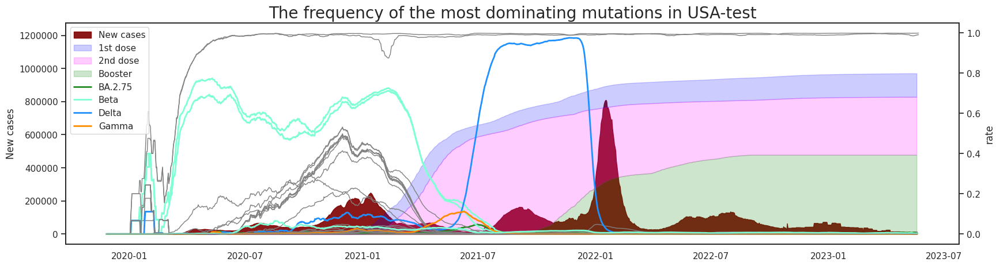

Done.


In [45]:
def output_mutations_country_f(csvmodifile, unic, countryname, mutlist, _mut_date_, day, linew, fontsize):
    global vocplate, platevoc
    #from matplotlib.ticker import MaxNLocator
    time_begin = time.time()
    f = plt.figure()
    f.set_figwidth(20)
    f.set_figheight(5)
    sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

    ax1 = f.add_subplot()
    ax1.get_yaxis().get_major_formatter().set_scientific(False)
    ax2 = ax1.twinx()
    
    meta = pd.read_csv(csvmodifile)
    meta.thedate = pd.to_datetime(meta.thedate)
    
    population = np.argmax(np.bincount(meta.population.tolist()))
    case = meta.new_cases_smoothed.tolist()
    casea = []
    for what in case:
        if not math.isnan(what):
            casea.append(what)
    maxcase = max(casea)

    l1 = ax1.fill_between(meta.thedate, meta.new_cases_smoothed, 0, alpha = 0.9, label = 'New cases', color = 'maroon')
    l6 = ax1.fill_between(meta.thedate, int(maxcase * 1.5), 0, alpha = 0, color = 'white')
    l2 = ax2.fill_between(meta.thedate, meta.people_vaccinated / population, meta.people_fully_vaccinated / population,color = 'blue', alpha = 0.2, label = '1st dose')
    l3 = ax2.fill_between(meta.thedate, meta.people_fully_vaccinated / population, meta.total_boosters / population, alpha = 0.2, color = 'magenta', label = '2nd dose')
    l4 = ax2.fill_between(meta.thedate, meta.total_boosters / population, 0, alpha = 0.2, color = 'green', label = 'Booster')
    l5 = ax2.fill_between(meta.thedate, 1, alpha = 0, color = 'white')
    
    ax2.set_ylabel('rate')
    ax1.set_ylabel('New cases')

    plt.title('The frequency of the most dominating mutations in ' + countryname,fontsize=fontsize)
    
    estvoc = set()
    mutlegend = [l1, l2, l3, l4]
    for mut in mutlist:
        if mut in _mut_date_:
            mutdf = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
            mutdf = mutdf.reset_index().rename(columns = {'index':'date'})
            mutdf.date = pd.to_datetime(mutdf.date)
            mutdf['rate'] = mutdf['rate'].rolling(day).mean()
            thecolor = which_color(mut, vocplate, unic, 'gray')
            tlinewidth = '1'
            if thecolor == 'gray':
                tlinewidth = '1'
            else:
                tlinewidth = linew
            
            if thecolor != 'gray':
                if platevoc[thecolor] not in estvoc:
                    vvv = platevoc[thecolor]
                    lll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth, label = vvv)
                    mutlegend.extend(lll)
                    estvoc.add(vvv)
                else:
                    ll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth)
            else:
                ll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth)
    print(mutlegend)       
    labs2 = [l.get_label() for l in mutlegend]
    ax2.legend(mutlegend,labs2, loc=2)
    plt.savefig(countryname + ' output_mutations_country fontsize.png', dpi = 600)
    plt.savefig(countryname + ' output_mutations_country fontsize.pdf', dpi = 600)
    plt.savefig(countryname + ' output_mutations_country fontsize.svg', dpi = 600)
    plt.show()
    plt.close('all')
    timer_server(time_begin,countryname + ' output_mutations_country Done')
 
output_mutations_country_f('owidshrink/USA.csvmodi.csv',unic, 'USA-test', testlist, USA_mut_date_, 15, 2, 20)

[<matplotlib.collections.PolyCollection object at 0x7f0ddde97c10>, <matplotlib.collections.PolyCollection object at 0x7f20dbfd5fd0>, <matplotlib.collections.PolyCollection object at 0x7f20dbfff460>, <matplotlib.collections.PolyCollection object at 0x7f20dbfd5f10>, <matplotlib.lines.Line2D object at 0x7f20dbfeed30>, <matplotlib.lines.Line2D object at 0x7f20dbf922b0>, <matplotlib.lines.Line2D object at 0x7f20dbf92f70>, <matplotlib.lines.Line2D object at 0x7f20dbfaca90>]


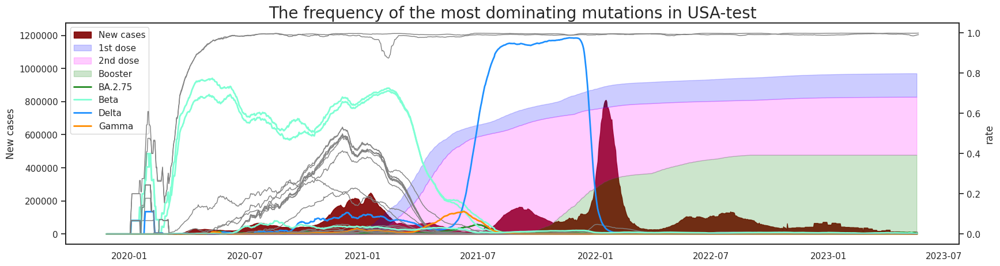

Done.


In [72]:
def adjust_legend_columns(ax, x):
    # 获取当前图例
    legend = ax.get_legend()

    if legend:
        # 获取图例元素数量
        num_elements = len(legend.get_texts())

        # 如果元素数量超过阈值 x，就设置 ncol=2
        if num_elements > x:
            legend.remove()
            # 获取图例的元素和标签
            handles, labels = ax.get_legend_handles_labels()
            # 创建新的图例
            ax.legend(handles, labels, ncol=2)

def adjust_legend_columns(ax1, ax2, x):
    # 获取当前图例
    legend1 = ax1.get_legend()
    legend2 = ax2.get_legend()

    if legend1 and legend2:
        # 获取图例元素数量
        num_elements = len(legend1.get_texts()) + len(legend2.get_texts())

        # 如果元素数量超过阈值 x，就设置 ncol=2
        if num_elements > x:
            legend1.remove()
            legend2.remove()
            # 获取图例的元素和标签
            handles1, labels1 = ax1.get_legend_handles_labels()
            handles2, labels2 = ax2.get_legend_handles_labels()
            # 创建新的图例
            ax2.legend(handles1 + handles2, labels1 + labels2, ncol=2, loc=2)

from matplotlib.patches import Rectangle


def output_mutations_country_f_legend(csvmodifile, unic, countryname, mutlist, _mut_date_, day, linew, fontsize):
    global vocplate, platevoc
    #from matplotlib.ticker import MaxNLocator
    time_begin = time.time()
    f = plt.figure()
    f.set_figwidth(20)
    f.set_figheight(5)
    sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

    ax1 = f.add_subplot()
    ax1.get_yaxis().get_major_formatter().set_scientific(False)
    ax2 = ax1.twinx()
    
    meta = pd.read_csv(csvmodifile)
    meta.thedate = pd.to_datetime(meta.thedate)
    
    population = np.argmax(np.bincount(meta.population.tolist()))
    case = meta.new_cases_smoothed.tolist()
    casea = []
    for what in case:
        if not math.isnan(what):
            casea.append(what)
    maxcase = max(casea)

    l1 = ax1.fill_between(meta.thedate, meta.new_cases_smoothed, 0, alpha = 0.9, label = 'New cases', color = 'maroon')
    l6 = ax1.fill_between(meta.thedate, int(maxcase * 1.5), 0, alpha = 0, color = 'white')
    l2 = ax2.fill_between(meta.thedate, meta.people_vaccinated / population, meta.people_fully_vaccinated / population,color = 'blue', alpha = 0.2, label = '1st dose')
    l3 = ax2.fill_between(meta.thedate, meta.people_fully_vaccinated / population, meta.total_boosters / population, alpha = 0.2, color = 'magenta', label = '2nd dose')
    l4 = ax2.fill_between(meta.thedate, meta.total_boosters / population, 0, alpha = 0.2, color = 'green', label = 'Booster')
    l5 = ax2.fill_between(meta.thedate, 1, alpha = 0, color = 'white')
    
    ax2.set_ylabel('rate')
    ax1.set_ylabel('New cases')

    plt.title('The frequency of the most dominating mutations in ' + countryname,fontsize=fontsize)
    
    estvoc = set()
    mutlegend = [l1, l2, l3, l4]
    for mut in mutlist:
        if mut in _mut_date_:
            mutdf = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
            mutdf = mutdf.reset_index().rename(columns = {'index':'date'})
            mutdf.date = pd.to_datetime(mutdf.date)
            mutdf['rate'] = mutdf['rate'].rolling(day).mean()
            thecolor = which_color(mut, vocplate, unic, 'gray')
            tlinewidth = '1'
            if thecolor == 'gray':
                tlinewidth = '1'
            else:
                tlinewidth = linew
            
            if thecolor != 'gray':
                if platevoc[thecolor] not in estvoc:
                    vvv = platevoc[thecolor]
                    lll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth, label = vvv)
                    mutlegend.extend(lll)
                    estvoc.add(vvv)
                else:
                    ll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth)
            else:
                ll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth)
    print(mutlegend)       
    labs2 = [l.get_label() for l in mutlegend]
    ax2.legend(mutlegend,labs2, loc=2)
    # 获取 ax1 和 ax2 中的所有图例元素和标签
    # 获取 ax1 和 ax2 中的所有图例元素和标签
    handles1, labels1 = ax1.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()

    # 从 ax1 和 ax2 中移除现有的图例，如果存在的话
    if ax1.get_legend():
        ax1.get_legend().remove()
    if ax2.get_legend():
        ax2.get_legend().remove()

    if len(handles1 + handles2) > 14:
        leg = ax1.legend(handles1 + handles2, labels1 + labels2, loc=2, ncol=2)
    else:
        leg = ax1.legend(handles1 + handles2, labels1 + labels2, loc=2)
    
    leg.set_frame_on(True)
    leg.set_alpha(1)
    
    plt.savefig(countryname + ' output_mutations_country fontsize.png', dpi = 600)
    plt.savefig(countryname + ' output_mutations_country fontsize.pdf', dpi = 600)
    plt.savefig(countryname + ' output_mutations_country fontsize.svg', dpi = 600)
    plt.show()
    plt.close('all')
    timer_server(time_begin,countryname + ' output_mutations_country Done')
 
output_mutations_country_f_legend('owidshrink/USA.csvmodi.csv',unic, 'USA-test', testlist, USA_mut_date_, 15, 2, 20)

[<matplotlib.collections.PolyCollection object at 0x7f20dbcbc1c0>, <matplotlib.collections.PolyCollection object at 0x7f20dbc33df0>, <matplotlib.collections.PolyCollection object at 0x7f20dbbc3d90>, <matplotlib.collections.PolyCollection object at 0x7f20dbc21fa0>, <matplotlib.lines.Line2D object at 0x7f20dbbeb580>, <matplotlib.lines.Line2D object at 0x7f20dbbebac0>, <matplotlib.lines.Line2D object at 0x7f20dbbdb820>, <matplotlib.lines.Line2D object at 0x7f20dbb9a2e0>]


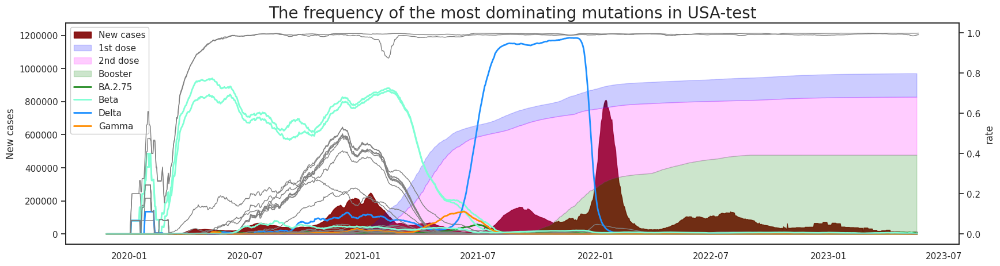

Done.


In [76]:
def output_mutations_country_f_legend(csvmodifile, unic, countryname, mutlist, _mut_date_, day, linew, fontsize):
    global vocplate, platevoc
    #from matplotlib.ticker import MaxNLocator
    time_begin = time.time()
    f = plt.figure()
    f.set_figwidth(20)
    f.set_figheight(5)
    sns.set_theme(context='notebook', style='white', palette='bright', font='sans-serif', font_scale=1, color_codes=True, rc=None)

    ax1 = f.add_subplot()
    ax1.get_yaxis().get_major_formatter().set_scientific(False)
    ax2 = ax1.twinx()
    
    meta = pd.read_csv(csvmodifile)
    meta.thedate = pd.to_datetime(meta.thedate)
    
    population = np.argmax(np.bincount(meta.population.tolist()))
    case = meta.new_cases_smoothed.tolist()
    casea = []
    for what in case:
        if not math.isnan(what):
            casea.append(what)
    maxcase = max(casea)

    l1 = ax1.fill_between(meta.thedate, meta.new_cases_smoothed, 0, alpha = 0.9, label = 'New cases', color = 'maroon')
    #l6 = ax1.fill_between(meta.thedate, int(maxcase * 1.5), 0, alpha = 0, color = 'white')
    l6 = ax1.axhline(int(maxcase * 1.5), color='white')
    l2 = ax2.fill_between(meta.thedate, meta.people_vaccinated / population, meta.people_fully_vaccinated / population,color = 'blue', alpha = 0.2, label = '1st dose')
    l3 = ax2.fill_between(meta.thedate, meta.people_fully_vaccinated / population, meta.total_boosters / population, alpha = 0.2, color = 'magenta', label = '2nd dose')
    l4 = ax2.fill_between(meta.thedate, meta.total_boosters / population, 0, alpha = 0.2, color = 'green', label = 'Booster')
    l5 = ax2.fill_between(meta.thedate, 1, alpha = 0, color = 'white')
    
    ax2.set_ylabel('rate')
    ax1.set_ylabel('New cases')

    plt.title('The frequency of the most dominating mutations in ' + countryname,fontsize=fontsize)
    
    estvoc = set()
    mutlegend = [l1, l2, l3, l4]
    for mut in mutlist:
        if mut in _mut_date_:
            mutdf = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = ['rate']).reindex(formtimeseq(_mut_date_[mut]))
            mutdf = mutdf.reset_index().rename(columns = {'index':'date'})
            mutdf.date = pd.to_datetime(mutdf.date)
            mutdf['rate'] = mutdf['rate'].rolling(day).mean()
            thecolor = which_color(mut, vocplate, unic, 'gray')
            tlinewidth = '1'
            if thecolor == 'gray':
                tlinewidth = '1'
            else:
                tlinewidth = linew
            
            if thecolor != 'gray':
                if platevoc[thecolor] not in estvoc:
                    vvv = platevoc[thecolor]
                    lll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth, label = vvv)
                    mutlegend.extend(lll)
                    estvoc.add(vvv)
                else:
                    ll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth)
            else:
                ll = ax2.plot(mutdf.date, mutdf.rate,color = thecolor, linewidth = tlinewidth)
    print(mutlegend)       
    labs2 = [l.get_label() for l in mutlegend]
    #ax2.legend(mutlegend,labs2, loc=2)
    # 获取 ax1 和 ax2 中的所有图例元素和标签
    # 获取 ax1 和 ax2 中的所有图例元素和标签
    handles1, labels1 = ax1.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()

    # 从 ax1 和 ax2 中移除现有的图例，如果存在的话
#    if ax1.get_legend():
#        ax1.get_legend().remove()
#    if ax2.get_legend():
#        ax2.get_legend().remove()

    if len(handles1 + handles2) > 14:
        leg = ax1.legend(handles1 + handles2, labels1 + labels2, loc=2, ncol=2)
    else:
        leg = ax1.legend(handles1 + handles2, labels1 + labels2, loc=2)
    
    leg_frame = leg.get_frame()
    leg_frame.set_alpha(1)
    
    plt.savefig(countryname + ' output_mutations_country fontsize.png', dpi = 600)
    plt.savefig(countryname + ' output_mutations_country fontsize.pdf', dpi = 600)
    plt.savefig(countryname + ' output_mutations_country fontsize.svg', dpi = 600)
    plt.show()
    plt.close('all')
    timer_server(time_begin,countryname + ' output_mutations_country Done')
 
output_mutations_country_f_legend('owidshrink/USA.csvmodi.csv',unic, 'USA-test', testlist, USA_mut_date_, 15, 2, 20)

[<matplotlib.collections.PolyCollection object at 0x7f20dbfd5d90>, <matplotlib.collections.PolyCollection object at 0x7f20c2c8fa90>, <matplotlib.collections.PolyCollection object at 0x7f20273a5520>, <matplotlib.collections.PolyCollection object at 0x7f20c2c96ac0>, <matplotlib.lines.Line2D object at 0x7f20c2c3fb80>, <matplotlib.lines.Line2D object at 0x7f20c2c0e8e0>, <matplotlib.lines.Line2D object at 0x7f20c2bb8640>, <matplotlib.lines.Line2D object at 0x7f20c2be2040>, <matplotlib.lines.Line2D object at 0x7f20c2be23d0>, <matplotlib.lines.Line2D object at 0x7f20c2b99400>, <matplotlib.lines.Line2D object at 0x7f20c2af99d0>, <matplotlib.lines.Line2D object at 0x7f20c2b30730>, <matplotlib.lines.Line2D object at 0x7f20c2b309d0>, <matplotlib.lines.Line2D object at 0x7f20c2abf490>, <matplotlib.lines.Line2D object at 0x7f20c2abff10>, <matplotlib.lines.Line2D object at 0x7f20c2af5310>, <matplotlib.lines.Line2D object at 0x7f20c2a91af0>, <matplotlib.lines.Line2D object at 0x7f20c2a9eaf0>, <matplo

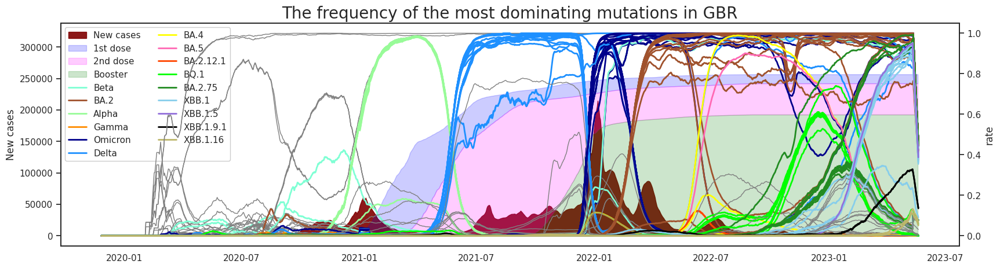

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20ac53d070>, <matplotlib.collections.PolyCollection object at 0x7f20ac52ff10>, <matplotlib.collections.PolyCollection object at 0x7f20ac54b550>, <matplotlib.collections.PolyCollection object at 0x7f20ac54b5e0>, <matplotlib.lines.Line2D object at 0x7f20ac567910>, <matplotlib.lines.Line2D object at 0x7f20ac567f70>, <matplotlib.lines.Line2D object at 0x7f20ac4f3e20>, <matplotlib.lines.Line2D object at 0x7f20ac522640>, <matplotlib.lines.Line2D object at 0x7f20ac4bde20>, <matplotlib.lines.Line2D object at 0x7f20ac439130>, <matplotlib.lines.Line2D object at 0x7f20ac448670>, <matplotlib.lines.Line2D object at 0x7f20ac38a490>, <matplotlib.lines.Line2D object at 0x7f20ac3325b0>, <matplotlib.lines.Line2D object at 0x7f20ac332d90>, <matplotlib.lines.Line2D object at 0x7f20ac33eaf0>, <matplotlib.lines.Line2D object at 0x7f20ac34d310>, <matplotlib.lines.Line2D object at 0x7f20ac36b310>, <matplotlib.lines.Line2D object at 0x7f20ac2f8fd0>, <

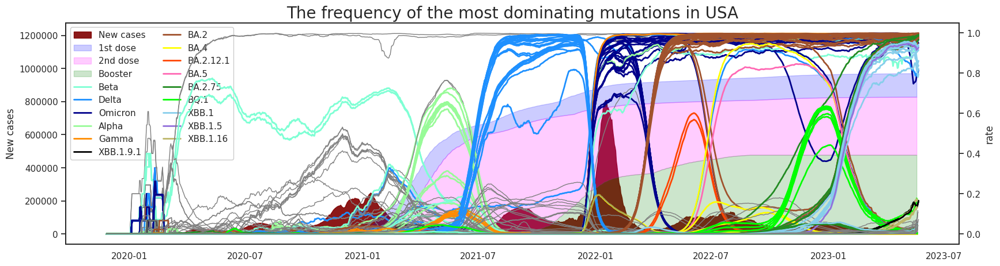

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20dbb1cdf0>, <matplotlib.collections.PolyCollection object at 0x7f20d6845100>, <matplotlib.collections.PolyCollection object at 0x7f20d6864520>, <matplotlib.collections.PolyCollection object at 0x7f20d68645b0>, <matplotlib.lines.Line2D object at 0x7f20d687a8e0>, <matplotlib.lines.Line2D object at 0x7f20d68158b0>, <matplotlib.lines.Line2D object at 0x7f20d6815df0>, <matplotlib.lines.Line2D object at 0x7f20d6807b50>, <matplotlib.lines.Line2D object at 0x7f20d6836610>, <matplotlib.lines.Line2D object at 0x7f209ffd7b50>, <matplotlib.lines.Line2D object at 0x7f209ff738e0>, <matplotlib.lines.Line2D object at 0x7f209ff26c40>, <matplotlib.lines.Line2D object at 0x7f209fe6d460>, <matplotlib.lines.Line2D object at 0x7f209fe05580>, <matplotlib.lines.Line2D object at 0x7f209fd97ac0>, <matplotlib.lines.Line2D object at 0x7f209fd44d60>, <matplotlib.lines.Line2D object at 0x7f209fcec2e0>, <matplotlib.lines.Line2D object at 0x7f209fce12e0>, <

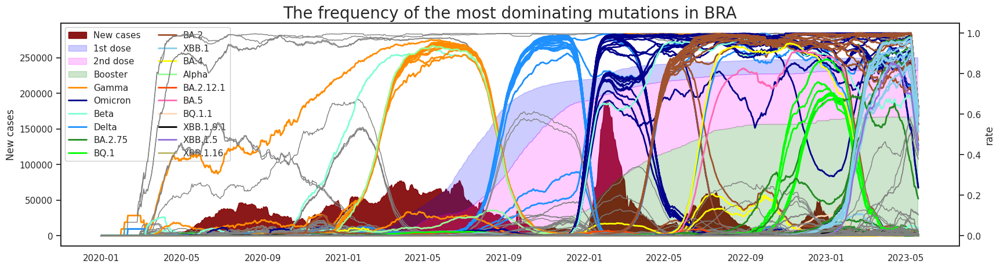

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20dbcd35b0>, <matplotlib.collections.PolyCollection object at 0x7f20cf4e0730>, <matplotlib.collections.PolyCollection object at 0x7f20cf4e4640>, <matplotlib.collections.PolyCollection object at 0x7f20cf4e46d0>, <matplotlib.lines.Line2D object at 0x7f20cf4a3760>, <matplotlib.lines.Line2D object at 0x7f20cf493490>, <matplotlib.lines.Line2D object at 0x7f20cf4851f0>, <matplotlib.lines.Line2D object at 0x7f20cf485490>, <matplotlib.lines.Line2D object at 0x7f20cf4b7c70>, <matplotlib.lines.Line2D object at 0x7f20cf4511f0>, <matplotlib.lines.Line2D object at 0x7f20cf46e1f0>, <matplotlib.lines.Line2D object at 0x7f20cf358820>, <matplotlib.lines.Line2D object at 0x7f20cf310580>, <matplotlib.lines.Line2D object at 0x7f20cf29b220>, <matplotlib.lines.Line2D object at 0x7f20cf2a9e80>, <matplotlib.lines.Line2D object at 0x7f20cf158940>, <matplotlib.lines.Line2D object at 0x7f2098780970>, <matplotlib.lines.Line2D object at 0x7f209879cc10>, <

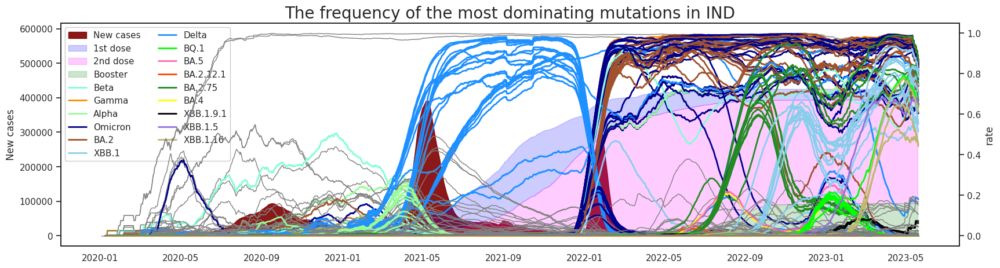

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20dbfd5190>, <matplotlib.collections.PolyCollection object at 0x7f20d93ce790>, <matplotlib.collections.PolyCollection object at 0x7f20d93cd730>, <matplotlib.collections.PolyCollection object at 0x7f20d93cd7c0>, <matplotlib.lines.Line2D object at 0x7f20d93bc580>, <matplotlib.lines.Line2D object at 0x7f20d9359580>, <matplotlib.lines.Line2D object at 0x7f20d93662e0>, <matplotlib.lines.Line2D object at 0x7f20d9302850>, <matplotlib.lines.Line2D object at 0x7f20d932a310>, <matplotlib.lines.Line2D object at 0x7f20d92d55e0>, <matplotlib.lines.Line2D object at 0x7f20d9299e50>, <matplotlib.lines.Line2D object at 0x7f20d9243670>, <matplotlib.lines.Line2D object at 0x7f20d92513d0>, <matplotlib.lines.Line2D object at 0x7f20d92244f0>, <matplotlib.lines.Line2D object at 0x7f20a27cd520>, <matplotlib.lines.Line2D object at 0x7f20a252b520>, <matplotlib.lines.Line2D object at 0x7f20a2565d00>, <matplotlib.lines.Line2D object at 0x7f20a2484a60>, <

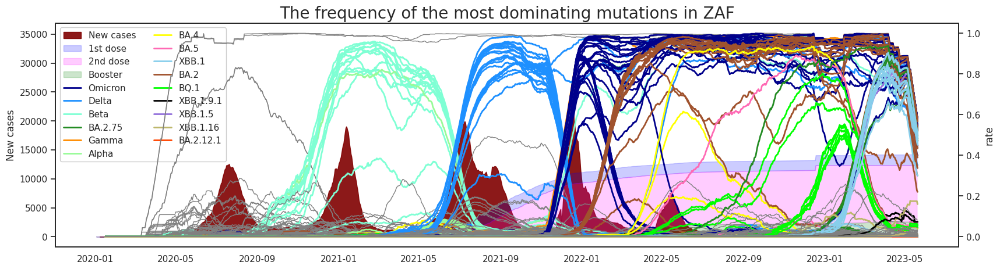

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20d90231f0>, <matplotlib.collections.PolyCollection object at 0x7f20d9023220>, <matplotlib.collections.PolyCollection object at 0x7f20d6fbf670>, <matplotlib.collections.PolyCollection object at 0x7f20d6fbf700>, <matplotlib.lines.Line2D object at 0x7f20d6fe2ca0>, <matplotlib.lines.Line2D object at 0x7f20d6fd4ca0>, <matplotlib.lines.Line2D object at 0x7f20d6f93760>, <matplotlib.lines.Line2D object at 0x7f20d6f0dcd0>, <matplotlib.lines.Line2D object at 0x7f20d6eed850>, <matplotlib.lines.Line2D object at 0x7f20d6e4ed90>, <matplotlib.lines.Line2D object at 0x7f20d6ca6430>, <matplotlib.lines.Line2D object at 0x7f20d6ac89a0>, <matplotlib.lines.Line2D object at 0x7f20d685f700>, <matplotlib.lines.Line2D object at 0x7f20d68299a0>, <matplotlib.lines.Line2D object at 0x7f209fe8ac40>, <matplotlib.lines.Line2D object at 0x7f209fe35ee0>, <matplotlib.lines.Line2D object at 0x7f209fe511c0>, <matplotlib.lines.Line2D object at 0x7f209fd8eee0>]


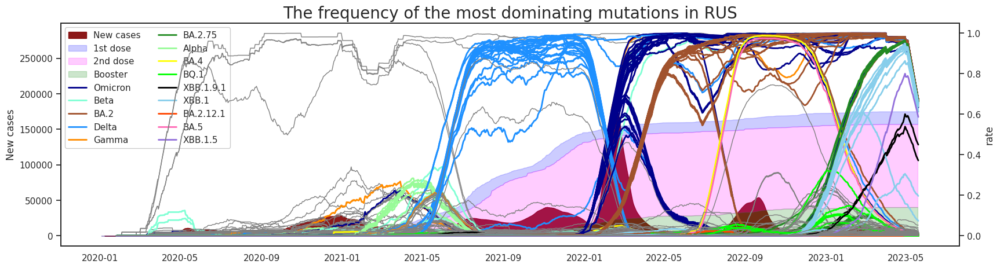

Done.
Done.


In [77]:
#mainly used????!!!!!
#no
time_begin = time.time()

t = 6

p = Pool(t)
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/USA.csvmodi.csv',unic, 'USA', nation_mostprevalent_mutlist_v2_2['United States of America (the)'], USA_mut_date_, 15,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/BRA.csvmodi.csv',unic, 'BRA', nation_mostprevalent_mutlist_v2_2['Brazil'], BRA_mut_date_, 30,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/IND.csvmodi.csv',unic, 'IND', nation_mostprevalent_mutlist_v2_2['India'], IND_mut_date_, 40,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/RUS.csvmodi.csv',unic, 'RUS', nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'], RUS_mut_date_, 55,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/ZAF.csvmodi.csv',unic, 'ZAF', nation_mostprevalent_mutlist_v2_2['South Africa'], ZAF_mut_date_, 45,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/GBR.csvmodi.csv',unic, 'GBR', nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)'], GBR_mut_date_, 15,'2',20, ))


p.close()
p.join()
timer_server(time_begin, 'Drawing All Done')

[<matplotlib.collections.PolyCollection object at 0x7f2031118b80>, <matplotlib.collections.PolyCollection object at 0x7f2029b947f0>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0c40>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0c10>, <matplotlib.lines.Line2D object at 0x7f2029b4aa30>, <matplotlib.lines.Line2D object at 0x7f20f8ded460>, <matplotlib.lines.Line2D object at 0x7f2029b19550>, <matplotlib.lines.Line2D object at 0x7f20f8cb3040>, <matplotlib.lines.Line2D object at 0x7f20f8cb3f40>, <matplotlib.lines.Line2D object at 0x7f20f8be1520>, <matplotlib.lines.Line2D object at 0x7f20f8b39190>, <matplotlib.lines.Line2D object at 0x7f2029aa5850>, <matplotlib.lines.Line2D object at 0x7f2029aa5a90>, <matplotlib.lines.Line2D object at 0x7f20f8f9a550>, <matplotlib.lines.Line2D object at 0x7f202c3292b0>, <matplotlib.lines.Line2D object at 0x7f2029af9ca0>, <matplotlib.lines.Line2D object at 0x7f202e566f40>, <matplotlib.lines.Line2D object at 0x7f202e6203a0>, <matplo

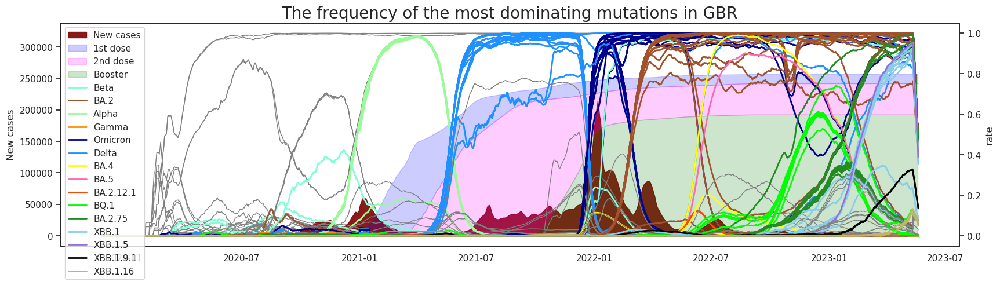

Done.
[<matplotlib.collections.PolyCollection object at 0x7f2029be8370>, <matplotlib.collections.PolyCollection object at 0x7f20273ac340>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0670>, <matplotlib.collections.PolyCollection object at 0x7f2029b94e80>, <matplotlib.lines.Line2D object at 0x7f20f907b670>, <matplotlib.lines.Line2D object at 0x7f20f907b8e0>, <matplotlib.lines.Line2D object at 0x7f2029b4aaf0>, <matplotlib.lines.Line2D object at 0x7f2029b54700>, <matplotlib.lines.Line2D object at 0x7f20f8ded400>, <matplotlib.lines.Line2D object at 0x7f2029b39df0>, <matplotlib.lines.Line2D object at 0x7f20f8c33850>, <matplotlib.lines.Line2D object at 0x7f202c3295e0>, <matplotlib.lines.Line2D object at 0x7f2029af9be0>, <matplotlib.lines.Line2D object at 0x7f202c4a4b80>, <matplotlib.lines.Line2D object at 0x7f2029a9b4f0>, <matplotlib.lines.Line2D object at 0x7f2029a9bd60>, <matplotlib.lines.Line2D object at 0x7f202e79a400>, <matplotlib.lines.Line2D object at 0x7f202e6e0760>, <

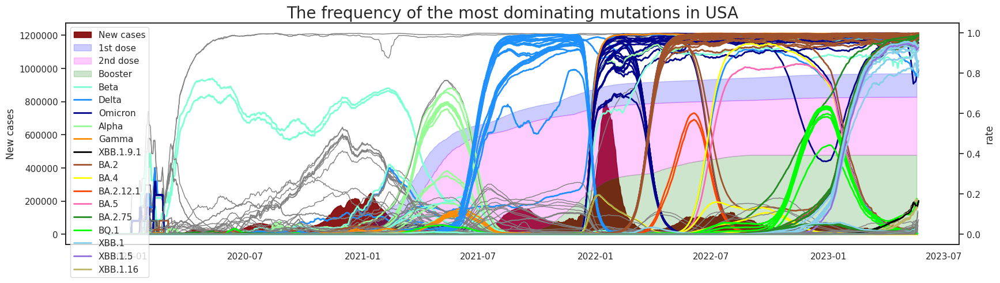

Done.
[<matplotlib.collections.PolyCollection object at 0x7f2029bfdd30>, <matplotlib.collections.PolyCollection object at 0x7f2029bfde80>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0640>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0970>, <matplotlib.lines.Line2D object at 0x7f20f907bac0>, <matplotlib.lines.Line2D object at 0x7f2029bb5340>, <matplotlib.lines.Line2D object at 0x7f2029bb5790>, <matplotlib.lines.Line2D object at 0x7f2029b4a910>, <matplotlib.lines.Line2D object at 0x7f2029b54970>, <matplotlib.lines.Line2D object at 0x7f20f90aab80>, <matplotlib.lines.Line2D object at 0x7f2029b19880>, <matplotlib.lines.Line2D object at 0x7f20f8bf9460>, <matplotlib.lines.Line2D object at 0x7f2029aa5250>, <matplotlib.lines.Line2D object at 0x7f202e6e0400>, <matplotlib.lines.Line2D object at 0x7f202eb57820>, <matplotlib.lines.Line2D object at 0x7f20f8904cd0>, <matplotlib.lines.Line2D object at 0x7f2030d92ee0>, <matplotlib.lines.Line2D object at 0x7f20310a0940>, <

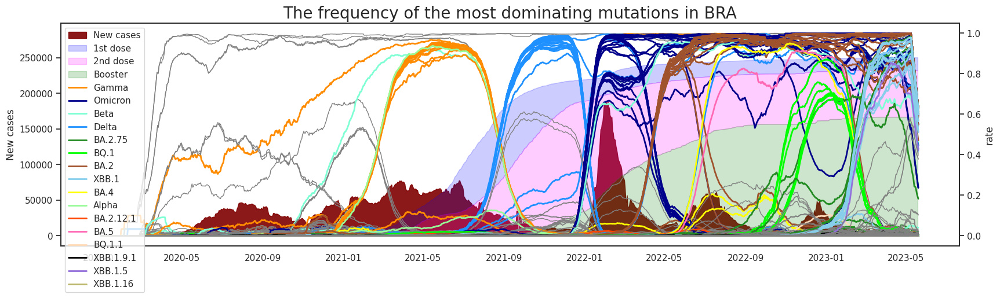

Done.
[<matplotlib.collections.PolyCollection object at 0x7f2031118790>, <matplotlib.collections.PolyCollection object at 0x7f2029b94520>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0940>, <matplotlib.collections.PolyCollection object at 0x7f2029ba09d0>, <matplotlib.lines.Line2D object at 0x7f20f907b6d0>, <matplotlib.lines.Line2D object at 0x7f20f907bc10>, <matplotlib.lines.Line2D object at 0x7f2029bb5c40>, <matplotlib.lines.Line2D object at 0x7f2029bb5bb0>, <matplotlib.lines.Line2D object at 0x7f2029b54cd0>, <matplotlib.lines.Line2D object at 0x7f2029b76400>, <matplotlib.lines.Line2D object at 0x7f2029b01b80>, <matplotlib.lines.Line2D object at 0x7f2029a84df0>, <matplotlib.lines.Line2D object at 0x7f20f8f9a7c0>, <matplotlib.lines.Line2D object at 0x7f202e6e00a0>, <matplotlib.lines.Line2D object at 0x7f2029ab2ac0>, <matplotlib.lines.Line2D object at 0x7f2030fda880>, <matplotlib.lines.Line2D object at 0x7f202990eca0>, <matplotlib.lines.Line2D object at 0x7f203b251940>, <

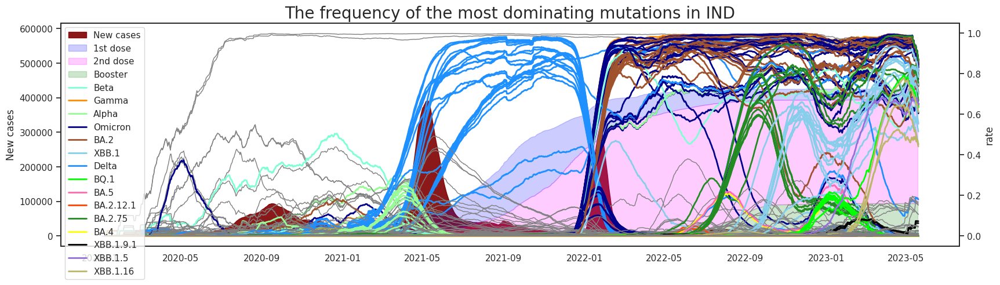

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20311180d0>, <matplotlib.collections.PolyCollection object at 0x7f2029b949d0>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0e20>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0df0>, <matplotlib.lines.Line2D object at 0x7f2029b76af0>, <matplotlib.lines.Line2D object at 0x7f2029b01f40>, <matplotlib.lines.Line2D object at 0x7f20f90aa550>, <matplotlib.lines.Line2D object at 0x7f20f901c580>, <matplotlib.lines.Line2D object at 0x7f203110b790>, <matplotlib.lines.Line2D object at 0x7f20f8be1070>, <matplotlib.lines.Line2D object at 0x7f2029b6bd30>, <matplotlib.lines.Line2D object at 0x7f2029a84dc0>, <matplotlib.lines.Line2D object at 0x7f2029a8fe50>, <matplotlib.lines.Line2D object at 0x7f202c3e4850>, <matplotlib.lines.Line2D object at 0x7f20299e1a60>, <matplotlib.lines.Line2D object at 0x7f2035e63d90>, <matplotlib.lines.Line2D object at 0x7f2033c1b550>, <matplotlib.lines.Line2D object at 0x7f2031337f40>, <

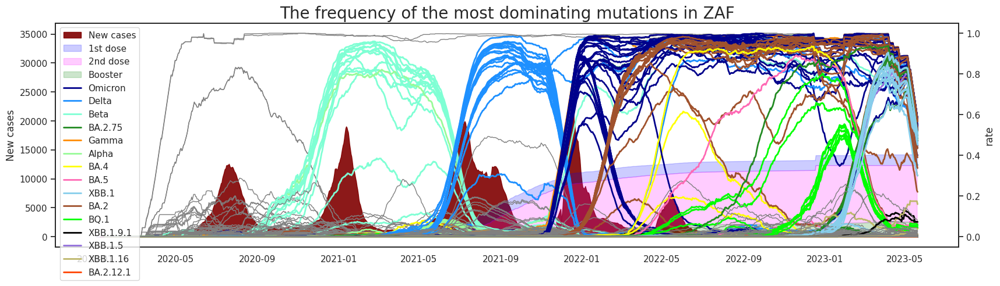

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20311181c0>, <matplotlib.collections.PolyCollection object at 0x7f2029b948e0>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0a60>, <matplotlib.collections.PolyCollection object at 0x7f2029ba0a30>, <matplotlib.lines.Line2D object at 0x7f2029bb5760>, <matplotlib.lines.Line2D object at 0x7f2029b4aa90>, <matplotlib.lines.Line2D object at 0x7f2029b60fa0>, <matplotlib.lines.Line2D object at 0x7f2029b397f0>, <matplotlib.lines.Line2D object at 0x7f2029aed550>, <matplotlib.lines.Line2D object at 0x7f2029aa5fa0>, <matplotlib.lines.Line2D object at 0x7f2030fda5b0>, <matplotlib.lines.Line2D object at 0x7f202997b280>, <matplotlib.lines.Line2D object at 0x7f20f9175640>, <matplotlib.lines.Line2D object at 0x7f20f91ac7f0>, <matplotlib.lines.Line2D object at 0x7f2038902be0>, <matplotlib.lines.Line2D object at 0x7f20388400d0>, <matplotlib.lines.Line2D object at 0x7f2038781d60>, <matplotlib.lines.Line2D object at 0x7f20f9169040>]


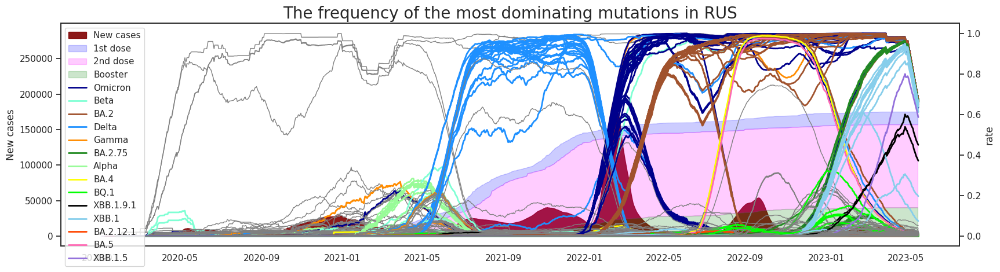

Done.
Done.


In [46]:
#mainly used????!!!!!
#no
time_begin = time.time()

t = 6

p = Pool(t)
p.apply_async(output_mutations_country_f, args = ('owidshrink/USA.csvmodi.csv',unic, 'USA', nation_mostprevalent_mutlist_v2_2['United States of America (the)'], USA_mut_date_, 15,'2',20, ))
p.apply_async(output_mutations_country_f, args = ('owidshrink/BRA.csvmodi.csv',unic, 'BRA', nation_mostprevalent_mutlist_v2_2['Brazil'], BRA_mut_date_, 30,'2',20, ))
p.apply_async(output_mutations_country_f, args = ('owidshrink/IND.csvmodi.csv',unic, 'IND', nation_mostprevalent_mutlist_v2_2['India'], IND_mut_date_, 40,'2',20, ))
p.apply_async(output_mutations_country_f, args = ('owidshrink/RUS.csvmodi.csv',unic, 'RUS', nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'], RUS_mut_date_, 55,'2',20, ))
p.apply_async(output_mutations_country_f, args = ('owidshrink/ZAF.csvmodi.csv',unic, 'ZAF', nation_mostprevalent_mutlist_v2_2['South Africa'], ZAF_mut_date_, 45,'2',20, ))
p.apply_async(output_mutations_country_f, args = ('owidshrink/GBR.csvmodi.csv',unic, 'GBR', nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)'], GBR_mut_date_, 15,'2',20, ))


p.close()
p.join()
timer_server(time_begin, 'Drawing All Done')

[<matplotlib.collections.PolyCollection object at 0x7f20d681bf10>, <matplotlib.collections.PolyCollection object at 0x7f20d6802250>, <matplotlib.collections.PolyCollection object at 0x7f20d68270d0>, <matplotlib.collections.PolyCollection object at 0x7f20d682eb80>, <matplotlib.lines.Line2D object at 0x7f20d47de9a0>, <matplotlib.lines.Line2D object at 0x7f20d47d11c0>, <matplotlib.lines.Line2D object at 0x7f20d47d1700>, <matplotlib.lines.Line2D object at 0x7f20d47d1c40>, <matplotlib.lines.Line2D object at 0x7f20d47f2ee0>, <matplotlib.lines.Line2D object at 0x7f20d477e9a0>, <matplotlib.lines.Line2D object at 0x7f20d479b1c0>, <matplotlib.lines.Line2D object at 0x7f20d479b9a0>, <matplotlib.lines.Line2D object at 0x7f20d46d0460>, <matplotlib.lines.Line2D object at 0x7f20d46d0ee0>, <matplotlib.lines.Line2D object at 0x7f20d46de1c0>, <matplotlib.lines.Line2D object at 0x7f20d4696700>]


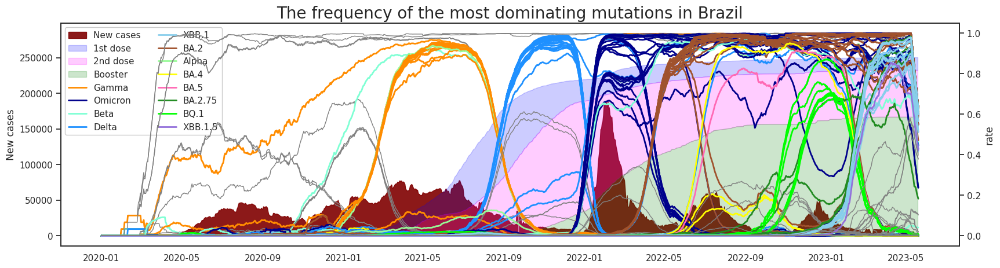


Done.[<matplotlib.collections.PolyCollection object at 0x7f20ac4f6ca0>, <matplotlib.collections.PolyCollection object at 0x7f20ac4f6be0>, <matplotlib.collections.PolyCollection object at 0x7f20ac51bfa0>, <matplotlib.collections.PolyCollection object at 0x7f20ac51bf40>, <matplotlib.lines.Line2D object at 0x7f20ac4ce8b0>, <matplotlib.lines.Line2D object at 0x7f20ac4ceb50>, <matplotlib.lines.Line2D object at 0x7f20ac4b4610>, <matplotlib.lines.Line2D object at 0x7f20ac4dfdf0>, <matplotlib.lines.Line2D object at 0x7f20ac487610>, <matplotlib.lines.Line2D object at 0x7f20ac441370>, <matplotlib.lines.Line2D object at 0x7f20ac441610>, <matplotlib.lines.Line2D object at 0x7f20ac421610>, <matplotlib.lines.Line2D object at 0x7f20ac3bdf70>, <matplotlib.lines.Line2D object at 0x7f20ac3ca8b0>, <matplotlib.lines.Line2D object at 0x7f20ac3cab50>, <matplotlib.lines.Line2D object at 0x7f20ac3cadf0>, <matplotlib.lines.Line2D object at 0x7f20ac3e7df0>, <matplotlib.lines.Line2D object at 0x7f20ac3828b0>, <

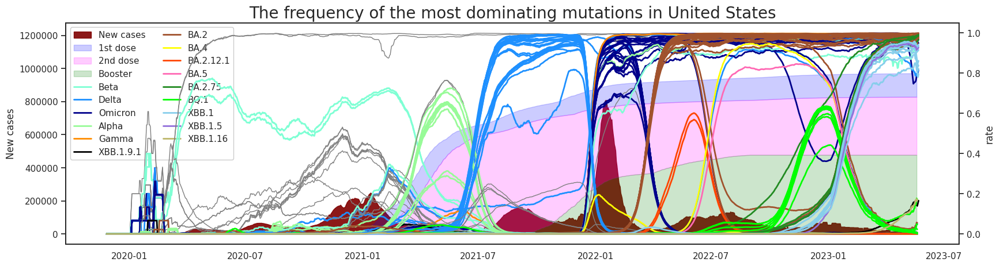

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20c2cf0eb0>, <matplotlib.collections.PolyCollection object at 0x7f20c2c5b520>, <matplotlib.collections.PolyCollection object at 0x7f20c2c604c0>, <matplotlib.collections.PolyCollection object at 0x7f20c2c5bf70>, <matplotlib.lines.Line2D object at 0x7f20c2c0fd90>, <matplotlib.lines.Line2D object at 0x7f20c2c00850>, <matplotlib.lines.Line2D object at 0x7f20c2c00af0>, <matplotlib.lines.Line2D object at 0x7f20c2bbe310>, <matplotlib.lines.Line2D object at 0x7f20c2bbe5b0>, <matplotlib.lines.Line2D object at 0x7f20c2be8fd0>, <matplotlib.lines.Line2D object at 0x7f20c2b75850>, <matplotlib.lines.Line2D object at 0x7f20c2b75af0>, <matplotlib.lines.Line2D object at 0x7f20c2b005b0>, <matplotlib.lines.Line2D object at 0x7f20c2b00850>, <matplotlib.lines.Line2D object at 0x7f20c2b2ad90>, <matplotlib.lines.Line2D object at 0x7f20c2ac7d90>, <matplotlib.lines.Line2D object at 0x7f20c2ad5850>]


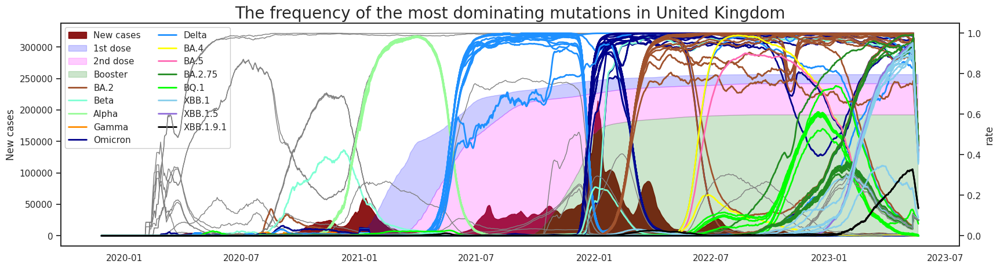

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20d9422df0>, <matplotlib.collections.PolyCollection object at 0x7f20d9396e50>, <matplotlib.collections.PolyCollection object at 0x7f20d93be2e0>, <matplotlib.collections.PolyCollection object at 0x7f20d9396d90>, <matplotlib.lines.Line2D object at 0x7f20d9344910>, <matplotlib.lines.Line2D object at 0x7f20d9344e50>, <matplotlib.lines.Line2D object at 0x7f20d9357130>, <matplotlib.lines.Line2D object at 0x7f20d9300130>, <matplotlib.lines.Line2D object at 0x7f20d930e910>, <matplotlib.lines.Line2D object at 0x7f20d931d910>, <matplotlib.lines.Line2D object at 0x7f20d932ae50>, <matplotlib.lines.Line2D object at 0x7f20d93393d0>, <matplotlib.lines.Line2D object at 0x7f20d9339910>, <matplotlib.lines.Line2D object at 0x7f20d92d5670>, <matplotlib.lines.Line2D object at 0x7f20d926bbb0>, <matplotlib.lines.Line2D object at 0x7f20d927a910>, <matplotlib.lines.Line2D object at 0x7f20d92163d0>, <matplotlib.lines.Line2D object at 0x7f20d9216bb0>]


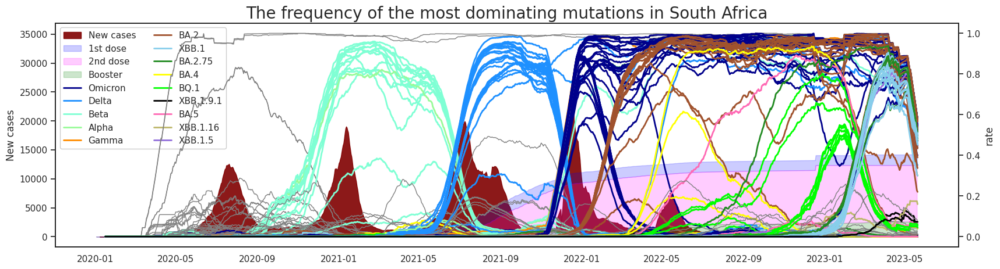

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20cf539c70>, <matplotlib.collections.PolyCollection object at 0x7f20cf4dc340>, <matplotlib.collections.PolyCollection object at 0x7f20cf4a41f0>, <matplotlib.collections.PolyCollection object at 0x7f20cf4abfd0>, <matplotlib.lines.Line2D object at 0x7f20cf44f2e0>, <matplotlib.lines.Line2D object at 0x7f20cf44f580>, <matplotlib.lines.Line2D object at 0x7f20cf44ffa0>, <matplotlib.lines.Line2D object at 0x7f20cf444820>, <matplotlib.lines.Line2D object at 0x7f20cf4702e0>, <matplotlib.lines.Line2D object at 0x7f20cf470fa0>, <matplotlib.lines.Line2D object at 0x7f20cf427820>, <matplotlib.lines.Line2D object at 0x7f20cf3c32e0>, <matplotlib.lines.Line2D object at 0x7f20cf379820>, <matplotlib.lines.Line2D object at 0x7f20cf379d60>, <matplotlib.lines.Line2D object at 0x7f20cf379fa0>, <matplotlib.lines.Line2D object at 0x7f20cf2cafa0>, <matplotlib.lines.Line2D object at 0x7f20cf2d92e0>, <matplotlib.lines.Line2D object at 0x7f20cf2d9580>]


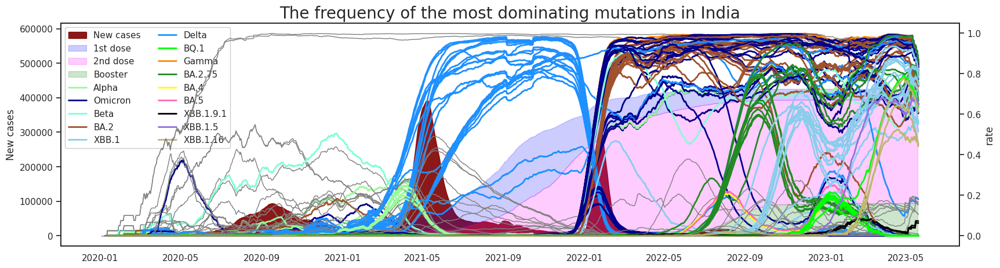

Done.
[<matplotlib.collections.PolyCollection object at 0x7f20d9002d30>, <matplotlib.collections.PolyCollection object at 0x7f20d6ff3d90>, <matplotlib.collections.PolyCollection object at 0x7f20d6f80220>, <matplotlib.collections.PolyCollection object at 0x7f20d6ff3cd0>, <matplotlib.lines.Line2D object at 0x7f20d6fecd90>, <matplotlib.lines.Line2D object at 0x7f20d6fecfd0>, <matplotlib.lines.Line2D object at 0x7f20d6fb5d90>, <matplotlib.lines.Line2D object at 0x7f20d6f44310>, <matplotlib.lines.Line2D object at 0x7f20d6f515b0>, <matplotlib.lines.Line2D object at 0x7f20d6f51d90>, <matplotlib.lines.Line2D object at 0x7f20d6ea2310>, <matplotlib.lines.Line2D object at 0x7f20d6e10af0>, <matplotlib.lines.Line2D object at 0x7f20d6e10d90>, <matplotlib.lines.Line2D object at 0x7f20d6e1e5b0>, <matplotlib.lines.Line2D object at 0x7f20d6e1efd0>, <matplotlib.lines.Line2D object at 0x7f20d6d80850>, <matplotlib.lines.Line2D object at 0x7f20d6d8d310>]


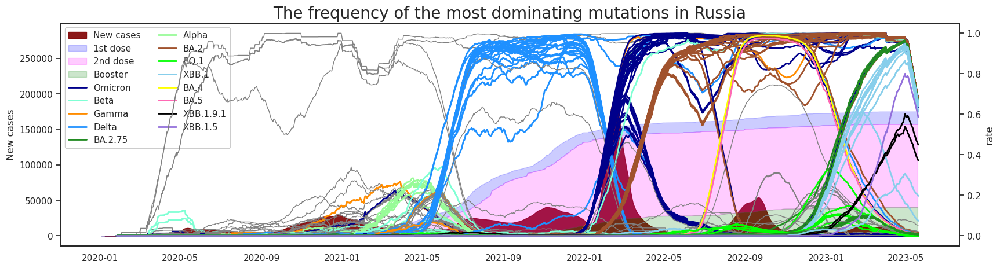

Done.
Done.


In [229]:
#test nation_mostprevalent_mutlist_v2
#nation_mostprevalent_mutlist_v2 
#is 
#actually 
#we 
#need

time_begin = time.time()

t = 6

p = Pool(t)
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/USA.csvmodi.csv',unic, 'United States', nation_mostprevalent_mutlist_v2['United States of America (the)'], USA_mut_date_, 15,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/BRA.csvmodi.csv',unic, 'Brazil', nation_mostprevalent_mutlist_v2['Brazil'], BRA_mut_date_, 30,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/IND.csvmodi.csv',unic, 'India', nation_mostprevalent_mutlist_v2['India'], IND_mut_date_, 40,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/RUS.csvmodi.csv',unic, 'Russia', nation_mostprevalent_mutlist_v2['Russian Federation (the)'], RUS_mut_date_, 55,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/ZAF.csvmodi.csv',unic, 'South Africa', nation_mostprevalent_mutlist_v2['South Africa'], ZAF_mut_date_, 45,'2',20, ))
p.apply_async(output_mutations_country_f_legend, args = ('owidshrink/GBR.csvmodi.csv',unic, 'United Kingdom', nation_mostprevalent_mutlist_v2['United Kingdom of Great Britain and Northern Ireland (the)'], GBR_mut_date_, 15,'2',20, ))


p.close()
p.join()
timer_server(time_begin, 'Drawing All Done')

[<matplotlib.collections.PolyCollection object at 0x7f7dedc52430>, <matplotlib.collections.PolyCollection object at 0x7f7dedc66dc0>, <matplotlib.collections.PolyCollection object at 0x7f7dedd051c0>, <matplotlib.collections.PolyCollection object at 0x7f7dedaa8670>, <matplotlib.lines.Line2D object at 0x7f7dedd02a00>, <matplotlib.lines.Line2D object at 0x7f7dedd114c0>, <matplotlib.lines.Line2D object at 0x7f7dedd1f760>, <matplotlib.lines.Line2D object at 0x7f7dedda3a00>, <matplotlib.lines.Line2D object at 0x7f7dedd8afd0>, <matplotlib.lines.Line2D object at 0x7f7dede41760>, <matplotlib.lines.Line2D object at 0x7f7dedea0760>, <matplotlib.lines.Line2D object at 0x7f7dedef4220>, <matplotlib.lines.Line2D object at 0x7f7dedef4a00>, <matplotlib.lines.Line2D object at 0x7f7dedef4ca0>, <matplotlib.lines.Line2D object at 0x7f7dedef4fd0>, <matplotlib.lines.Line2D object at 0x7f7dedf25ca0>]


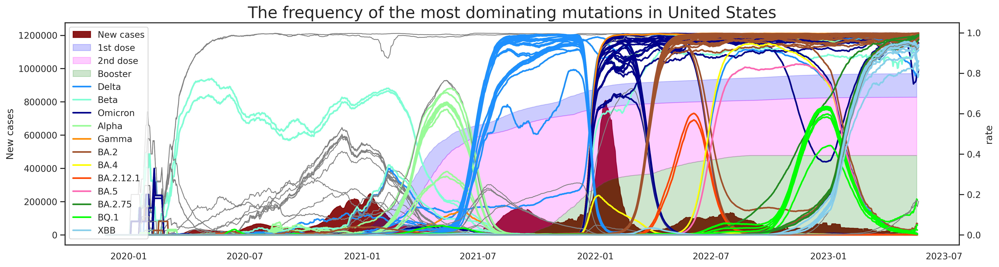

Done.


In [114]:
output_mutations_country_f('owidshrink/USA.csvmodi.csv',unic, 'United States', nation_mostprevalent_mutlist_v2['United States of America (the)'], USA_mut_date_, 15,'2',20)

[<matplotlib.collections.PolyCollection object at 0x7f7dee2701c0>, <matplotlib.collections.PolyCollection object at 0x7f7dfb52bdf0>, <matplotlib.collections.PolyCollection object at 0x7f7dfb537c70>, <matplotlib.collections.PolyCollection object at 0x7f7dfb5234f0>, <matplotlib.lines.Line2D object at 0x7f7dfb95f1c0>, <matplotlib.lines.Line2D object at 0x7f7dfb95f910>, <matplotlib.lines.Line2D object at 0x7f7dfb95fe50>, <matplotlib.lines.Line2D object at 0x7f7dfb96c670>, <matplotlib.lines.Line2D object at 0x7f7dfb98e910>, <matplotlib.lines.Line2D object at 0x7f7dfbd9e3d0>, <matplotlib.lines.Line2D object at 0x7f7dfbdab3d0>, <matplotlib.lines.Line2D object at 0x7f7dfbdbcac0>, <matplotlib.lines.Line2D object at 0x7f7dfbb64e50>, <matplotlib.lines.Line2D object at 0x7f7dfbb71910>, <matplotlib.lines.Line2D object at 0x7f7dfbb71e50>]


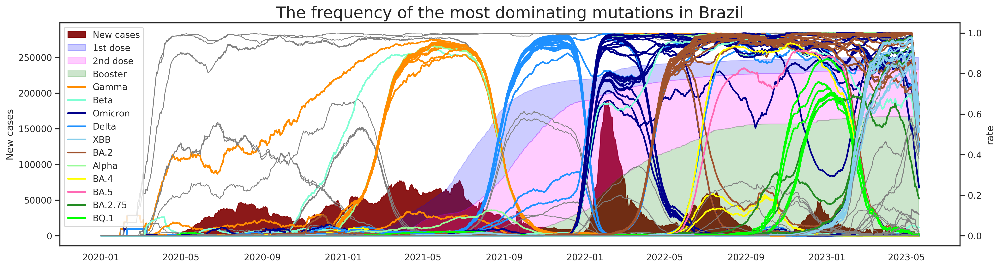

Done.
[<matplotlib.collections.PolyCollection object at 0x7f7deb50ae20>, <matplotlib.collections.PolyCollection object at 0x7f7deb50ad60>, <matplotlib.collections.PolyCollection object at 0x7f7c9a5f4e50>, <matplotlib.collections.PolyCollection object at 0x7f7c9a5f4ee0>, <matplotlib.lines.Line2D object at 0x7f7c9a609b80>, <matplotlib.lines.Line2D object at 0x7f7c9a609e20>, <matplotlib.lines.Line2D object at 0x7f7e0c082190>, <matplotlib.lines.Line2D object at 0x7f7e0c07e3a0>, <matplotlib.lines.Line2D object at 0x7f7e0c07e8e0>, <matplotlib.lines.Line2D object at 0x7f7e0c08db80>, <matplotlib.lines.Line2D object at 0x7f7e0c0443a0>, <matplotlib.lines.Line2D object at 0x7f7dfc7d5190>, <matplotlib.lines.Line2D object at 0x7f7dfc75f3a0>, <matplotlib.lines.Line2D object at 0x7f7dfc75f8e0>, <matplotlib.lines.Line2D object at 0x7f7dfc75fb80>]


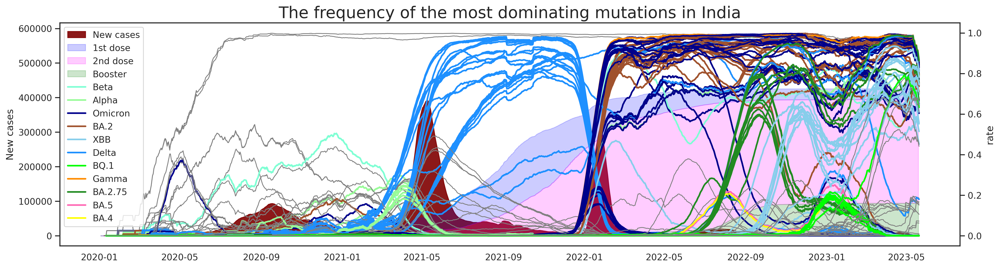

Done.
[<matplotlib.collections.PolyCollection object at 0x7f7dfc57b640>, <matplotlib.collections.PolyCollection object at 0x7f7dfc57b550>, <matplotlib.collections.PolyCollection object at 0x7f7dfc5649d0>, <matplotlib.collections.PolyCollection object at 0x7f7dfc564a60>, <matplotlib.lines.Line2D object at 0x7f7dfc543460>, <matplotlib.lines.Line2D object at 0x7f7dfc543700>, <matplotlib.lines.Line2D object at 0x7f7dfc500460>, <matplotlib.lines.Line2D object at 0x7f7dfc5009a0>, <matplotlib.lines.Line2D object at 0x7f7dfc50fc40>, <matplotlib.lines.Line2D object at 0x7f7dfc51d700>, <matplotlib.lines.Line2D object at 0x7f7dfc45f9a0>, <matplotlib.lines.Line2D object at 0x7f7dfc3d21c0>, <matplotlib.lines.Line2D object at 0x7f7dfc3d2460>, <matplotlib.lines.Line2D object at 0x7f7dfc3d2c40>, <matplotlib.lines.Line2D object at 0x7f7dfc3e9700>]


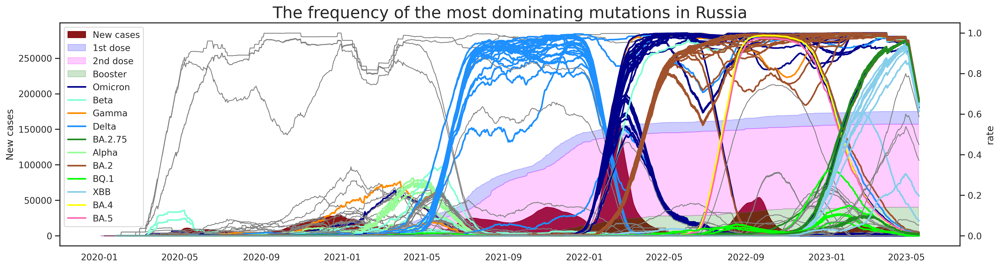

Done.
[<matplotlib.collections.PolyCollection object at 0x7f7dfc234220>, <matplotlib.collections.PolyCollection object at 0x7f7dfc20a730>, <matplotlib.collections.PolyCollection object at 0x7f7dfc1cb370>, <matplotlib.collections.PolyCollection object at 0x7f7dfc1c3e20>, <matplotlib.lines.Line2D object at 0x7f7dfc17eb20>, <matplotlib.lines.Line2D object at 0x7f7dfc17edc0>, <matplotlib.lines.Line2D object at 0x7f7dfc18d0a0>, <matplotlib.lines.Line2D object at 0x7f7dfc1a9b20>, <matplotlib.lines.Line2D object at 0x7f7dfc146880>, <matplotlib.lines.Line2D object at 0x7f7dfc156b20>, <matplotlib.lines.Line2D object at 0x7f7dfc162dc0>, <matplotlib.lines.Line2D object at 0x7f7dfc171340>, <matplotlib.lines.Line2D object at 0x7f7dfc171880>, <matplotlib.lines.Line2D object at 0x7f7dfc10c5e0>, <matplotlib.lines.Line2D object at 0x7f7dfbd49b20>]


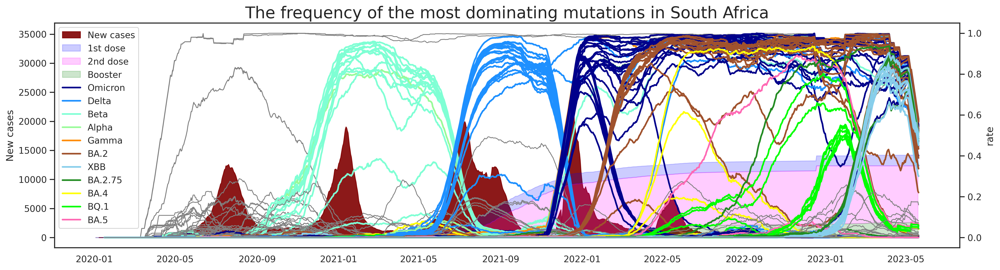

Done.
[<matplotlib.collections.PolyCollection object at 0x7f7dfba2dac0>, <matplotlib.collections.PolyCollection object at 0x7f7dfb569e50>, <matplotlib.collections.PolyCollection object at 0x7f7dfb57e580>, <matplotlib.collections.PolyCollection object at 0x7f7dfb57e640>, <matplotlib.lines.Line2D object at 0x7f7df83d0d60>, <matplotlib.lines.Line2D object at 0x7f7df83df820>, <matplotlib.lines.Line2D object at 0x7f7df83dfac0>, <matplotlib.lines.Line2D object at 0x7f7df839a2e0>, <matplotlib.lines.Line2D object at 0x7f7df83b7040>, <matplotlib.lines.Line2D object at 0x7f7df83b7ac0>, <matplotlib.lines.Line2D object at 0x7f7df82ce850>, <matplotlib.lines.Line2D object at 0x7f7df82ceaf0>, <matplotlib.lines.Line2D object at 0x7f7df82db5b0>, <matplotlib.lines.Line2D object at 0x7f7df82db850>, <matplotlib.lines.Line2D object at 0x7f7df8284d90>]


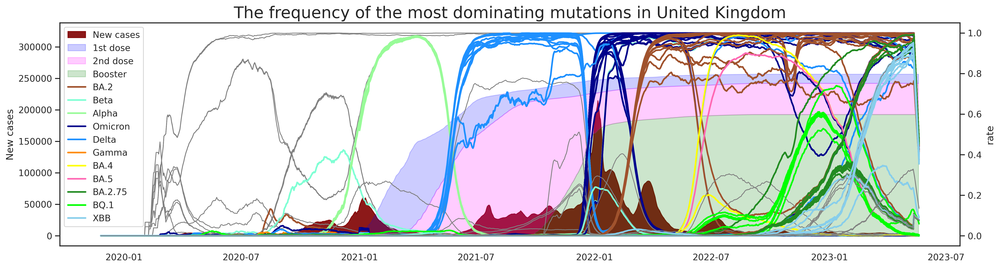

Done.


In [115]:
output_mutations_country_f('owidshrink/BRA.csvmodi.csv',unic, 'Brazil', nation_mostprevalent_mutlist_v2['Brazil'], BRA_mut_date_, 30,'2',20)
output_mutations_country_f('owidshrink/IND.csvmodi.csv',unic, 'India', nation_mostprevalent_mutlist_v2['India'], IND_mut_date_, 40,'2',20)
output_mutations_country_f('owidshrink/RUS.csvmodi.csv',unic, 'Russia', nation_mostprevalent_mutlist_v2['Russian Federation (the)'], RUS_mut_date_, 55,'2',20)
output_mutations_country_f('owidshrink/ZAF.csvmodi.csv',unic, 'South Africa', nation_mostprevalent_mutlist_v2['South Africa'], ZAF_mut_date_, 45,'2',20)
output_mutations_country_f('owidshrink/GBR.csvmodi.csv',unic, 'United Kingdom', nation_mostprevalent_mutlist_v2['United Kingdom of Great Britain and Northern Ireland (the)'], GBR_mut_date_, 15,'2',20)

In [ ]:
import os
import zipfile
 
 
def zipDir(dirpath, outFullName):
    """
    压缩指定文件夹
    :param dirpath: 目标文件夹路径
    :param outFullName: 压缩文件保存路径+xxxx.zip
    :return: 无
    """
    zip = zipfile.ZipFile(outFullName, "w", zipfile.ZIP_DEFLATED)
    for path, dirnames, filenames in os.walk(dirpath):
        # 去掉目标跟路径，只对目标文件夹下边的文件及文件夹进行压缩
        fpath = path.replace(dirpath, '')
 
        for filename in filenames:
            zip.write(os.path.join(path, filename), os.path.join(fpath, filename))
    zip.close()
 
 
if __name__ == "__main__":
    input_path = "./single"
    output_path = "./single.zip"
 
    zipDir(input_path, output_path)

In [156]:
#bench 648.175s
#backup


import math

            

def output_mutations_country_dataframe(countryname, mutlist, _mut_date_, day):
    count = 0
    time_begin = time.time()
    for mut in mutlist:
        if mut in _mut_date_:
            if count == 0:
                mutdf = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = [mut]).reindex(formtimeseq(_mut_date_[mut]))
                mutdf = mutdf.reset_index().rename(columns = {'index':'date'})
                mutdf.date = pd.to_datetime(mutdf.date)
                mutdf[mut] = mutdf[mut].rolling(day).mean()
            else:
                newdf = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = [mut]).reindex(formtimeseq(_mut_date_[mut]))
                newdf = newdf.reset_index().rename(columns = {'index':'date'})
                newdf.date = pd.to_datetime(newdf.date)
                mutdf[mut] = newdf[mut].rolling(day).mean()
            count += 1

    timer_server(time_begin,countryname + ' output_mutations_country_dataframe Done')
    return mutdf



In [157]:
#bench
#mainly used
def output_mutations_country_dataframe2(countryname, mutlist, _mut_date_, day):
    count = 0
    time_begin = time.time()
    for mut in mutlist:
        if mut in _mut_date_:
            if count == 0:
                mutdf = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = [mut]).reindex(formtimeseq(_mut_date_[mut]))
                mutdf = mutdf.reset_index().rename(columns = {'index':'date'})
                mutdf.date = pd.to_datetime(mutdf.date)
                mutdf[mut] = mutdf[mut].rolling(day).mean()
            else:
                newdf = pd.DataFrame.from_dict(_mut_date_[mut], orient = 'index', columns = [mut]).reindex(formtimeseq(_mut_date_[mut]))
                newdf = newdf.reset_index().rename(columns = {'index':'date'})
                newdf.date = pd.to_datetime(newdf.date)
                newdf[mut] = newdf[mut].rolling(day).mean()
                mutdf = pd.merge(mutdf, newdf, left_on = 'date', right_on = 'date', how = 'left' )
                #mutdf = pd.concat([mutdf, newdf], axis = 1)
            count += 1
    timer_server(time_begin,countryname + ' output_mutations_country_dataframe Done')
    return mutdf.fillna(0)

usatest3 = output_mutations_country_dataframe2('USA-test2', nation_mostprevalent_mutlist_v2_2['United States of America (the)'], USA_mut_date_, 15)
usatest4 = usatest3.fillna(0)

Done.


In [158]:
import numpy as np
from scipy import stats
import scipy.stats
def list_frontier(thelist, themax, fthres):
    for thevalue in thelist:
        if thevalue >= themax * fthres:
            return thelist.index(thevalue)

            
def dataframe_mut_time_define(mutlist, thedataframe, simulation):
    datelist = thedataframe.date.to_list()
    datestrlist = [thedate.strftime('%Y-%m-%d') for thedate in datelist]
    resultdict = {}
    
    for themut in mutlist:
        resultdict[themut] = {}
        origlist = thedataframe[themut].to_list()
        themax = max(origlist)
        #leaks: only the first themax is indexed
        theborder1_idx = list_frontier(origlist, themax, 0.1)
        theborder2_idx = list_frontier(origlist, themax, 0.8)
        
        if theborder2_idx <= theborder1_idx:
            theborder2_idx = theborder1_idx + 1
            
        theborder1_date = datestrlist[theborder1_idx]
        theborder2_date = datestrlist[theborder2_idx]
        
        x = [i for i in range(len(origlist))]
        xxx = []
        for i in range(len(origlist)):
            numbs = int(origlist[i] * simulation)
            for j in range(numbs):
                xxx.append(x[i])
        resultdict[themut]['skew'] = stats.skew(xxx)
        resultdict[themut]['kurtosis'] = stats.kurtosis(xxx)
        resultdict[themut]['theborder1_date'] = theborder1_date
        resultdict[themut]['theborder2_date'] = theborder2_date
    return resultdict

oka = dataframe_mut_time_define(nation_mostprevalent_mutlist_v2_2['United States of America (the)'], usatest4, 1000)

In [159]:
from scipy.signal import find_peaks
#in the datasets, we found that sometimes one mutation could have multiple peaks of rates over time. We ought to separate them.
def huge_boundary(peaks, x, thres = 0.25):
    breakpoints = []
    for i in range(len(peaks) - 1):
        the_smaller_shoulder = min(x[peaks[i]], x[peaks[i+1]])
        linkages = x[peaks[i]:peaks[i+1]]
        thesmallest = min(linkages)
        thesmallest_index = peaks[i] + list(x[peaks[i]:peaks[i+1]]).index(thesmallest)
        if thesmallest <= the_smaller_shoulder * thres:
            breakpoints.append(thesmallest_index)
    return breakpoints

def cut_cliff(breakpoints, x, themut, newdf, mut_df):
    mut_raw = pd.Series.tolist(mut_df[themut])
    for i in range(len(breakpoints) + 1):
        alias = themut + '.' + str(i)
        if i == 0:
            newlist = mut_raw[:breakpoints[i]] + (len(mut_raw) - breakpoints[i]) * [0]
        elif i == len(breakpoints):
            newlist = mut_raw[breakpoints[i-1]:]
            newlist = (len(mut_raw) - len(newlist)) * [0] + newlist
        else:
            newlist = [0] * breakpoints[i-1] + mut_raw[breakpoints[i-1]:breakpoints[i]] + [0] * breakpoints[i]
        
        newdf[alias] = pd.Series(newlist)
    return newdf

import warnings
warnings.filterwarnings('ignore')


def mut_df_multi_peaker(mut_df):
    newdf = pd.DataFrame()
    newdf['date'] = mut_df['date']

    mutlist = mut_df.columns[1:]

    for themut in mutlist:
        x = mut_df[themut]
        themax = np.nanmax(x)
        peaks, _ = find_peaks(x, height=themax*0.2, distance= 60, width = 50 )
        if len(peaks) > 1:
            breakpoints = huge_boundary(peaks, x, thres = 0.25)
            if len(breakpoints) > 0:
                breakpoints = huge_boundary(peaks, x, 0.25)
                newdf = cut_cliff(breakpoints, x, themut, newdf, mut_df)
            else:
                newdf[themut] = mut_df[themut]
        else:
            newdf[themut] = mut_df[themut]
        #de_frage = newdf.copy()
    return newdf


testusa = pd.read_csv('mut-date-dataframe/United States of America (the).mut_df.csv')
testusa2 = mut_df_multi_peaker(testusa)

In [ ]:
/tmp/ipykernel_194236/4084959933.py:26: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  newdf[alias] = pd.Series(newlist)
/tmp/ipykernel_194236/4084959933.py:48: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  newdf[themut] = mut_df[themut]
/tmp/ipykernel_194236/4084959933.py:26: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  newdf[alias] = pd.Series(newlist)
/tmp/ipykernel_194236/4084959933.py:26: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  newdf[alias] = pd.Series(newlist)
/tmp/ipykernel_194236/4084959933.py:48: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  newdf[themut] = mut_df[themut]

In [160]:
#very close to use
import time
def dataframe_mut_top_define(mutlist, thedataframe):
    firstdate = '2020-01-01'
    datelist = thedataframe.date.to_list()
    datestrlist = [thedate.strftime('%Y-%m-%d') for thedate in datelist]
    resultdict = {}
    xlist = []
    ylist = []
    data = {'date':[],
           'mut':[],
           'max':[]}    
    for themut in mutlist:
        #if themut != 'orf1ab.1767.cct' and themut != 'orf1ab.2688.cgt':
        resultdict[themut] = {}
        data['mut'].append(themut)
        origlist = thedataframe[themut].to_list()
        themax = max(origlist)
        thedate_idx = list_frontier(origlist, themax, 0.8)
        resultdict[themut]['max'] = themax
        data['max'].append(themax)
        resultdict[themut]['date'] = datestrlist[thedate_idx]
        data['date'].append(datestrlist[thedate_idx])
        ylist.append(themax)
        thex = int((time.mktime(time.strptime(datestrlist[thedate_idx], '%Y-%m-%d')) - time.mktime(time.strptime(firstdate, '%Y-%m-%d'))) / 86400)
        xlist.append(thex)
    dataframe = pd.DataFrame(data)
    dataframe.date = pd.to_datetime(dataframe.date)
    return dataframe, xlist, ylist

In [161]:
#very close to use
import time

#v2 how about we separate one mutation with multiple peaks???
#v2 adapted for an output dataframe of mut_df_multi_peaker()
def dataframe_mut_top_define_v2(mutlist, thedataframe):
    final_mutlist = []
    raw_mutlist = thedataframe.columns.tolist()
    for themut in mutlist:
        for muts in raw_mutlist:
            if muts.startswith(themut):
                final_mutlist.append(muts)
                
    firstdate = '2020-01-01'
    datelist = thedataframe.date.to_list()
    datestrlist = [thedate.strftime('%Y-%m-%d') for thedate in datelist]
    resultdict = {}
    xlist = []
    ylist = []
    data = {'date':[],
           'mut':[],
           'max':[]}    
    for themut in final_mutlist:
        #if themut != 'orf1ab.1767.cct' and themut != 'orf1ab.2688.cgt':
        resultdict[themut] = {}
        data['mut'].append(themut)
        origlist = thedataframe[themut].to_list()
        themax = max(origlist)
        thedate_idx = list_frontier(origlist, themax, 0.8)
        resultdict[themut]['max'] = themax
        data['max'].append(themax)
        resultdict[themut]['date'] = datestrlist[thedate_idx]
        data['date'].append(datestrlist[thedate_idx])
        ylist.append(themax)
        thex = int((time.mktime(time.strptime(datestrlist[thedate_idx], '%Y-%m-%d')) - time.mktime(time.strptime(firstdate, '%Y-%m-%d'))) / 86400)
        xlist.append(thex)
    dataframe = pd.DataFrame(data)
    dataframe.date = pd.to_datetime(dataframe.date)
    return dataframe, xlist, ylist

In [162]:
def days_to_top(ratio, alist):
    #the ratio should slightly higher than the ratio used in def mut_df_multi_peaker,
    #in find_peaks.
    #height=themax*0.2
    #which means we should use a ratio higher than 0.2
    
    themax = max(alist)
    days = 0
    end = False
    begin = False
    for thevalue in alist:
        if thevalue == themax:
            end = True
        if not end:
            if thevalue > themax * ratio:
                begin = True
            if begin:
                days += 1
    return days
            
    

def dataframe_mut_time_occupied_define(mutlist, thedataframe):
    final_mutlist = []
    raw_mutlist = thedataframe.columns.tolist()
    for themut in mutlist:
        for muts in raw_mutlist:
            if muts.startswith(themut):
                final_mutlist.append(muts)  
                
    firstdate = '2020-01-01'
    datelist = thedataframe.date.to_list()
    datestrlist = [thedate.strftime('%Y-%m-%d') for thedate in datelist]
    resultdict = {}
    xlist = []
    ylist = []
    data = {'date':[],
           'mut':[],
           'days':[]}    
    for themut in final_mutlist:
        #if themut != 'orf1ab.1767.cct' and themut != 'orf1ab.2688.cgt':
        resultdict[themut] = {}
        data['mut'].append(themut)
        origlist = thedataframe[themut].to_list()
        themax = max(origlist)
        days = days_to_top(0.2, origlist)
        thedate_idx = list_frontier(origlist, themax, 0.3)
        resultdict[themut]['max'] = themax
        resultdict[themut]['days'] = days
        data['days'].append(days)
        resultdict[themut]['date'] = datestrlist[thedate_idx]
        data['date'].append(datestrlist[thedate_idx])
        ylist.append(days)
        thex = int((time.mktime(time.strptime(datestrlist[thedate_idx], '%Y-%m-%d')) - time.mktime(time.strptime(firstdate, '%Y-%m-%d'))) / 86400)
        xlist.append(thex)
    dataframe = pd.DataFrame(data)
    dataframe.date = pd.to_datetime(dataframe.date)
    return dataframe, xlist, ylist                

In [163]:
#in editing

def dem_dot(astr, num):
    if astr.count('.') == num:
        return astr
    else:
        while astr.count('.') != num:
            astr = astr[:-1]
    return astr

def dataframe_mut_growth_rate_define(mutlist, thedataframe, slope_df):
    final_mutlist = []
    raw_mutlist = thedataframe.columns.tolist()
    for themut in mutlist:
        for muts in raw_mutlist:
            if muts.startswith(themut):
                final_mutlist.append(muts)  
                
    firstdate = '2020-01-01'
    datelist = thedataframe.date.to_list()
    datestrlist = [thedate.strftime('%Y-%m-%d') for thedate in datelist]
    resultdict = {}
    xlist = []
    ylist = []
    data = {'date':[],
           'mut':[],
           'growth_rate':[]}
    
    for themut in final_mutlist:
        alias = dem_dot(themut, 2)
        try:
            resultdict[themut] = {}
            
            origlist = thedataframe[themut].to_list()
            themax = max(origlist)
            themax_idx = origlist.index(themax)
            days = days_to_top(0.2, origlist)
            wanted_slope_list = slope_df.fillna(0)[alias].to_list()[themax_idx - days:themax_idx]
            data['mut'].append(themut)
            thedate_idx = list_frontier(origlist, themax, 0.3)
            themax_slope = max(wanted_slope_list)
            resultdict[themut]['max'] = themax
            resultdict[themut]['growth_rate'] = themax_slope
            data['growth_rate'].append(themax_slope)
            resultdict[themut]['date'] = datestrlist[thedate_idx]
            data['date'].append(datestrlist[thedate_idx])
            ylist.append(themax_slope)
            thex = int((time.mktime(time.strptime(datestrlist[thedate_idx], '%Y-%m-%d')) - time.mktime(time.strptime(firstdate, '%Y-%m-%d'))) / 86400)
            xlist.append(thex)
        except KeyError:
            print(alias)
    dataframe = pd.DataFrame(data)
    dataframe.date = pd.to_datetime(dataframe.date)
    return dataframe, xlist, ylist   

In [164]:
teststrlist = ['orf1ab.1001.att', 'ORF8.24.tta.1', 'S.614.ggt.2', 'orf1ab.265.atc.0','ORF3a.57.cat', 'orf1ab.4715.ctt', 'orf1ab.1640.tct', 'N.204.cga','N.203.aaa', 'orf1ab.5828.ctt']
def dem_dot(astr, num):
    if astr.count('.') == num:
        return astr
    else:
        while astr.count('.') != num:
            astr = astr[:-1]
    return astr

for what in teststrlist:
    print(dem_dot(what,2))

orf1ab.1001.att
ORF8.24.tta
S.614.ggt
orf1ab.265.atc
ORF3a.57.cat
orf1ab.4715.ctt
orf1ab.1640.tct
N.204.cga
N.203.aaa
orf1ab.5828.ctt


In [165]:
#mainly used
usa_mutations_country_dataframe = output_mutations_country_dataframe2('USA', nation_mostprevalent_mutlist_v2_2['United States of America (the)'], USA_mut_date_, 15)
gbr_mutations_country_dataframe = output_mutations_country_dataframe2('GBR', nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)'], GBR_mut_date_, 15)
ind_mutations_country_dataframe = output_mutations_country_dataframe2('IND', nation_mostprevalent_mutlist_v2_2['India'], IND_mut_date_, 40)
bra_mutations_country_dataframe = output_mutations_country_dataframe2('BRA', nation_mostprevalent_mutlist_v2_2['Brazil'], BRA_mut_date_, 30)
zaf_mutations_country_dataframe = output_mutations_country_dataframe2('ZAF', nation_mostprevalent_mutlist_v2_2['South Africa'], ZAF_mut_date_, 45)
rus_mutations_country_dataframe = output_mutations_country_dataframe2('RUS', nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'], RUS_mut_date_, 55)

Done.
Done.
Done.
Done.
Done.
Done.


USA MIC 0.9726271925379972
0.16507716722867508
0.14261998491755493
GBR MIC 0.9516529257024703
0.28067510321242706
0.2738855136704564
IND MIC 0.6946334644963228
0.1915109209105975
0.13759611423700674
BRA MIC 0.757620926323674
0.1965225402400567
0.2764846435360016
ZAF MIC 0.5645290439933313
0.11686144925606627
0.08283811592591038
RUS MIC 0.4555738474286141
0.16403056912796757
0.04516073106172212


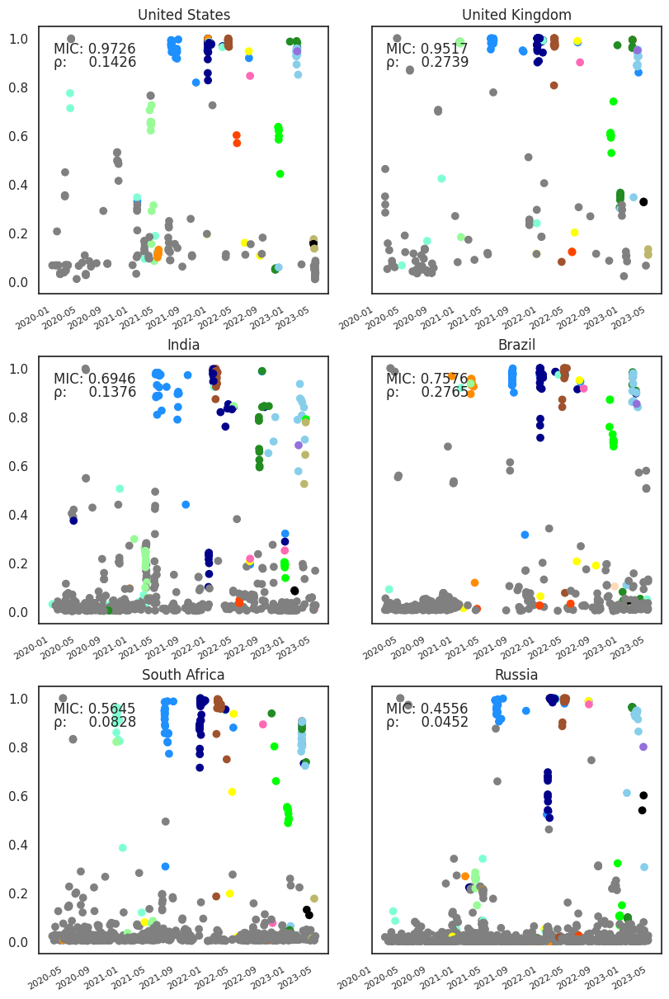

In [167]:
#mainly used
#v2 how about we separate one mutation with multiple peaks???

import numpy as np
from minepy import MINE
import scipy.stats
import matplotlib.dates as mdates

f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()



usa_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2_2['United States of America (the)'], mut_df_multi_peaker(usa_mutations_country_dataframe))
amutlista = usa_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('date', 'max', data=usa_mut_top, c = colorlist)

ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)
gbr_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)'], mut_df_multi_peaker(gbr_mutations_country_dataframe))
amutlista = gbr_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('date', 'max', data=gbr_mut_top, c = colorlist)
ax2.set_title('United Kingdom')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)

ind_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2_2['India'], mut_df_multi_peaker(ind_mutations_country_dataframe))
amutlista = ind_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('date', 'max', data=ind_mut_top, c = colorlist)
ax3.set_title('India')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)


bra_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2_2['Brazil'], mut_df_multi_peaker(bra_mutations_country_dataframe))
amutlista = bra_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('date', 'max', data=bra_mut_top, c = colorlist)
ax4.set_title('Brazil')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)



zaf_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2_2['South Africa'], mut_df_multi_peaker(zaf_mutations_country_dataframe))
amutlista = zaf_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('date', 'max', data=zaf_mut_top, c = colorlist)
ax5.set_title('South Africa')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)


rus_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'], mut_df_multi_peaker(rus_mutations_country_dataframe))
amutlista = rus_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('date', 'max', data=rus_mut_top, c = colorlist)
ax6.set_title('Russia')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)


for i in axes:
    for ax in i:
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('MIC fig v2.png', dpi = 300)
plt.show()

USA MIC 0.9693189747734507
0.22356967503989042
0.21584390735404943


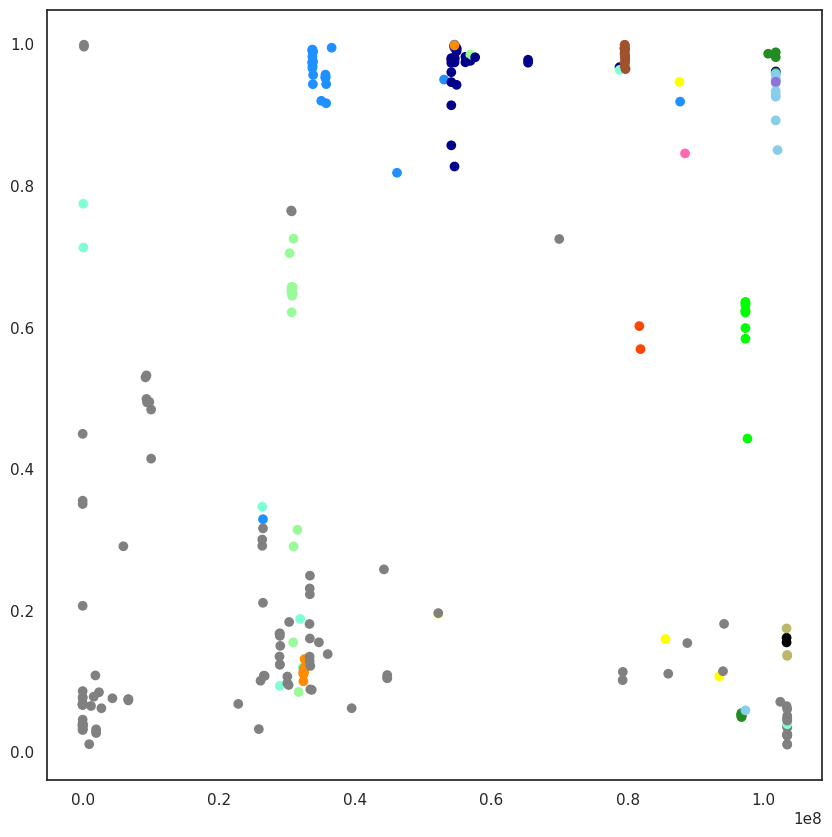

In [168]:
#very close to use
#adapted with version 2
#v2 how about we separate one mutation with multiple peaks???
#how to update to v2:
#if_vacci_related(mut_top_merged, mutlist)
#the mutlist
#if_cases_related(testusa_mut_top_merged, testusa_mut_top_merged['mut'].tolist())

def dataframe_mut_top_merger(mut_top_dataframe, owidmodifile):
    #merge the mut_top_dataframe with owid data, which has daily infection and vaccination data
    owidframe = pd.read_csv(owidmodifile)
    owidframe.thedate = pd.to_datetime(owidframe.thedate)
    owidframe = owidframe.rename(columns = {'thedate':'date'})
    #print(owidframe)
    #print(mut_top_dataframe)
    mut_top_merged = pd.merge(mut_top_dataframe, owidframe, how = 'left')
    
    return mut_top_merged.fillna(0)

def if_vacci_related(mut_top_merged, mutlist):
    xlist = []
    ylist = []
    namelist = mut_top_merged.columns.tolist()
    for what in ['max','days']:
        if what in namelist:
            thename = what
    max_dict = dict(zip(mut_top_merged['mut'], mut_top_merged[thename]))
    
    fst_d_dict = dict(zip(mut_top_merged['mut'], mut_top_merged['people_vaccinated']))
    snd_d_dict = dict(zip(mut_top_merged['mut'], mut_top_merged['people_fully_vaccinated']))
    trd_d_dict = dict(zip(mut_top_merged['mut'], mut_top_merged['total_boosters']))
    
    population = np.argmax(np.bincount(mut_top_merged['population'].tolist()))
    
    #total_cases_dict = dict(zip(mut_top_merged['mut'], mut_top_merged['total_cases']))
    for themut in mutlist:
        xlist.append((fst_d_dict[themut] + snd_d_dict[themut] + trd_d_dict[themut])/population)
        ylist.append(max_dict[themut])
        
    datafm = pd.DataFrame({'mut':mutlist, 'vaccine':xlist, thename:ylist })
    return xlist, ylist, datafm

def if_cases_related(mut_top_merged, mutlist):
    xlist = []
    ylist = []
    namelist = mut_top_merged.columns.tolist()
    for what in ['max','days']:
        if what in namelist:
            thename = what
    max_dict = dict(zip(mut_top_merged['mut'], mut_top_merged[thename]))
    total_cases_dict = dict(zip(mut_top_merged['mut'], mut_top_merged['total_cases']))
    for themut in mutlist:
        xlist.append(total_cases_dict[themut])
        ylist.append(max_dict[themut])
    
    return xlist, ylist

testusa_mut_top_merged = dataframe_mut_top_merger(usa_mut_top, 'owidshrink/USA.csvmodi.csv')
xlist, ylist = if_cases_related(testusa_mut_top_merged, testusa_mut_top_merged['mut'].tolist())

f = plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
amutlista = testusa_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
plt.scatter('total_cases', 'max', data=testusa_mut_top_merged, c = colorlist)



mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])

USA MIC 0.9693189747734507
0.22356967503989042
0.21584390735404943
GBR MIC 0.9516529257024703
0.23437293379257998
0.2738855136704564
IND MIC 0.6944037378470426
0.3023973899213375
0.13760108139586555
BRA MIC 0.724268627310002
0.23380835636490557
0.2771442598364204
ZAF MIC 0.5392833249555061
0.16968520861083236
0.08328023499428523
RUS MIC 0.4555738474286141
0.18783564623535207
0.04516073106172212


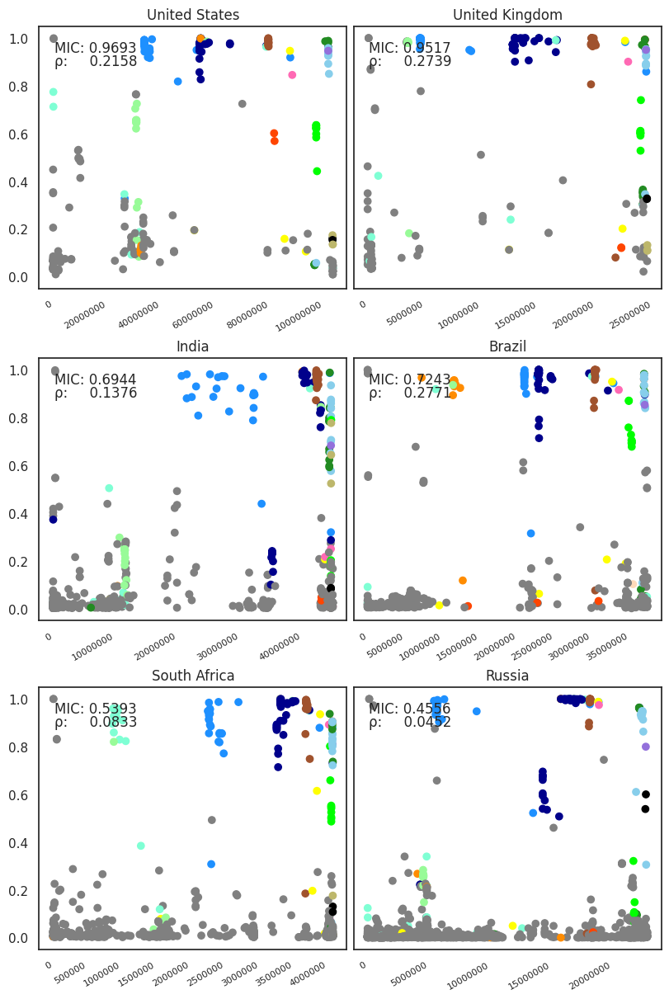

In [169]:
#v2 how about we separate one mutation with multiple peaks???
#mainly used
import numpy as np
from minepy import MINE
import scipy.stats


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_top_merged = dataframe_mut_top_merger(usa_mut_top, 'owidshrink/USA.csvmodi.csv')
xlist, ylist = if_cases_related(usa_mut_top_merged, usa_mut_top_merged['mut'].tolist())
amutlista = usa_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('total_cases', 'max', data=usa_mut_top_merged, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_top_merged = dataframe_mut_top_merger(gbr_mut_top, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist = if_cases_related(gbr_mut_top_merged, gbr_mut_top_merged['mut'].tolist())
amutlista = gbr_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('total_cases', 'max', data=gbr_mut_top_merged, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_top_merged = dataframe_mut_top_merger(ind_mut_top, 'owidshrink/IND.csvmodi.csv')
xlist, ylist = if_cases_related(ind_mut_top_merged, ind_mut_top_merged['mut'].tolist())
amutlista = ind_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('total_cases', 'max', data=ind_mut_top_merged, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_top_merged = dataframe_mut_top_merger(bra_mut_top, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist = if_cases_related(bra_mut_top_merged, bra_mut_top_merged['mut'].tolist())
amutlista = bra_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('total_cases', 'max', data=bra_mut_top_merged, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_top_merged = dataframe_mut_top_merger(zaf_mut_top, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist = if_cases_related(zaf_mut_top_merged, zaf_mut_top_merged['mut'].tolist())
amutlista = zaf_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('total_cases', 'max', data=zaf_mut_top_merged, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_top_merged = dataframe_mut_top_merger(rus_mut_top, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist = if_cases_related(rus_mut_top_merged, rus_mut_top_merged['mut'].tolist())
amutlista = rus_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('total_cases', 'max', data=rus_mut_top_merged, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('total_cases MIC fig v2.png', dpi = 300)
plt.show()

USA MIC 0.8311260464062316
0.383990060775453
0.20657041519359368
GBR MIC 0.8613976427196492
0.37356592643035985
0.28609208549401793
IND MIC 0.5947325875003633
0.21031694022025077
0.13848741376805118
BRA MIC 0.6213499296220418
0.2311261769445536
0.26631235650133184
ZAF MIC 0.4858726942570629
0.14081095693706477
0.08595701538677128
RUS MIC 0.4555738474286141
0.18108750359860232
0.04158375928633634


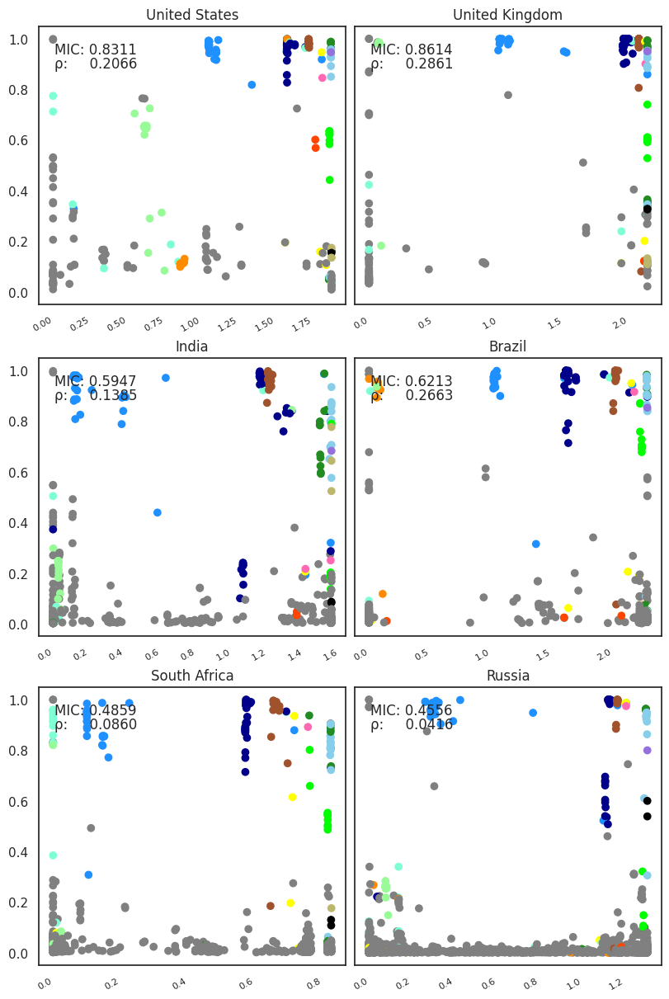

In [170]:
#mainly used
#v2 how about we separate one mutation with multiple peaks???
import numpy as np
from minepy import MINE
import scipy.stats


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_top_merged = dataframe_mut_top_merger(usa_mut_top, 'owidshrink/USA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(usa_mut_top_merged, usa_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_top_merged = dataframe_mut_top_merger(gbr_mut_top, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(gbr_mut_top_merged, gbr_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_top_merged = dataframe_mut_top_merger(ind_mut_top, 'owidshrink/IND.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(ind_mut_top_merged, ind_mut_top_merged['mut'].tolist())
amutlista = ind_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_top_merged = dataframe_mut_top_merger(bra_mut_top, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(bra_mut_top_merged, bra_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_top_merged = dataframe_mut_top_merger(zaf_mut_top, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(zaf_mut_top_merged, zaf_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_top_merged = dataframe_mut_top_merger(rus_mut_top, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(rus_mut_top_merged,rus_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('vacci MIC pop fig v2.png', dpi = 300)
plt.show()

In [171]:
len([col for col in bra_mutations_country_dataframe])

431

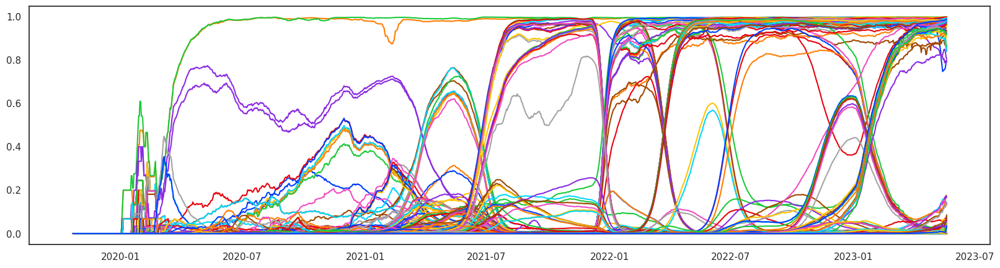

In [172]:
def dataframe_show(mutlist, mutdf):
    f = plt.figure()
    f.set_figwidth(20)
    f.set_figheight(5)
    ax1 = f.add_subplot()
    for mut in mutlist:
        ll = ax1.plot(mutdf.date, mutdf[[mut]])
    plt.show()

dataframe_show(nation_mostprevalent_mutlist_v2_2['United States of America (the)'], usatest3)

USA MIC 0.836508190075015
-0.07286018557628218
-0.02407903602263491
GBR MIC 0.8035510891369573
0.08336107177741935
0.2751217176940763
IND MIC 0.5459863545575607
-0.1328291282654152
0.046392957841659505
BRA MIC 0.5940966558147696
-0.1807225215676554
-0.0564001232334993
ZAF MIC 0.4529218042219644
-0.09283535185187733
0.05604628677213359
RUS MIC 0.38074137141775455
0.17764368948251533
0.27910819856590235


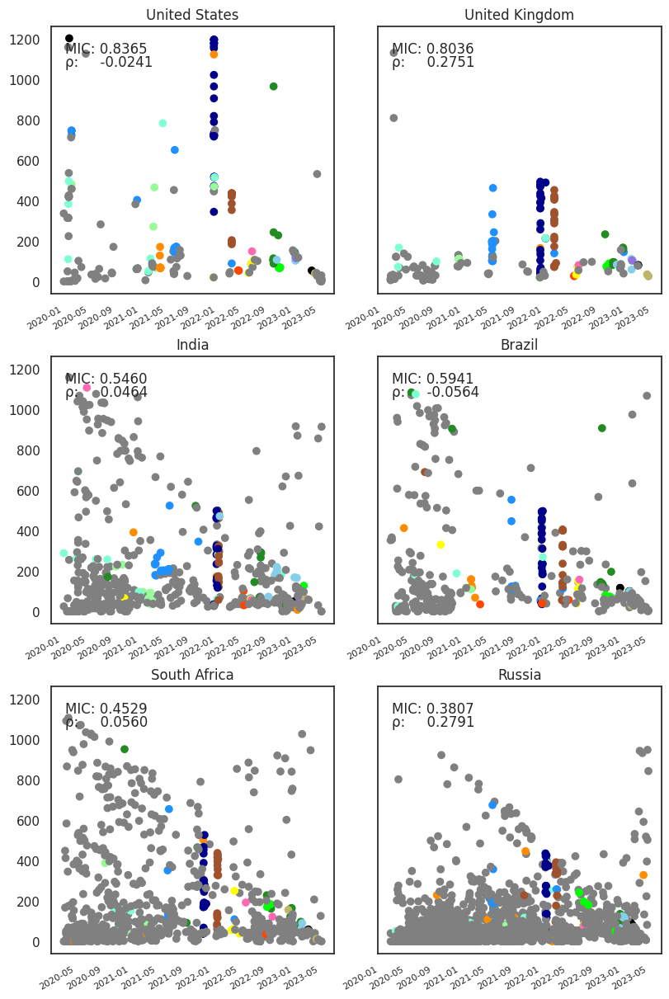

In [173]:
#try to find the relation between mutations circulating duration with time 

import numpy as np
from minepy import MINE
import scipy.stats
import matplotlib.dates as mdates

f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()



usa_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2_2['United States of America (the)'], mut_df_multi_peaker(usa_mutations_country_dataframe))
amutlista = usa_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('date', 'days', data=usa_mut_duration, c = colorlist)

ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)
gbr_mut_duration, xlist, ylist =  dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2_2['United Kingdom of Great Britain and Northern Ireland (the)'], mut_df_multi_peaker(gbr_mutations_country_dataframe))
amutlista = gbr_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('date', 'days', data=gbr_mut_duration, c = colorlist)
ax2.set_title('United Kingdom')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)

ind_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2_2['India'], mut_df_multi_peaker(ind_mutations_country_dataframe))
amutlista = ind_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('date', 'days', data=ind_mut_duration, c = colorlist)
ax3.set_title('India')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)


bra_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2_2['Brazil'], mut_df_multi_peaker(bra_mutations_country_dataframe))
amutlista = bra_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('date', 'days', data=bra_mut_duration, c = colorlist)
ax4.set_title('Brazil')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)



zaf_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2_2['South Africa'], mut_df_multi_peaker(zaf_mutations_country_dataframe))
amutlista = zaf_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('date', 'days', data=zaf_mut_duration, c = colorlist)
ax5.set_title('South Africa')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)


rus_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2_2['Russian Federation (the)'], mut_df_multi_peaker(rus_mutations_country_dataframe))
amutlista = rus_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('date', 'days', data=rus_mut_duration, c = colorlist)
ax6.set_title('Russia')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)


for i in axes:
    for ax in i:
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('duration MIC fig v2.png', dpi = 300)
plt.show()

USA MIC 0.8247255164450524
-0.09806463878287251
-0.023853764469446738
GBR MIC 0.8035510891369573
0.0764607855801613
0.2751217176940763
IND MIC 0.5459863545575607
-0.12286363486332813
0.04647516512791249
BRA MIC 0.5869274411752659
-0.17871527256611094
-0.056318385509234806
ZAF MIC 0.4293136935132111
-0.077900725571973
0.055993158439629445
RUS MIC 0.38074137141775455
0.14850995451135846
0.2791049163943999


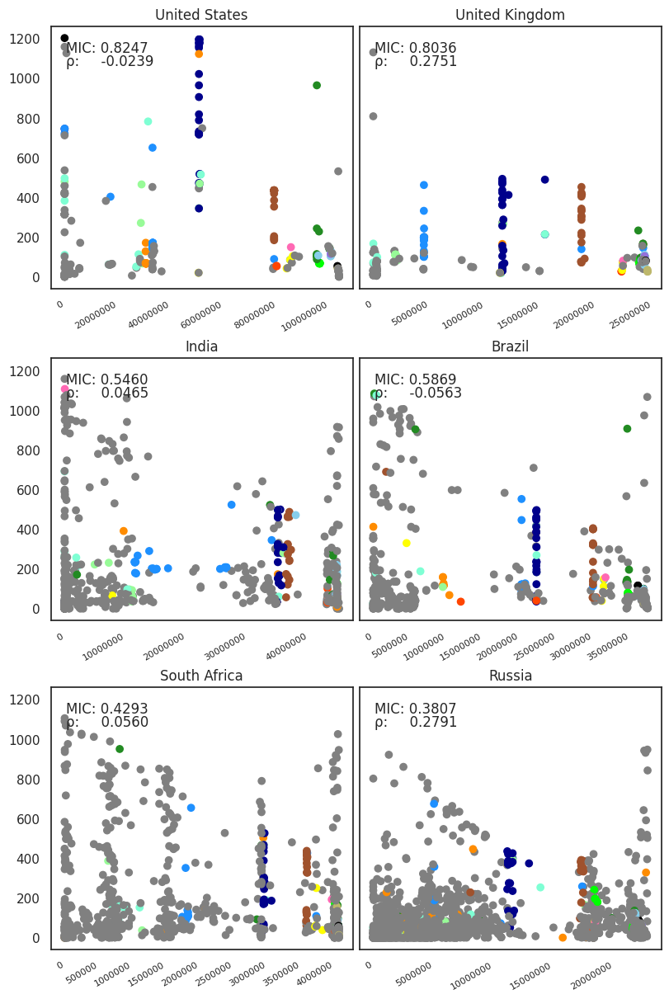

In [174]:
f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_duration_merged = dataframe_mut_top_merger(usa_mut_duration, 'owidshrink/USA.csvmodi.csv')
xlist, ylist = if_cases_related(usa_mut_duration_merged, usa_mut_duration_merged['mut'].tolist())
amutlista = usa_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('total_cases', 'days', data=usa_mut_duration_merged, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_duration_merged = dataframe_mut_top_merger(gbr_mut_duration, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist = if_cases_related(gbr_mut_duration_merged, gbr_mut_duration_merged['mut'].tolist())
amutlista = gbr_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('total_cases', 'days', data=gbr_mut_duration_merged, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_duration_merged = dataframe_mut_top_merger(ind_mut_duration, 'owidshrink/IND.csvmodi.csv')
xlist, ylist = if_cases_related(ind_mut_duration_merged, ind_mut_duration_merged['mut'].tolist())
amutlista = ind_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('total_cases', 'days', data=ind_mut_duration_merged, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_duration_merged = dataframe_mut_top_merger(bra_mut_duration, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist = if_cases_related(bra_mut_duration_merged, bra_mut_duration_merged['mut'].tolist())
amutlista = bra_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('total_cases', 'days', data=bra_mut_duration_merged, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_duration_merged = dataframe_mut_top_merger(zaf_mut_duration, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist = if_cases_related(zaf_mut_duration_merged, zaf_mut_duration_merged['mut'].tolist())
amutlista = zaf_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('total_cases', 'days', data=zaf_mut_duration_merged, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_duration_merged = dataframe_mut_top_merger(rus_mut_duration, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist = if_cases_related(rus_mut_duration_merged, rus_mut_duration_merged['mut'].tolist())
amutlista = rus_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('total_cases', 'days', data=rus_mut_duration_merged, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('duration total_cases MIC fig v2.png', dpi = 300)
plt.show()

USA MIC 0.738866103446595
0.09372628513335687
-0.006198250735512834
GBR MIC 0.6695775338685508
0.19282072777919004
0.24479911934030124
IND MIC 0.4534076410563993
-0.11869984323509584
0.0029567249706817992
BRA MIC 0.5555923643316798
-0.1639170962585349
-0.04398292067111204
ZAF MIC 0.35990229226756854
-0.07577487917038407
0.021529839596990993
RUS MIC 0.32832215719020447
0.16418711160485577
0.2588371572384891


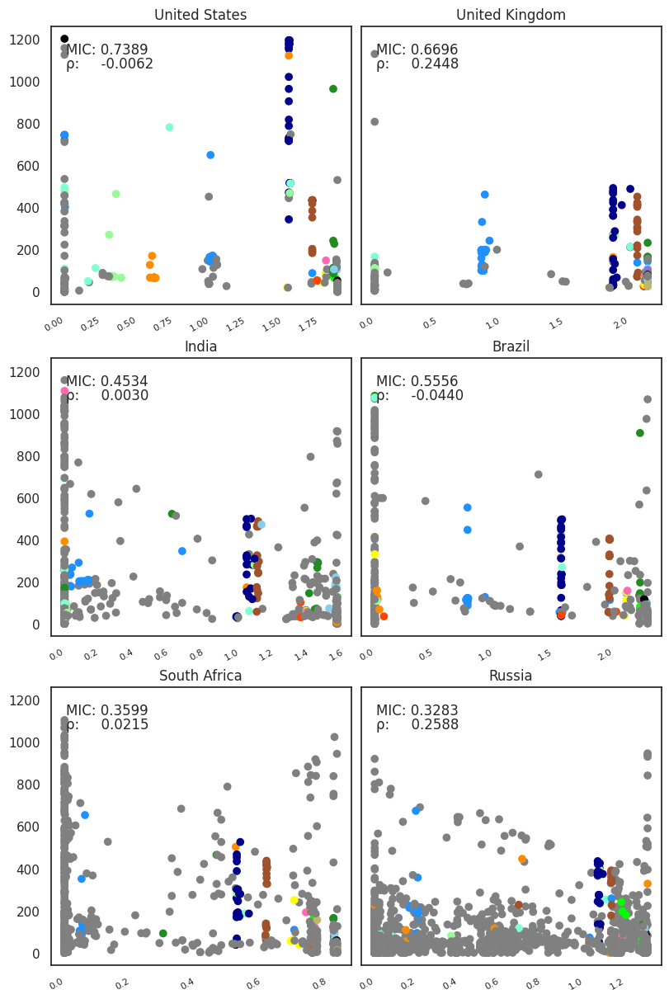

In [175]:
#mainly used
#v2 how about we separate one mutation with multiple peaks???
import numpy as np
from minepy import MINE
import scipy.stats


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_duration_merged = dataframe_mut_top_merger(usa_mut_duration, 'owidshrink/USA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(usa_mut_duration_merged, usa_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_duration_merged = dataframe_mut_top_merger(gbr_mut_duration, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(gbr_mut_duration_merged, gbr_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_duration_merged = dataframe_mut_top_merger(ind_mut_duration, 'owidshrink/IND.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(ind_mut_duration_merged, ind_mut_duration_merged['mut'].tolist())
amutlista = ind_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_duration_merged = dataframe_mut_top_merger(bra_mut_duration, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(bra_mut_duration_merged, bra_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_duration_merged = dataframe_mut_top_merger(zaf_mut_duration, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(zaf_mut_duration_merged, zaf_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_duration_merged = dataframe_mut_top_merger(rus_mut_duration, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(rus_mut_duration_merged,rus_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('duration vacci MIC pop fig v2.png', dpi = 300)
plt.show()

In [176]:
xx = usatest4['orf1ab.3352.ttt'].to_list()

USA MIC 0.8161489369139542
0.35008011938212624
0.31176185412414664
GBR MIC 0.8680467280972909
-0.13566901181036572
-0.20033825189921403
IND MIC 0.9656926437541667
0.20641580461091258
0.15317537489043784
BRA MIC 0.7580601856446957
-0.25527090881451425
-0.2566906242530351
ZAF MIC 0.9121774661682401
0.2811779457061127
0.2314429430252365
RUS MIC 0.9441002035588898
0.30789428596780316
0.3511954994290519


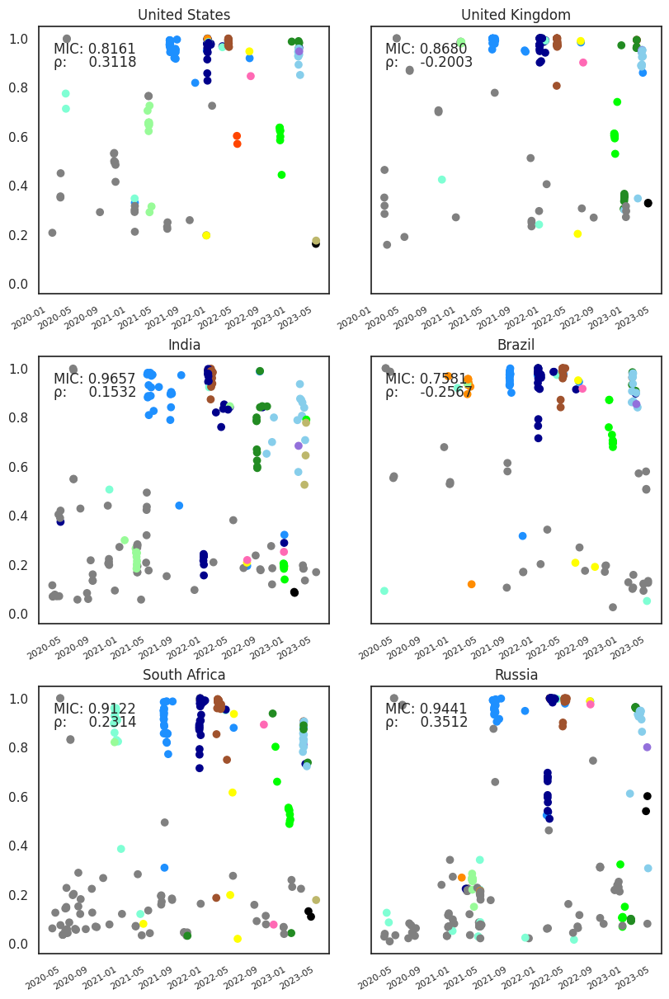

In [177]:
#mainly used
#nation_mostprevalent_mutlist_v2??????????????????????????
#v2 how about we separate one mutation with multiple peaks???
import warnings
warnings.filterwarnings('ignore')

import numpy as np
from minepy import MINE
import scipy.stats
import matplotlib.dates as mdates

f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()



usa_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2['United States of America (the)'], mut_df_multi_peaker(usa_mutations_country_dataframe))
amutlista = usa_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('date', 'max', data=usa_mut_top, c = colorlist)

ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)
gbr_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2['United Kingdom of Great Britain and Northern Ireland (the)'], mut_df_multi_peaker(gbr_mutations_country_dataframe))
amutlista = gbr_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('date', 'max', data=gbr_mut_top, c = colorlist)
ax2.set_title('United Kingdom')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)

ind_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2['India'], mut_df_multi_peaker(ind_mutations_country_dataframe))
amutlista = ind_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('date', 'max', data=ind_mut_top, c = colorlist)
ax3.set_title('India')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)


bra_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2['Brazil'], mut_df_multi_peaker(bra_mutations_country_dataframe))
amutlista = bra_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('date', 'max', data=bra_mut_top, c = colorlist)
ax4.set_title('Brazil')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)



zaf_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2['South Africa'], mut_df_multi_peaker(zaf_mutations_country_dataframe))
amutlista = zaf_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('date', 'max', data=zaf_mut_top, c = colorlist)
ax5.set_title('South Africa')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)


rus_mut_top, xlist, ylist = dataframe_mut_top_define_v2(nation_mostprevalent_mutlist_v2['Russian Federation (the)'], mut_df_multi_peaker(rus_mutations_country_dataframe))
amutlista = rus_mut_top.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('date', 'max', data=rus_mut_top, c = colorlist)
ax6.set_title('Russia')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)


for i in axes:
    for ax in i:
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('MIC fig v2v2v2v2v2.png', dpi = 600)
plt.savefig('MIC fig v2v2v2v2v2.pdf', dpi = 600)
plt.savefig('MIC fig v2v2v2v2v2.svg', dpi = 600)
plt.show()
plt.close()

USA MIC 0.7888667370931342
0.3365731936147775
0.31106031404106177
GBR MIC 0.8680467280972909
-0.1813918950427712
-0.20033825189921403
IND MIC 0.9656926437541667
0.4143196600745854
0.15317537489043784
BRA MIC 0.7580601856446957
-0.21859598056917337
-0.25649126870686784
ZAF MIC 0.8884484348753745
0.3779917414687672
0.23094970731759337
RUS MIC 0.9441002035588898
0.3431864024703897
0.3511954994290519


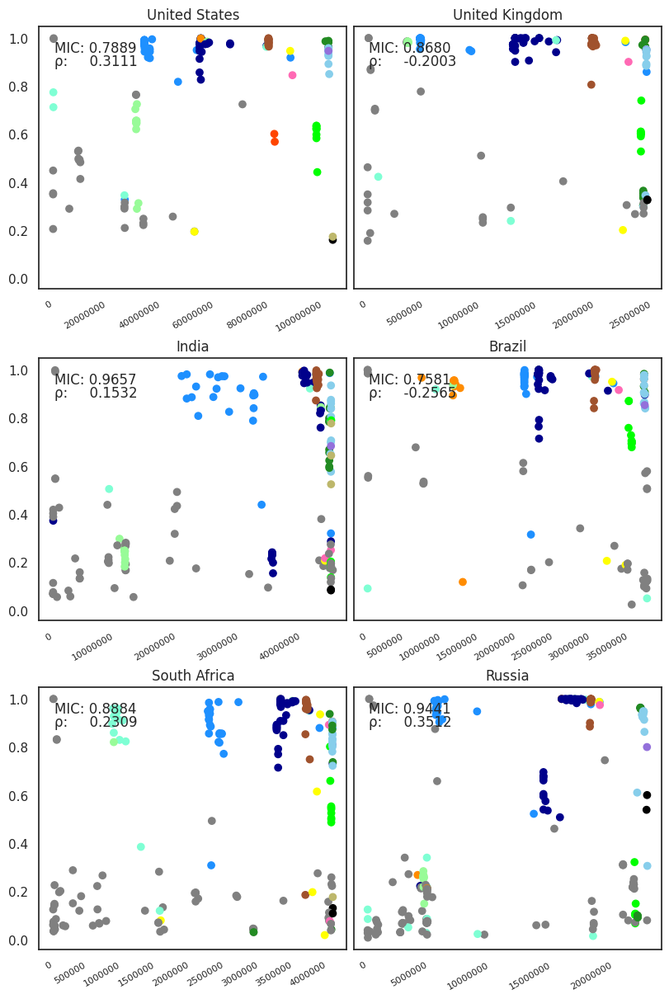

In [178]:
#v2 how about we separate one mutation with multiple peaks???
#nation_mostprevalent_mutlist_v2??????????????????????????
#mainly used
import numpy as np
from minepy import MINE
import scipy.stats


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_top_merged = dataframe_mut_top_merger(usa_mut_top, 'owidshrink/USA.csvmodi.csv')
xlist, ylist = if_cases_related(usa_mut_top_merged, usa_mut_top_merged['mut'].tolist())
amutlista = usa_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('total_cases', 'max', data=usa_mut_top_merged, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_top_merged = dataframe_mut_top_merger(gbr_mut_top, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist = if_cases_related(gbr_mut_top_merged, gbr_mut_top_merged['mut'].tolist())
amutlista = gbr_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('total_cases', 'max', data=gbr_mut_top_merged, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_top_merged = dataframe_mut_top_merger(ind_mut_top, 'owidshrink/IND.csvmodi.csv')
xlist, ylist = if_cases_related(ind_mut_top_merged, ind_mut_top_merged['mut'].tolist())
amutlista = ind_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('total_cases', 'max', data=ind_mut_top_merged, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_top_merged = dataframe_mut_top_merger(bra_mut_top, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist = if_cases_related(bra_mut_top_merged, bra_mut_top_merged['mut'].tolist())
amutlista = bra_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('total_cases', 'max', data=bra_mut_top_merged, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_top_merged = dataframe_mut_top_merger(zaf_mut_top, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist = if_cases_related(zaf_mut_top_merged, zaf_mut_top_merged['mut'].tolist())
amutlista = zaf_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('total_cases', 'max', data=zaf_mut_top_merged, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_top_merged = dataframe_mut_top_merger(rus_mut_top, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist = if_cases_related(rus_mut_top_merged, rus_mut_top_merged['mut'].tolist())
amutlista = rus_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('total_cases', 'max', data=rus_mut_top_merged, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('total_cases MIC fig v2v2v2v2v2v2v2.png', dpi = 600)
plt.savefig('total_cases MIC fig v2v2v2v2v2v2v2.pdf', dpi = 600)
plt.savefig('total_cases MIC fig v2v2v2v2v2v2v2.svg', dpi = 600)

plt.show()
plt.close()

USA MIC 0.76110443633678
0.5216793671096078
0.31262007887533577
GBR MIC 0.8168561100352812
-0.037110584283079576
-0.2002990185832627
IND MIC 0.9082561955028216
0.2556547688972115
0.15220570643783984
BRA MIC 0.6904678111298123
-0.17620345100882534
-0.25392009732550586
ZAF MIC 0.7070938002533979
0.29457310140100035
0.20794691624349448
RUS MIC 0.8854068625111371
0.4108538393331615
0.35290564159163695


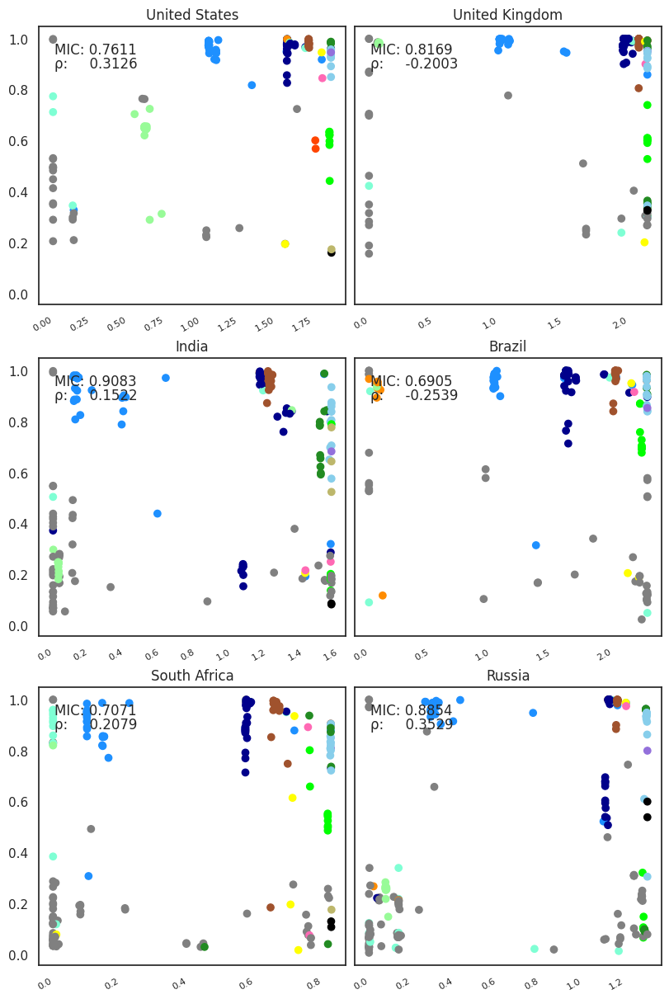

In [179]:
#mainly used
#nation_mostprevalent_mutlist_v2??????????????????????????
#v2 how about we separate one mutation with multiple peaks???
import numpy as np
from minepy import MINE
import scipy.stats


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_top_merged = dataframe_mut_top_merger(usa_mut_top, 'owidshrink/USA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(usa_mut_top_merged, usa_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_top_merged = dataframe_mut_top_merger(gbr_mut_top, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(gbr_mut_top_merged, gbr_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_top_merged = dataframe_mut_top_merger(ind_mut_top, 'owidshrink/IND.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(ind_mut_top_merged, ind_mut_top_merged['mut'].tolist())
amutlista = ind_mut_top_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_top_merged = dataframe_mut_top_merger(bra_mut_top, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(bra_mut_top_merged, bra_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_top_merged = dataframe_mut_top_merger(zaf_mut_top, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(zaf_mut_top_merged, zaf_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_top_merged = dataframe_mut_top_merger(rus_mut_top, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(rus_mut_top_merged,rus_mut_top_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('vaccine', 'max', data=vcdff, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('vacci MIC pop fig v2v2v2v2v2v2.png', dpi = 600)
plt.savefig('vacci MIC pop fig v2v2v2v2v2v2.pdf', dpi = 600)
plt.savefig('vacci MIC pop fig v2v2v2v2v2v2.svg', dpi = 600)
plt.show()
plt.close()

USA MIC 0.8584992154615637
-0.07253146029617143
-0.031291151243753174
GBR MIC 0.7337980969461344
-0.13225182458520265
-0.07390558920762297
IND MIC 0.8134344988520888
0.050121861142883195
0.07341760912604482
BRA MIC 0.7343481964871519
-0.36636270472674654
-0.3487072594528944
ZAF MIC 0.7040509751852078
0.014703684266131677
0.12018648668229152
RUS MIC 0.8512977251102162
0.03261340124859275
0.13009863530123622


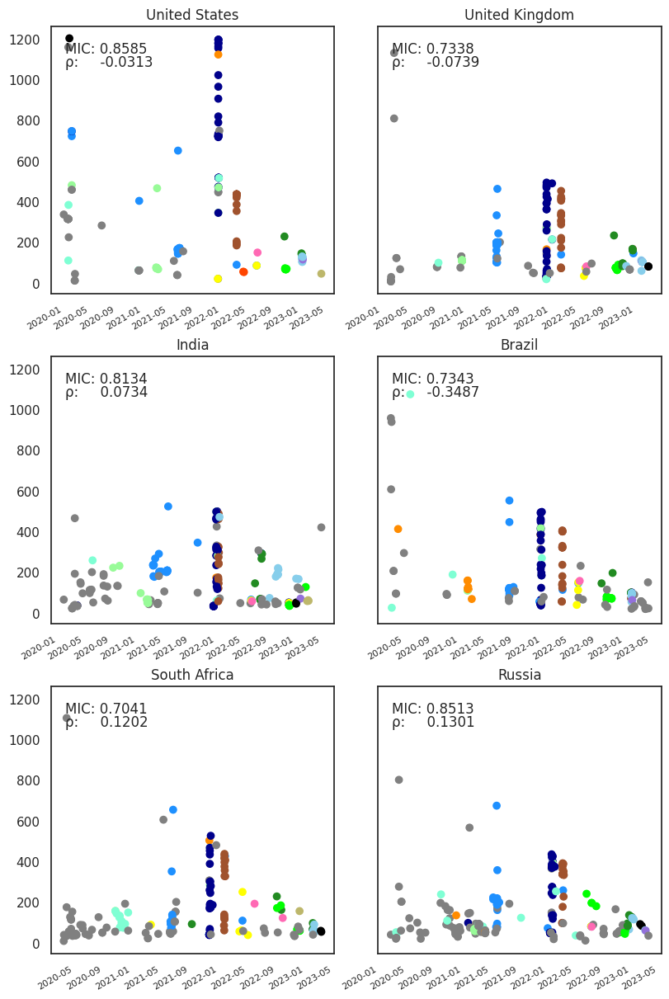

In [180]:
#try to find the relation between mutations circulating duration with time 
#nation_mostprevalent_mutlist_v2??????????????????????????
import numpy as np
from minepy import MINE
import scipy.stats
import matplotlib.dates as mdates

f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()



usa_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2['United States of America (the)'], mut_df_multi_peaker(usa_mutations_country_dataframe))
amutlista = usa_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('date', 'days', data=usa_mut_duration, c = colorlist)

ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)
gbr_mut_duration, xlist, ylist =  dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2['United Kingdom of Great Britain and Northern Ireland (the)'], mut_df_multi_peaker(gbr_mutations_country_dataframe))
amutlista = gbr_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('date', 'days', data=gbr_mut_duration, c = colorlist)
ax2.set_title('United Kingdom')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)

ind_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2['India'], mut_df_multi_peaker(ind_mutations_country_dataframe))
amutlista = ind_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('date', 'days', data=ind_mut_duration, c = colorlist)
ax3.set_title('India')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)


bra_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2['Brazil'], mut_df_multi_peaker(bra_mutations_country_dataframe))
amutlista = bra_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('date', 'days', data=bra_mut_duration, c = colorlist)
ax4.set_title('Brazil')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)



zaf_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2['South Africa'], mut_df_multi_peaker(zaf_mutations_country_dataframe))
amutlista = zaf_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('date', 'days', data=zaf_mut_duration, c = colorlist)
ax5.set_title('South Africa')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)


rus_mut_duration, xlist, ylist = dataframe_mut_time_occupied_define(nation_mostprevalent_mutlist_v2['Russian Federation (the)'], mut_df_multi_peaker(rus_mutations_country_dataframe))
amutlista = rus_mut_duration.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('date', 'days', data=rus_mut_duration, c = colorlist)
ax6.set_title('Russia')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)


for i in axes:
    for ax in i:
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('duration MIC fig v2v2v2v2v2v2v2v2.png', dpi = 600)
plt.savefig('duration MIC fig v2v2v2v2v2v2v2v2.pdf', dpi = 600)
plt.savefig('duration MIC fig v2v2v2v2v2v2v2v2.svg', dpi = 600)
plt.show()
plt.close()

USA MIC 0.8580721537864394
-0.12892528561706454
-0.03093243383844949
GBR MIC 0.7337980969461344
-0.10526265228688392
-0.07390558920762297
IND MIC 0.8134344988520888
0.13762411542054165
0.07341760912604482
BRA MIC 0.7343481964871519
-0.3459206814664503
-0.34855183866124884
ZAF MIC 0.7040509751852078
0.11269858307606632
0.12060513275210397
RUS MIC 0.8512977251102162
0.03850786998010122
0.13009863530123622


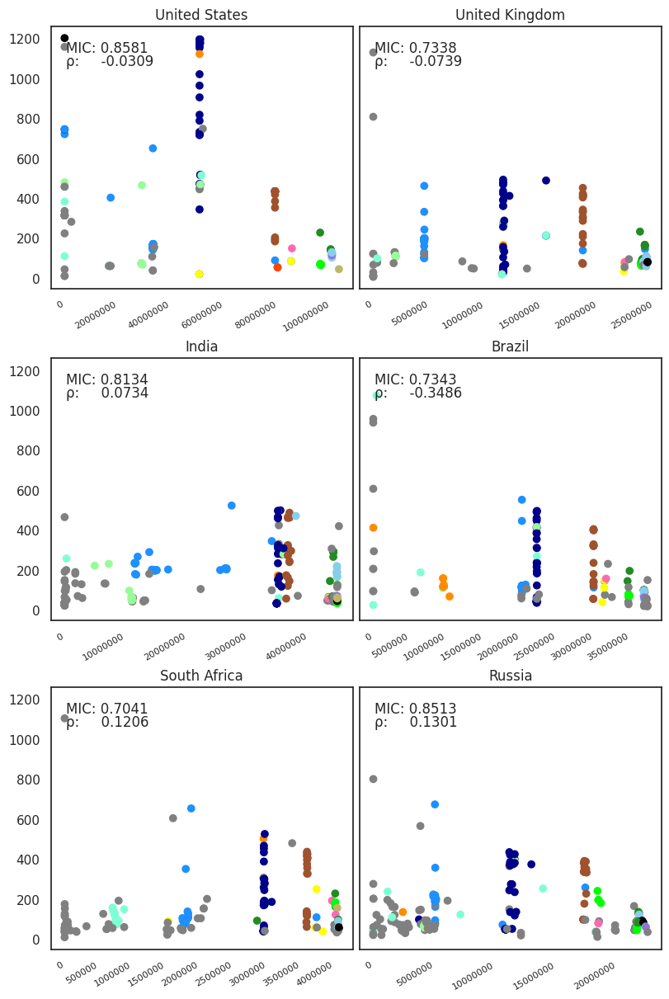

In [181]:
f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_duration_merged = dataframe_mut_top_merger(usa_mut_duration, 'owidshrink/USA.csvmodi.csv')
xlist, ylist = if_cases_related(usa_mut_duration_merged, usa_mut_duration_merged['mut'].tolist())
amutlista = usa_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('total_cases', 'days', data=usa_mut_duration_merged, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_duration_merged = dataframe_mut_top_merger(gbr_mut_duration, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist = if_cases_related(gbr_mut_duration_merged, gbr_mut_duration_merged['mut'].tolist())
amutlista = gbr_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('total_cases', 'days', data=gbr_mut_duration_merged, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_duration_merged = dataframe_mut_top_merger(ind_mut_duration, 'owidshrink/IND.csvmodi.csv')
xlist, ylist = if_cases_related(ind_mut_duration_merged, ind_mut_duration_merged['mut'].tolist())
amutlista = ind_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('total_cases', 'days', data=ind_mut_duration_merged, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_duration_merged = dataframe_mut_top_merger(bra_mut_duration, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist = if_cases_related(bra_mut_duration_merged, bra_mut_duration_merged['mut'].tolist())
amutlista = bra_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('total_cases', 'days', data=bra_mut_duration_merged, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_duration_merged = dataframe_mut_top_merger(zaf_mut_duration, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist = if_cases_related(zaf_mut_duration_merged, zaf_mut_duration_merged['mut'].tolist())
amutlista = zaf_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('total_cases', 'days', data=zaf_mut_duration_merged, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_duration_merged = dataframe_mut_top_merger(rus_mut_duration, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist = if_cases_related(rus_mut_duration_merged, rus_mut_duration_merged['mut'].tolist())
amutlista = rus_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('total_cases', 'days', data=rus_mut_duration_merged, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('duration total_cases MIC fig v2v2v2v2v2v2v2.png', dpi = 600)
plt.savefig('duration total_cases MIC fig v2v2v2v2v2v2v2.pdf', dpi = 600)
plt.savefig('duration total_cases MIC fig v2v2v2v2v2v2v2.svg', dpi = 600)
plt.show()
plt.close()

USA MIC 0.8580721537864394
0.1174762662213643
-0.02675609531227502
GBR MIC 0.7337980969461344
0.011209590649946841
-0.08628008155206503
IND MIC 0.7248060317946962
0.07940309830848498
0.06046559403396147
BRA MIC 0.7343481964871519
-0.21830487334011492
-0.34604457949808015
ZAF MIC 0.7040509751852078
0.08834888811676876
0.09853289623893695
RUS MIC 0.731190572480152
0.15976195066621
0.13217263680592564


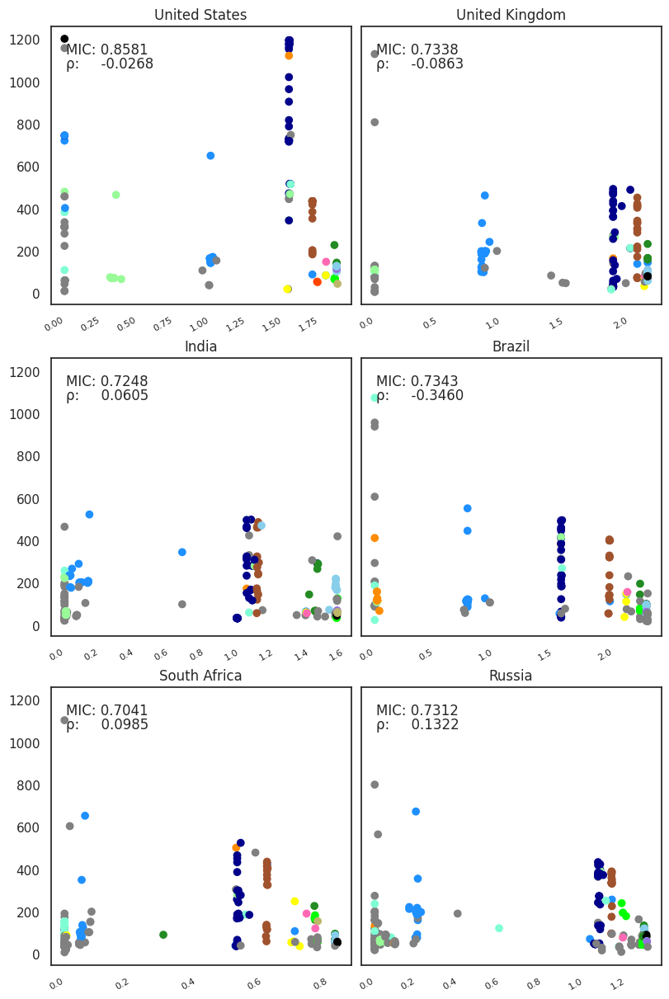

In [182]:
#mainly used
#v2 how about we separate one mutation with multiple peaks???
import numpy as np
from minepy import MINE
import scipy.stats


f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")

ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()


#ax1.get_yaxis().set_visible(False)
#ax3.get_yaxis().set_visible(False)
#ax5.get_yaxis().set_visible(False)
#ax5.get_xaxis().set_visible(False)
#ax6.get_xaxis().set_visible(False)


usa_mut_duration_merged = dataframe_mut_top_merger(usa_mut_duration, 'owidshrink/USA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(usa_mut_duration_merged, usa_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)





gbr_mut_duration_merged = dataframe_mut_top_merger(gbr_mut_duration, 'owidshrink/GBR.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(gbr_mut_duration_merged, gbr_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax2.set_title('United Kingdom')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)





ind_mut_duration_merged = dataframe_mut_top_merger(ind_mut_duration, 'owidshrink/IND.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(ind_mut_duration_merged, ind_mut_duration_merged['mut'].tolist())
amutlista = ind_mut_duration_merged.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax3.set_title('India')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)





bra_mut_duration_merged = dataframe_mut_top_merger(bra_mut_duration, 'owidshrink/BRA.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(bra_mut_duration_merged, bra_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax4.set_title('Brazil')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)





zaf_mut_duration_merged = dataframe_mut_top_merger(zaf_mut_duration, 'owidshrink/ZAF.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(zaf_mut_duration_merged, zaf_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax5.set_title('South Africa')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)




rus_mut_duration_merged = dataframe_mut_top_merger(rus_mut_duration, 'owidshrink/RUS.csvmodi.csv')
xlist, ylist, vcdff = if_vacci_related(rus_mut_duration_merged,rus_mut_duration_merged['mut'].tolist())
amutlista = vcdff.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('vaccine', 'days', data=vcdff, c = colorlist)
ax6.set_title('Russia')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)

for i in axes:
    for ax in i:
        ax.get_xaxis().get_major_formatter().set_scientific(False)
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('duration vacci MIC pop fig v2v2v2v2v2v2.png', dpi = 600)
plt.savefig('duration vacci MIC pop fig v2v2v2v2v2v2.pdf', dpi = 600)
plt.savefig('duration vacci MIC pop fig v2v2v2v2v2v2.svg', dpi = 600)
plt.show()
plt.close()

orf1ab.5865.tgt
USA MIC 0.941249200317613
-0.2595099489495148
-0.14256447266911582
GBR MIC 0.8796621529313822
-0.3216117784848367
-0.42337455264450746
ORF8.84.tca
orf1ab.378.ata
orf1ab.207.tgt
orf1ab.2796.att
N.202.aat
orf1ab.2015.aga
orf1ab.7096.ctc
S.460.aaa
orf1ab.5592.agt
IND MIC 0.8952482530086724
-0.009768685600553943
0.04451686700257314
orf1ab.4068.tcc
S.455.ttt
orf1ab.3595.ttc
BRA MIC 0.9998952874186198
0.1188114750796955
0.11388728523496476
ORF3a.251.gtt
ZAF MIC 0.8671433296393952
0.22075075925699672
0.2686312984505361
S.719.tct
RUS MIC 0.8539212831851843
-0.08860668748295952
-0.03644792027930182


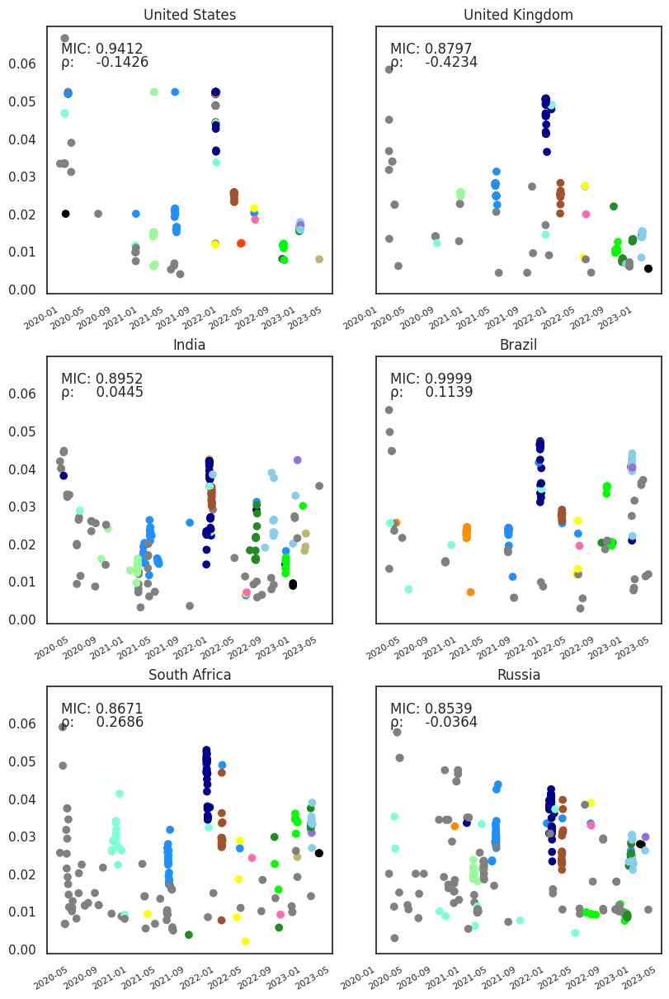

In [183]:
#mainly used
#nation_mostprevalent_mutlist_v2??????????????????????????
#v2 how about we separate one mutation with multiple peaks???
#the max growth rate

import numpy as np
from minepy import MINE
import scipy.stats
import matplotlib.dates as mdates

f, axes = plt.subplots(nrows=3, ncols=2,figsize=(8,12), sharey=True,sharex = False,layout="constrained")
ax1, ax2, ax3, ax4, ax5, ax6 = axes.flatten()



usa_mut_mxgrowth, xlist, ylist = dataframe_mut_growth_rate_define(nation_mostprevalent_mutlist_v2['United States of America (the)'], mut_df_multi_peaker(usa_mutations_country_dataframe),pd.read_csv('tmp/United States of America (the).slope_df.csv'))
amutlista = usa_mut_mxgrowth.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l1 = ax1.scatter('date', 'growth_rate', data=usa_mut_mxgrowth, c = colorlist)

ax1.set_title('United States')
#ax1.text(-1,-1,'MIC: 0.9')
def print_stats(iso, mine):
    print(iso, "MIC", mine.mic())
mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('USA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax1.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax1.transAxes)
ax1.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax1.transAxes)
gbr_mut_mxgrowth, xlist, ylist = dataframe_mut_growth_rate_define(nation_mostprevalent_mutlist_v2['United Kingdom of Great Britain and Northern Ireland (the)'], mut_df_multi_peaker(gbr_mutations_country_dataframe),pd.read_csv('tmp/United Kingdom of Great Britain and Northern Ireland (the).slope_df.csv'))
amutlista = gbr_mut_mxgrowth.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l2 = ax2.scatter('date', 'growth_rate', data=gbr_mut_mxgrowth, c = colorlist)
ax2.set_title('United Kingdom')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('GBR',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax2.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax2.transAxes)
ax2.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax2.transAxes)

ind_mut_mxgrowth, xlist, ylist = dataframe_mut_growth_rate_define(nation_mostprevalent_mutlist_v2['India'], mut_df_multi_peaker(ind_mutations_country_dataframe),pd.read_csv("tmp/India.slope_df.csv"))
amutlista = ind_mut_mxgrowth.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l3 = ax3.scatter('date', 'growth_rate', data=ind_mut_mxgrowth, c = colorlist)
ax3.set_title('India')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('IND',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax3.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax3.transAxes)
ax3.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax3.transAxes)


bra_mut_mxgrowth, xlist, ylist = dataframe_mut_growth_rate_define(nation_mostprevalent_mutlist_v2['Brazil'], mut_df_multi_peaker(bra_mutations_country_dataframe),pd.read_csv('tmp/Brazil.slope_df.csv'))
amutlista = bra_mut_mxgrowth.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l4 = ax4.scatter('date', 'growth_rate', data=bra_mut_mxgrowth, c = colorlist)
ax4.set_title('Brazil')


mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('BRA',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax4.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax4.transAxes)
ax4.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax4.transAxes)



zaf_mut_mxgrowth, xlist, ylist = dataframe_mut_growth_rate_define(nation_mostprevalent_mutlist_v2['South Africa'], mut_df_multi_peaker(zaf_mutations_country_dataframe), pd.read_csv('tmp/South Africa.slope_df.csv'))
amutlista = zaf_mut_mxgrowth.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l5 = ax5.scatter('date', 'growth_rate', data=zaf_mut_mxgrowth, c = colorlist)
ax5.set_title('South Africa')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('ZAF',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax5.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax5.transAxes)
ax5.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax5.transAxes)


rus_mut_mxgrowth, xlist, ylist = dataframe_mut_growth_rate_define(nation_mostprevalent_mutlist_v2['Russian Federation (the)'], mut_df_multi_peaker(rus_mutations_country_dataframe), pd.read_csv('tmp/Russian Federation (the).slope_df.csv'))
amutlista = rus_mut_mxgrowth.mut.to_list()
colorlist = [which_color(mut, vocplate, unic, 'gray') for mut in amutlista]
l6 = ax6.scatter('date', 'growth_rate', data=rus_mut_mxgrowth, c = colorlist)
ax6.set_title('Russia')

mine = MINE(alpha=0.8, c=15)
mine.compute_score(xlist, ylist)
print_stats('RUS',mine)
print(scipy.stats.pearsonr(xlist, ylist)[0])
print(scipy.stats.spearmanr(xlist, ylist)[0])
ax6.text(0.05, 0.9, 'MIC: ' + str(format(mine.mic(), '.4f')), horizontalalignment='left', transform=ax6.transAxes)
ax6.text(0.05, 0.85, 'ρ:     ' + str(format(scipy.stats.spearmanr(xlist, ylist)[0], '.4f')), horizontalalignment='left', transform=ax6.transAxes)


for i in axes:
    for ax in i:
        #ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(ax.xaxis.get_major_locator()))
        ax.xaxis.set_tick_params(#rotation=30,
            labelsize=8)
        for label in ax.get_xticklabels(which='major'):
            label.set(rotation=30,
                      horizontalalignment='right')

plt.savefig('growth MIC fig v2v2v2v2v2.png', dpi = 300)
plt.show()

In [184]:
#https://matplotlib.org/stable/gallery/images_contours_and_fields/image_annotated_heatmap.html
import numpy as np
import matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt

def heatmap(data, row_labels, col_labels, ax=None,
            cbar_kw=None, cbarlabel="", **kwargs):
    """
    Create a heatmap from a numpy array and two lists of labels.

    Parameters
    ----------
    data
        A 2D numpy array of shape (M, N).
    row_labels
        A list or array of length M with the labels for the rows.
    col_labels
        A list or array of length N with the labels for the columns.
    ax
        A `matplotlib.axes.Axes` instance to which the heatmap is plotted.  If
        not provided, use current axes or create a new one.  Optional.
    cbar_kw
        A dictionary with arguments to `matplotlib.Figure.colorbar`.  Optional.
    cbarlabel
        The label for the colorbar.  Optional.
    **kwargs
        All other arguments are forwarded to `imshow`.
    """

    if ax is None:
        ax = plt.gca()

    if cbar_kw is None:
        cbar_kw = {}

    # Plot the heatmap
    im = ax.imshow(data, **kwargs)

    # Create colorbar
    #cbar = ax.figure.colorbar(im, ax=ax, **cbar_kw)
    #cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")

    # Show all ticks and label them with the respective list entries.
    ax.set_xticks(np.arange(data.shape[1]), labels=col_labels)
    ax.set_yticks(np.arange(data.shape[0]), labels=row_labels)

    # Let the horizontal axes labeling appear on top.
    ax.tick_params(top=False, bottom=False,
                   labeltop=False, labelbottom=True)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(),   ha="center", rotation = 90,
             )

    # Turn spines off and create white grid.
    ax.spines[:].set_visible(False)

    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    ax.grid(which="minor", color="w", linestyle='-', linewidth=3)
    ax.tick_params(which="minor", bottom=False, left=False)

    return im, None


def annotate_heatmap(im, data=None, valfmt="{x:.2f}",
                     textcolors=("black", "white"),
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.

    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """

    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()

    # Normalize the threshold to the images color range.
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.

    # Set default alignment to center, but allow it to be
    # overwritten by textkw.
    kw = dict(horizontalalignment="center",
              verticalalignment="center")
    kw.update(textkw)

    # Get the formatter in case a string is supplied
    if isinstance(valfmt, str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)

    # Loop over the data and create a `Text` for each "pixel".
    # Change the text's color depending on the data.
    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            kw.update(color=textcolors[int(im.norm(data[i, j]) > threshold)])
            text = im.axes.text(j, i, valfmt(data[i, j], None), **kw)
            texts.append(text)

    return texts


In [185]:
def annotate_my_heatmap(heatmap_x_tick, im, data=None, valfmt="{x:.2f}",
                     textcolors=("black", "white"),
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.

    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """

    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()

    # Normalize the threshold to the images color range.
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.

    # Set default alignment to center, but allow it to be
    # overwritten by textkw.
    kw = dict(horizontalalignment="center",
              verticalalignment="center")
    kw.update(textkw)

    # Get the formatter in case a string is supplied
    if isinstance(valfmt, str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)

    # Loop over the data and create a `Text` for each "pixel".
    # Change the text's color depending on the data.
    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            kw.update(color=textcolors[int(im.norm(data[i, j]) > threshold)])
            if data[i][j] == 0:
                text = im.axes.text(j, i, '', **kw)
            else:
                text = im.axes.text(j, i, heatmap_x_tick[j].split('/')[data[i][j]-1][-1], **kw)
                #text = im.axes.text(j, i, valfmt(data[i, j], None), **kw)
            texts.append(text)

   # return texts

In [ ]:
nonuic

In [186]:
def mutation_x(nonuic, s_only):
    mutation_site = {}
    competi_site = {}
    single_site = {}
    for thevoc in nonuic:
        for themutation in nonuic[thevoc]:
            if (s_only and themutation.startswith('S')) or (not s_only):
                the_site = dem_dot(themutation,1)
                if the_site not in mutation_site:
                    mutation_site[the_site] = set()
                mutation_site[the_site].add(themutation)
    for the_site in mutation_site:
        mutation_site[the_site] = list(mutation_site[the_site])
    for the_site in mutation_site:
        if len(mutation_site[the_site]) >= 2:
            competi_site[the_site] = mutation_site[the_site]
        else:
            single_site[the_site] = mutation_site[the_site]
            
    return single_site, competi_site, mutation_site

def mutation_xs_order(adict, nonuic):
    numberdict = {}
    for the_site in adict:
        numberdict[the_site] = 0
        for themutation in adict[the_site]:
            for thevoc in nonuic:
                if themutation in nonuic[thevoc]:
                    numberdict[the_site] += 1
    return numberdict

def mutation_xs_order_order(numberdict, reverse):
    times_in_voc = {}
    final_order = []
    for the_site in numberdict:
        num = numberdict[the_site]
        if num not in times_in_voc:
            times_in_voc[num] = []
        times_in_voc[num].append(the_site)
    
    themax = max(list(numberdict.values()))
    
    #print(themax)
    if reverse:
        start, end, step = themax, 0, -1
    else:
        start, end, step = 0, themax + 1, 1
        
    for i in range(start,end,step):
        if i in times_in_voc:
            final_order.extend(times_in_voc[i])
    return final_order
#print(mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False))
def heatmap_x_ticker(heatmap_mutation_order, mutation_site):
    heatmap_x_tick = []
    for the_site in heatmap_mutation_order:
        readable = conversion_readable(mutation_site[the_site][0])
        if len(mutation_site[the_site]) > 1:
            for i in range(1,len(mutation_site[the_site])):
                readable = readable + '/' + conversion_readable(mutation_site[the_site][i])[-1]
        heatmap_x_tick.append(readable)
    return heatmap_x_tick

def heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site):
    matrix = []
    for thevoc in vocorder:
        alist = []
        for the_site in heatmap_mutation_order:
            missing_flag = True
            if len(mutation_site[the_site]) == 1:
                if mutation_site[the_site][0] in nonuic[thevoc]:
                    alist.append(1)
                    missing_flag = False
                else:
                    alist.append(0)
            else:
                for i in range(len(mutation_site[the_site])):
                    if mutation_site[the_site][i] in nonuic[thevoc]:
                        missing_flag = False
                        alist.append(i+1)
                if missing_flag:
                    alist.append(0)
        matrix.append(np.array(alist))
    return np.array(matrix)

import operator
def mutation_order_by_site(heatmap_mutation_order):
    adict = {}
    new_order = []
    for themut in heatmap_mutation_order:
        adict[themut] = int(themut.split('.')[-1])
    adict = sorted(adict.items(), key=operator.itemgetter(1))
    for themut, site in adict:
        new_order.append(themut)
    return new_order


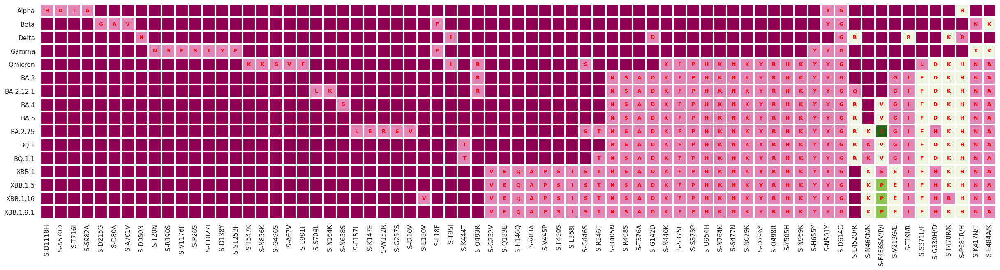

In [203]:
#S only
import matplotlib.colors as colors

single_site, competi_site, mutation_site = mutation_x(nonuic, True)
heatmap_mutation_order = [*mutation_xs_order_order(mutation_xs_order(single_site, nonuic), False), *mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False)]
heatmap_x_tick = heatmap_x_ticker(heatmap_mutation_order, mutation_site)
heatmap_matrix = heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site)

fig=plt.figure(figsize=(30, 12))
norm = colors.Normalize(vmin=np.min(heatmap_matrix), vmax=np.max(heatmap_matrix))
fmt = "{x:.2f}"
im, _ = heatmap(heatmap_matrix, vocorder, heatmap_x_tick,  cmap=mpl.colormaps["PiYG"].resampled(10), norm=norm)
annotate_my_heatmap(heatmap_x_tick, im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))
plt.savefig('S-only-newheatmapa.png', dpi = 600)
plt.savefig('S-only-newheatmapa.pdf', dpi = 600)
plt.savefig('S-only-newheatmapa.svg', dpi = 600)
plt.show()
plt.close()

In [204]:
print(heatmap_matrix[0])

[1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 2 0 0]


In [1]:
vocorder

NameError: name 'vocorder' is not defined

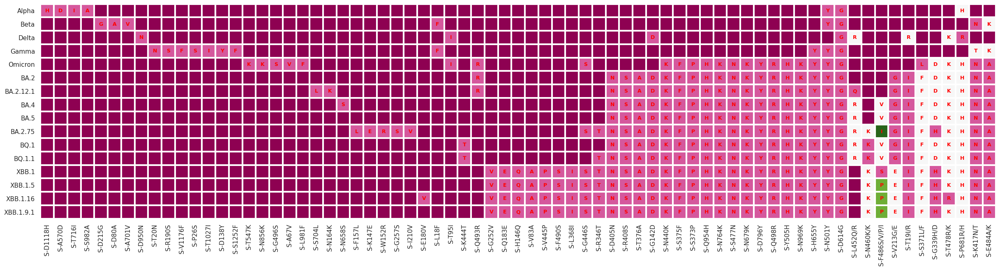

In [190]:
#S only

single_site, competi_site, mutation_site = mutation_x(nonuic, True)
heatmap_mutation_order = [*mutation_xs_order_order(mutation_xs_order(single_site, nonuic), False), *mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False)]
heatmap_x_tick = heatmap_x_ticker(heatmap_mutation_order, mutation_site)
heatmap_matrix = heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site)

fig=plt.figure(figsize=(30, 12))
im, _ = heatmap(heatmap_matrix, vocorder, heatmap_x_tick,  cmap=mpl.colormaps["PiYG"].resampled(7), norm=norm)
annotate_my_heatmap(heatmap_x_tick, im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))
plt.savefig('S-only-newheatmapa.png', dpi = 600)
plt.savefig('S-only-newheatmapa.pdf', dpi = 600)
plt.savefig('S-only-newheatmapa.svg', dpi = 600)
plt.show()
plt.close()

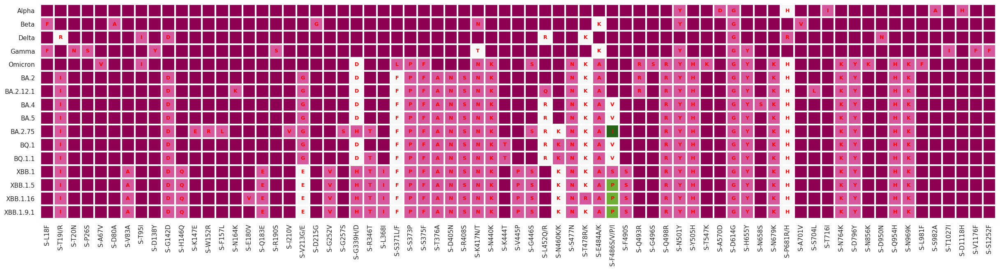

In [191]:
#S only and the real mutation order

single_site, competi_site, mutation_site = mutation_x(nonuic, True)
heatmap_mutation_order = mutation_order_by_site([*mutation_xs_order_order(mutation_xs_order(single_site, nonuic), False), *mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False)])
heatmap_x_tick = heatmap_x_ticker(heatmap_mutation_order, mutation_site)
heatmap_matrix = heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site)

fig=plt.figure(figsize=(30, 12))
im, _ = heatmap(heatmap_matrix, vocorder, heatmap_x_tick,  cmap=mpl.colormaps["PiYG"].resampled(7), norm=norm)
annotate_my_heatmap(heatmap_x_tick, im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))
plt.savefig('S-only-newheatmap-real-order.png', dpi = 600)
plt.savefig('S-only-newheatmap-real-order.pdf', dpi = 600)
plt.savefig('S-only-newheatmap-real-order.svg', dpi = 600)
plt.show()
plt.close()

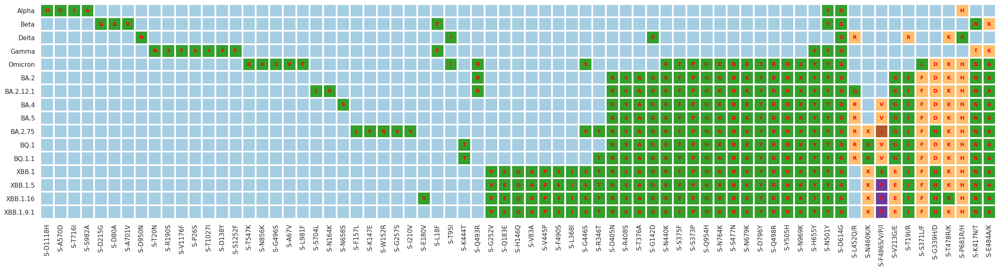

In [213]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

#test color




#S only

single_site, competi_site, mutation_site = mutation_x(nonuic, True)
heatmap_mutation_order = [*mutation_xs_order_order(mutation_xs_order(single_site, nonuic), False), *mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False)]
heatmap_x_tick = heatmap_x_ticker(heatmap_mutation_order, mutation_site)
heatmap_matrix = heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site)


unique_values = np.unique(heatmap_matrix)
colors = plt.get_cmap('Paired', len(unique_values))
cmap = ListedColormap(colors.colors)

fig=plt.figure(figsize=(30, 12))
im, _ = heatmap(heatmap_matrix, vocorder, heatmap_x_tick,  cmap=cmap, norm=norm)
annotate_my_heatmap(heatmap_x_tick, im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))
plt.savefig('S-only-newheatmapac.png', dpi = 600)
plt.savefig('S-only-newheatmapac.pdf', dpi = 600)
plt.savefig('S-only-newheatmapac.svg', dpi = 600)
plt.show()
plt.close()


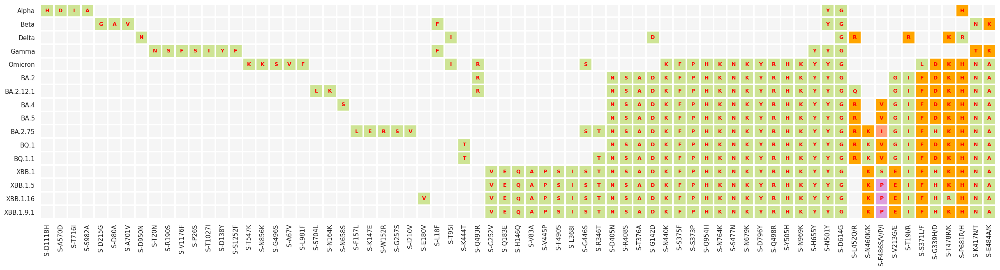

In [224]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

#test color
#S only

single_site, competi_site, mutation_site = mutation_x(nonuic, True)
heatmap_mutation_order = [*mutation_xs_order_order(mutation_xs_order(single_site, nonuic), False), *mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False)]
heatmap_x_tick = heatmap_x_ticker(heatmap_mutation_order, mutation_site)
heatmap_matrix = heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site)


unique_values = np.unique(heatmap_matrix)
colors = ['whitesmoke',
          '#CEE495',
          'orange',
          'plum',
          'lightsalmon']

cmap = ListedColormap(colors)

fig=plt.figure(figsize=(30, 12))
im, _ = heatmap(heatmap_matrix, vocorder, heatmap_x_tick,  cmap=cmap, norm=norm)
annotate_my_heatmap(heatmap_x_tick, im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))
plt.savefig('S-only-newheatmapac.png', dpi = 600)
plt.savefig('S-only-newheatmapac.pdf', dpi = 600)
plt.savefig('S-only-newheatmapac.svg', dpi = 600)
plt.show()
plt.close()


In [225]:
#test text color
def annotate_my_heatmap(heatmap_x_tick, im, data=None, valfmt="{x:.2f}",
                     textcolors=("black", "white"),
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.

    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """

    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()

    # Normalize the threshold to the images color range.
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.

    # Set default alignment to center, but allow it to be
    # overwritten by textkw.
    kw = dict(horizontalalignment="center",
              verticalalignment="center")
    kw.update(textkw)

    # Get the formatter in case a string is supplied
    if isinstance(valfmt, str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)

    # Loop over the data and create a `Text` for each "pixel".
    # Change the text's color depending on the data.
    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            # 使用数据值来选择颜色
            kw.update(color=textcolors[int(data[i, j] > 1)])
            if data[i][j] == 0:
                text = im.axes.text(j, i, '', **kw)
            else:
                text = im.axes.text(j, i, heatmap_x_tick[j].split('/')[data[i][j]-1][-1], **kw)
            texts.append(text)

   # return texts

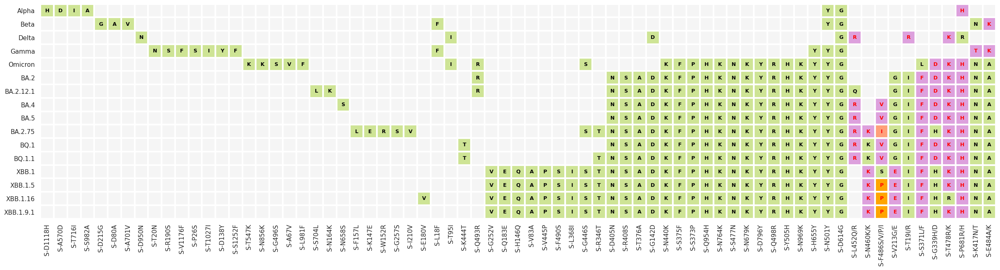

In [230]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

#test color
#S only

single_site, competi_site, mutation_site = mutation_x(nonuic, True)
heatmap_mutation_order = [*mutation_xs_order_order(mutation_xs_order(single_site, nonuic), False), *mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False)]
heatmap_x_tick = heatmap_x_ticker(heatmap_mutation_order, mutation_site)
heatmap_matrix = heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site)


unique_values = np.unique(heatmap_matrix)
colors = ['whitesmoke',
          '#CEE495',
          'plum',
          'orange',
          'lightsalmon']

cmap = ListedColormap(colors)

fig=plt.figure(figsize=(30, 12))
im, _ = heatmap(heatmap_matrix, vocorder, heatmap_x_tick,  cmap=cmap, norm=norm)
annotate_my_heatmap(heatmap_x_tick, im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))
plt.savefig('S-only-newheatmapac.png', dpi = 600)
plt.savefig('S-only-newheatmapac.pdf', dpi = 600)
plt.savefig('S-only-newheatmapac.svg', dpi = 600)
plt.show()
plt.close()


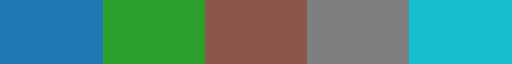

In [207]:
colors

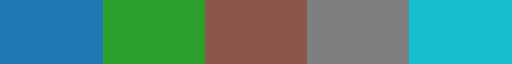

In [208]:
cmap

In [192]:
single_site, competi_site, mutation_site = mutation_x(nonuic, True)

In [193]:


temp_temp = mutation_order_by_site(heatmap_mutation_order)

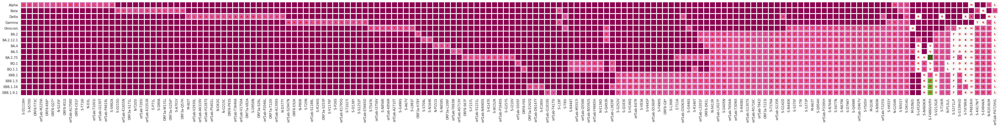

In [194]:
#not S only

single_site, competi_site, mutation_site = mutation_x(nonuic, False)
heatmap_mutation_order = [*mutation_xs_order_order(mutation_xs_order(single_site, nonuic), False), *mutation_xs_order_order(mutation_xs_order(competi_site, nonuic), False)]
heatmap_x_tick = heatmap_x_ticker(heatmap_mutation_order, mutation_site)
heatmap_matrix = heatmap_array(vocorder, nonuic, heatmap_mutation_order, mutation_site)

fig=plt.figure(figsize=(60, 12))
im, _ = heatmap(heatmap_matrix, vocorder, heatmap_x_tick,  cmap=mpl.colormaps["PiYG"].resampled(7), norm=norm)
annotate_my_heatmap(heatmap_x_tick, im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))
plt.savefig('non-S-only-newheatmapa.png', dpi = 600)
plt.savefig('non-S-only-newheatmapa.pdf', dpi = 600)
plt.savefig('non-S-only-newheatmapa.svg', dpi = 600)
plt.show()
plt.close()

In [341]:
genome, data = genebank(genebank_file_path)

In [ ]:
annotate_heatmap(im, valfmt=fmt, size=9, fontweight="bold", threshold=1.5, textcolors=("black","red"))

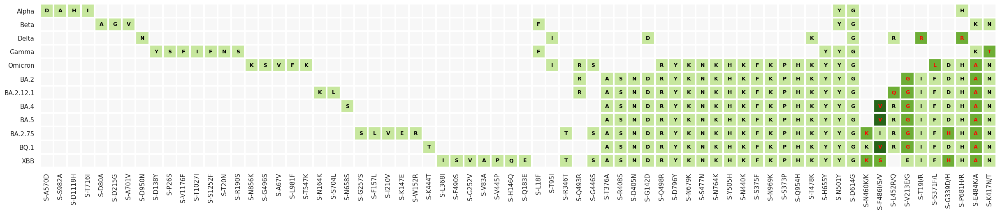

In [ ]:
annotate_heatmap(im, valfmt=fmt, size=9, fontweight="bold", threshold=0.5,textcolors=("black","red"))

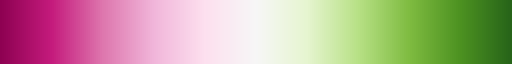

In [283]:
mpl.colormaps["PiYG"]

In [299]:
len(mpl.colormaps)

178

In [195]:
print(Alias)
print(vocdict)
print(vocorder)
print(vocplate)
print('Unic')
print(unic)
print('Nonunic')
print(nonuic)
#unic = unicfinder(vocorder, vocdict, new_id_mut_)

{'Alpha': ['B.1.1.7'], 'Beta': ['B.1.351'], 'Gamma': ['P.1', 'B.1.1.28.1'], 'Delta': ['B.1.617.2', 'AY'], 'Omicron': ['B.1.1.529', 'BA.1'], 'BA.2': ['BA.2', 'B.1.1.529.2'], 'BA.4': ['BA.4', 'B.1.1.529.4'], 'BA.2.12.1': ['BA.2.12.1', 'B.1.1.529.2.12.1'], 'BA.5': ['BA.5', 'B.1.1.529.5'], 'BA.2.75': ['BA.2.75', 'B.1.1.529.2.75'], 'BQ.1': ['B.1.1.529.5.3.1.1.1.1.1'], 'BQ.1.1': ['B.1.1.529.5.3.1.1.1.1.1.1'], 'XBB.1': ['XBB.1'], 'XBB.1.5': ['XBB.1.5'], 'XBB.1.16': ['XBB.1.16'], 'XBB.1.9.1': ['XBB.1.9.1']}
{'Alpha': 'EPI_ISL_7976096', 'Beta': 'EPI_ISL_5315876', 'Delta': 'EPI_ISL_2723566', 'Gamma': 'EPI_ISL_1519355', 'Omicron': 'EPI_ISL_7860184', 'BA.2': 'EPI_ISL_8002589', 'BA.2.12.1': 'EPI_ISL_11999085', 'BA.4': 'EPI_ISL_12293081', 'BA.5': 'EPI_ISL_12839026', 'BA.2.75': 'EPI_ISL_15362552', 'BQ.1': 'EPI_ISL_15330928', 'BQ.1.1': 'EPI_ISL_15009072', 'XBB.1': 'EPI_ISL_14917652', 'XBB.1.5': 'EPI_ISL_15687648', 'XBB.1.16': 'EPI_ISL_17262430', 'XBB.1.9.1': 'EPI_ISL_16093023'}
['Alpha', 'Beta', 'Delt

In [ ]:
print(unic)

In [188]:
tmpchekck = pd.read_csv('tmp/United States of America (the).slope_df.csv')

In [191]:
tmpchekck2 = pd.read_csv('mut-date-dataframe/United States of America (the).mut_df.csv')

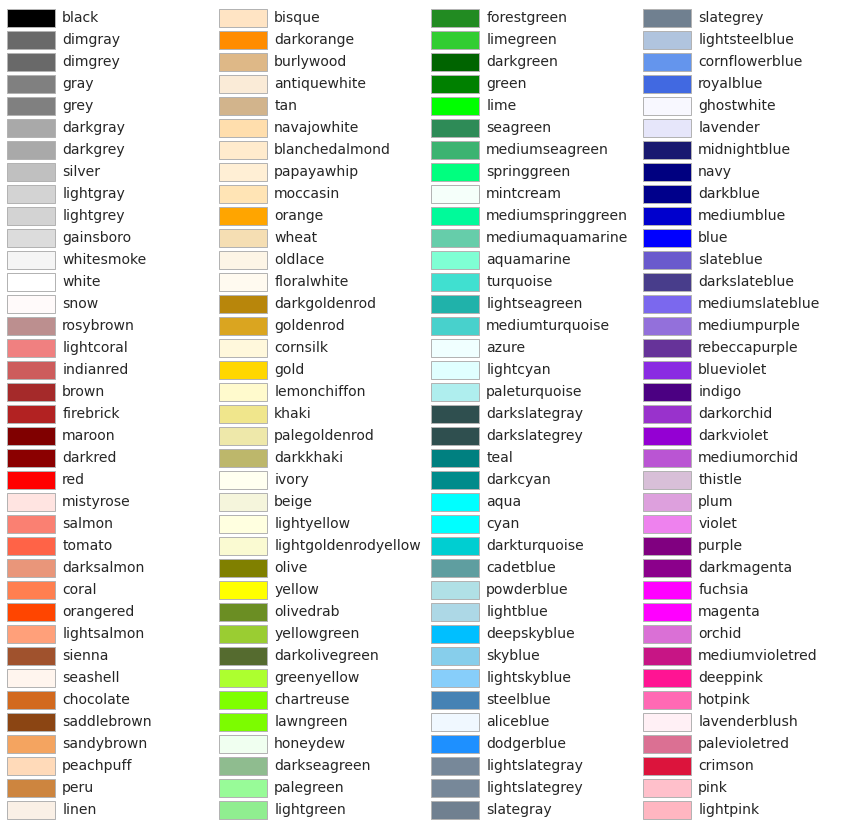

In [218]:
import math

from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors


def plot_colortable(colors, *, ncols=4, sort_colors=True):

    cell_width = 212
    cell_height = 22
    swatch_width = 48
    margin = 12

    # Sort colors by hue, saturation, value and name.
    if sort_colors is True:
        names = sorted(
            colors, key=lambda c: tuple(mcolors.rgb_to_hsv(mcolors.to_rgb(c))))
    else:
        names = list(colors)

    n = len(names)
    nrows = math.ceil(n / ncols)

    width = cell_width * 4 + 2 * margin
    height = cell_height * nrows + 2 * margin
    dpi = 72

    fig, ax = plt.subplots(figsize=(width / dpi, height / dpi), dpi=dpi)
    fig.subplots_adjust(margin/width, margin/height,
                        (width-margin)/width, (height-margin)/height)
    ax.set_xlim(0, cell_width * 4)
    ax.set_ylim(cell_height * (nrows-0.5), -cell_height/2.)
    ax.yaxis.set_visible(False)
    ax.xaxis.set_visible(False)
    ax.set_axis_off()

    for i, name in enumerate(names):
        row = i % nrows
        col = i // nrows
        y = row * cell_height

        swatch_start_x = cell_width * col
        text_pos_x = cell_width * col + swatch_width + 7

        ax.text(text_pos_x, y, name, fontsize=14,
                horizontalalignment='left',
                verticalalignment='center')

        ax.add_patch(
            Rectangle(xy=(swatch_start_x, y-9), width=swatch_width,
                      height=18, facecolor=colors[name], edgecolor='0.7')
        )

    return fig
plot_colortable(mcolors.CSS4_COLORS)
plt.savefig('matplotlib color list.pdf', dpi = 600)
plt.show()

In [ ]:
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################
######################################################################################################################################################